In [1]:
##### Importy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from keras.src.layers import BatchNormalization, Dropout
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
import warnings
import keras_tuner as kt
import itertools
import time
from statsmodels.tsa.stattools import adfuller, kpss, acf, pacf

df_final = pd.read_csv("test20set.csv", parse_dates=['timestamp'])
warnings.filterwarnings('ignore')


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4277557094.py:20: DtypeWarning: Columns (8) have mixed types. Specify dtype option on import or set low_memory=False.
  df_final = pd.read_csv("test20set.csv", parse_dates=['timestamp'])


##### LSTM

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from keras.src.layers import BatchNormalization, Dropout
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
import warnings
import keras_tuner as kt
import itertools
import time
import pmdarima as pm
from statsmodels.tsa.stattools import adfuller, kpss, acf, pacf

warnings.filterwarnings('ignore')

In [3]:
#df_final = pd.read_csv("all_data.csv", parse_dates=['timestamp'])

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from tensorflow.keras.optimizers import Adam
import keras_tuner as kt
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Parametry
n_steps = 24  # 24 godziny historii
n_features = 3  # energy_consumption + airTemperature + sqm

# Funkcja przygotowująca dane treningowe
def prepare_train_data(data, target_col, n_steps):
    scaler = MinMaxScaler()
    scaled = scaler.fit_transform(data)

    X, y = [], []
    for i in range(n_steps, len(scaled)):
        X.append(scaled[i-n_steps:i, :])
        y.append(scaled[i, data.columns.get_loc(target_col)])

    return np.array(X), np.array(y), scaler

# Funkcja przygotowująca dane testowe z historią z treningu
def prepare_test_data(train_data, test_data, scaler, n_steps):
    # Połącz ostatnie n_steps z treningu z testem
    combined = pd.concat([train_data.iloc[-n_steps:], test_data])
    scaled = scaler.transform(combined)

    X_test = []
    for i in range(n_steps, len(scaled)):
        X_test.append(scaled[i-n_steps:i, :])

    return np.array(X_test)

# Budowa modelu
def build_model(hp):
    model = Sequential()
    model.add(LSTM(
        units=hp.Int('units', 32, 256, step=32),
        input_shape=(n_steps, n_features),
        return_sequences=False
    ))
    model.add(Dense(1))
    model.compile(
        optimizer=Adam(hp.Choice('lr', [1e-2, 1e-3, 1e-4])),
        loss='mse'
    )
    return model

# Główny proces
def train_and_predict(train_data, test_data, target_col):
    # 1. Przygotowanie danych treningowych
    X_train, y_train, scaler = prepare_train_data(train_data, target_col, n_steps)

    # 2. Strojenie i trening modelu
    tuner = kt.RandomSearch(
        build_model,
        objective='val_loss',
        max_trials=10,
        directory='tuning',
        project_name='energy_forecast'
    )

    tuner.search(X_train, y_train, epochs=20, validation_split=0.2)
    best_model = tuner.get_best_models()[0]

    # 3. Przygotowanie danych testowych z historią
    X_test = prepare_test_data(train_data, test_data, scaler, n_steps)

    # 4. Predykcja dla 168 godzin
    predictions = best_model.predict(X_test)

    # 5. Odwrócenie skalowania
    dummy = np.zeros((len(predictions), n_features))
    dummy[:, 0] = predictions.flatten()
    preds = scaler.inverse_transform(dummy)[:, 0]

    return preds, test_data[target_col].values

In [5]:
# Ewaluacja
def evaluate_model(y_true, y_pred, model_name, training_time=None):
    metrics = {
        'RMSE': np.sqrt(mean_squared_error(y_true, y_pred)),
        'MAE': mean_absolute_error(y_true, y_pred),
        'MAPE': mean_absolute_percentage_error(y_true, y_pred),
        'Czas treningu': training_time
    }
    return pd.DataFrame([metrics], index=[model_name])



##### ARIMAS


In [6]:
def evaluate_model(y_true, y_pred, model_name, trening_time=None, model_time=None):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    return {'Model': model_name, 'RMSE': rmse, 'MAE': mae, 'MAPE': mape, 'Czas treningu': trening_time, 'Czas predykcji': model_time}


In [7]:
def find_arima_params(train):

    d = determine_differencing_order(train)
    stationary_series = train.diff(d).dropna() if d > 0 else train.copy()

    max_lags = 20
    acf_vals = acf(stationary_series, nlags=max_lags, fft=True)
    pacf_vals = pacf(stationary_series, nlags=max_lags)

    p_range = suggest_p_from_pacf(pacf_vals)
    q_range = suggest_q_from_acf(acf_vals)

    best_aic = np.inf
    best_order = (1, d, 1)

    # Generuj wszystkie kombinacje p i q
    pdq = itertools.product(p_range, [d], q_range)

    for order in pdq:
        try:
            model = ARIMA(train, order=order).fit()
            if model.aic < best_aic:
                best_aic = model.aic
                best_order = order
        except:
            continue

    validated_order = validate_arima_order(train, best_order)

    warnings.resetwarnings()
    return validated_order


def determine_differencing_order(series, max_diff=2):
    """
    Określa rząd różnicowania (d) na podstawie testów stacjonarności
    """
    for d in range(max_diff + 1):
        if d > 0:
            diff_series = series.diff(d).dropna()
        else:
            diff_series = series.copy()

        # Test ADF
        adf_result = adfuller(diff_series)
        # Test KPSS
        try:
            kpss_result = kpss(diff_series, regression='c')
        except:
            kpss_result = (None, 1.0)

        if adf_result[1] <= 0.05 and kpss_result[1] > 0.05:
            return d

    return max_diff  # Zwróć maksymalny testowany rząd


def suggest_p_from_pacf(pacf_vals, threshold=0.2):
    """
    Sugeruje zakres p na podstawie PACF
    """
    significant_lags = np.where(np.abs(pacf_vals) > threshold)[0]
    if len(significant_lags) > 0:
        max_p = min(np.max(significant_lags) + 2, 5)  # Ogranicz do 5
        return range(0, max_p + 1)
    return [0, 1, 2]


def suggest_q_from_acf(acf_vals, threshold=0.2):
    """
    Sugeruje zakres q na podstawie ACF
    """
    significant_lags = np.where(np.abs(acf_vals) > threshold)[0]
    if len(significant_lags) > 0:
        max_q = min(np.max(significant_lags) + 2, 5)  # Ogranicz do 5
        return range(0, max_q + 1)
    return [0, 1, 2]


def validate_arima_order(series, order, n_folds=3):
    """
    Walidacja parametrów z użyciem kroczącej walidacji
    """
    p, d, q = order
    train_size = len(series)
    fold_size = train_size // (n_folds + 1)

    aic_scores = []

    for i in range(1, n_folds + 1):
        train = series.iloc[:i * fold_size]
        try:
            model = ARIMA(train, order=order).fit()
            aic_scores.append(model.aic)
        except:
            aic_scores.append(np.inf)

    # Sprawdź czy prostsze modele nie dają podobnych wyników
    simpler_models = [
        (max(p - 1, 0), d, q),
        (p, d, max(q - 1, 0)),
        (max(p - 1, 0), d, max(q - 1, 0))
    ]

    for test_order in simpler_models:
        try:
            model = ARIMA(series, order=test_order).fit()
            if model.aic < np.mean(aic_scores):
                return test_order
        except:
            continue

    return order

In [8]:
def find_optimal_seasonal_params(train, s=24, non_seasonal_order=(1, 1, 1)):

    D = determine_seasonal_differencing_order(train, s)
    P_range = [0, 1, 2]
    Q_range = [0, 1, 2]

    best_aic = np.inf
    best_order = (1, D, 1, s)

    for P, Q in itertools.product(P_range, Q_range):
        seasonal_order = (P, D, Q, s)
        try:
            model = SARIMAX(train,
                            order=non_seasonal_order,
                            seasonal_order=seasonal_order).fit(disp=False)

            if model.aic < best_aic:
                best_aic = model.aic
                best_order = seasonal_order
        except:
            continue

    warnings.resetwarnings()
    return best_order


def determine_seasonal_differencing_order(series, s, max_D=1):
    """
    Określa sezonowy rząd różnicowania (D) na podstawie:
    - Testu Canova-Hansona dla sezonowości
    - Wizualnej inspecji sezonowych ACF
    """
    # Test Canova-Hansona (dostępny w statsmodels 0.14+)
    try:
        from statsmodels.tsa.statespace.tools import seasonal_decompose
        decomposition = seasonal_decompose(series, period=s)
        resid = decomposition.resid.dropna()
        if abs(resid).mean() < 0.1 * abs(series).mean():
            return 0
    except:
        pass

    # Różnicowanie sezonowe i test ACF
    for D in range(max_D + 1):
        if D > 0:
            diff_series = series.diff(s).dropna()
        else:
            diff_series = series.copy()

        # Sprawdź czy sezonowość została usunięta
        acf_vals = acf(diff_series, nlags=s + 3, fft=True)
        if all(abs(acf_vals[s - 1:s + 2]) < 0.2):  # Sprawdź opóźnienie sezonowe
            return D

    return max_D


##### TEST

In [11]:
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore", category=FutureWarning)
sorted_buildings = sorted(df_final['building_id'].unique())
selected_buildings = sorted_buildings[:20]  # Selecting one building

all_results = []
all_metrics = []

for building_id in selected_buildings:
    print(f"\n\n====== Processing Building {building_id} ======")

    # 1. Data Preparation
    data = df_final[df_final['building_id'] == building_id].copy()
    data['timestamp'] = pd.to_datetime(data['timestamp'])
    data = data.set_index('timestamp').sort_index()

    # Set hourly frequency and handle missing values
    data = data.asfreq('H')
    print(f"\nMissing values before interpolation: {data['energy_consumption'].isna().sum()}")

    data['energy_consumption'] = data['energy_consumption'].interpolate()

    print(data['energy_consumption'])

    # 2. Stationarity Analysis
    print("\nStationarity Analysis:")
    adf_result = adfuller(data['energy_consumption'].dropna())
    print(f"ADF Statistic: {adf_result[0]}")
    print(f"p-value: {adf_result[1]}")
    print("Critical Values:")
    for key, value in adf_result[4].items():
        print(f"\t{key}: {value}")

    # Determine differencing needed
    if adf_result[1] > 0.05:
        print("Series is non-stationary - applying differencing")
        data['energy_diff'] = data['energy_consumption'].diff().dropna()

        # Check differenced series
        adf_diff = adfuller(data['energy_diff'].dropna())
        print(f"Differenced series p-value: {adf_diff[1]}")
    else:
        print("Series appears stationary")
        data['energy_diff'] = data['energy_consumption']

    # 3. Train-Test Split (maintaining temporal order)

    data = data.dropna(subset=['energy_diff', 'airTemperature'])
    train = data['energy_diff'][-720:-168]
    test = data['energy_diff'][-168:]

    X = data[['airTemperature']]
    exogTrain = X[-720:-168]
    exogTest = X[-168:]

    print(f"\nData split - Train: {len(train)}, Test: {len(test)}")
    print(f"Train period: {train.index.min()} to {train.index.max()}")
    print(f"Test period: {test.index.min()} to {test.index.max()}")

    try:
        arimaTimes = dict()
        start = time.time()
        arima_order = find_arima_params(train)
        end = time.time()
        arimaTimes["arimaSearch"] = end - start

        start = time.time()
        seasonal_order = find_optimal_seasonal_params(train, s=24)
        end = time.time()
        arimaTimes["arimaSeasonalSearch"] = end - start

        try:
            # ARIMA
            start = time.time()
            am = ARIMA(train, order=arima_order,
                        enforce_stationarity=False,
                        enforce_invertibility=False)
            arima_model = am.fit()
            forecast_arima = arima_model.get_forecast(steps=len(test))
            forecast_arima_values = forecast_arima.predicted_mean
            end = time.time()
            arimaTimes["ARIMA"] = end - start

        except Exception as e:
            print("Błąd ARIMA:", e)
            forecast_arima_values = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["ARIMA"] = 0

        try:
            # SARIMA
            start = time.time()
            sm = SARIMAX(train, order=arima_order, seasonal_order=seasonal_order, enforce_stationarity=False, enforce_invertibility=False)
            sarima_model = sm.fit(disp=False)
            forecast_sarima = sarima_model.get_forecast(steps=len(test))
            forecast_sarima_values = forecast_sarima.predicted_mean
            end = time.time()
            arimaTimes["SARIMA"] = end - start

        except Exception as e:
            print("Błąd SARIMA:", e)
            forecast_sarima_values = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["SARIMA"] = 0

        try:
            # ARIMAX
            start = time.time()
            axm = ARIMA(train, exog=exogTrain, order=arima_order, enforce_stationarity=False, enforce_invertibility=False)
            arimax_model = axm.fit()
            forecast_arimax = arimax_model.get_forecast(steps=len(test), exog=exogTest)
            forecast_arimax_values = forecast_arimax.predicted_mean
            end = time.time()
            arimaTimes["ARIMAX"] = end - start

        except Exception as e:
            print("Błąd ARIMAX:", e)
            forecast_arimax_values = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["ARIMAX"] = 0

        try:
            # SARIMAX
            start = time.time()
            sxm = SARIMAX(train, exog=exogTrain, order=arima_order,
                                    seasonal_order=seasonal_order, enforce_stationarity=False, enforce_invertibility=False)
            sarimax_model = sxm.fit()
            forecast_sarimax = sarimax_model.get_forecast(steps=len(test), exog=exogTest)
            forecast_sarimax_values = forecast_sarimax.predicted_mean
            end = time.time()
            arimaTimes["SARIMAX"] = end - start

        except Exception as e:
            print("Błąd SARIMAX:", e)
            forecast_sarimax_values = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["SARIMAX"] = 0


        try:
            # autoARIMA
            start = time.time()
            auto_arima_model = pm.auto_arima(
                train,
                seasonal=False,
                start_p=0,  # Minimalna wartość p
                start_q=0,  # Minimalna wartość q
                max_p=5,    # Maksymalna wartość p
                max_q=5,    # Maksymalna wartość q
                max_d=3,    # Maksymalna wartość d
                stepwise=False,  # Pełne przeszukiwanie zamiast krokowego
                trace=True,
                error_action='ignore',
                suppress_warnings=True,
            )

            #auto_arimax_model.predict(n_periods=len(test), exogenous=exogTest)
            forecast_auto_arima = auto_arima_model.predict(n_periods=len(test))
            end = time.time()
            arimaTimes["AutoARIMA"] = end - start

            print("AutoARIMA forecast NaNs:", forecast_auto_arima.isna().sum())

        except Exception as e:
            print("Błąd AutoARIMA:", e)
            forecast_auto_arima = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["AutoARIMA"] = 0

        try:
            # autoSARIMA
            start = time.time()
            auto_sarima_model = pm.auto_arima(
                train,
                seasonal=True,
                m=24,
                start_p=0,
                start_q=0,
                max_p=5,
                max_q=5,
                max_d=3,
                start_P=0,  # Minimalna sezonowa wartość P
                start_Q=0,  # Minimalna sezonowa wartość Q
                max_P=2,    # Maksymalna sezonowa wartość P
                max_Q=2,    # Maksymalna sezonowa wartość Q
                max_D=1,    # Maksymalna sezonowa wartość D
                stepwise=False,
                trace=True,
                error_action='ignore',
                suppress_warnings=True,
            )

            #auto_arimax_model.predict(n_periods=len(test), exogenous=exogTest)
            forecast_auto_sarima = auto_sarima_model.predict(n_periods=len(test))
            end = time.time()
            arimaTimes["AutoSARIMA"] = end - start

            print("AutoSARIMA forecast NaNs:", forecast_auto_sarima.isna().sum())

        except Exception as e:
            print("Błąd AutoARIMAX:", e)
            forecast_auto_sarima = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["AutoARIMAX"] = 0

        try:
            # autoARIMAX
            start = time.time()
            auto_sarima_model = pm.auto_arima(
                train,
                exogenous=exogTrain,
                seasonal=False,
                start_p=0,  # Minimalna wartość p
                start_q=0,  # Minimalna wartość q
                max_p=5,    # Maksymalna wartość p
                max_q=5,    # Maksymalna wartość q
                max_d=3,    # Maksymalna wartość d
                stepwise=False,  # Pełne przeszukiwanie zamiast krokowego
                trace=True,
                error_action='ignore',
                suppress_warnings=True,
            )

            #auto_arimax_model.predict(n_periods=len(test), exogenous=exogTest)
            forecast_auto_arimax = auto_sarima_model.predict(n_periods=len(test), exogenous=exogTest)
            end = time.time()
            arimaTimes["AutoARIMAX"] = end - start

            print("AutoARIMAX forecast NaNs:", forecast_auto_arimax.isna().sum())

        except Exception as e:
            print("Błąd AutoARIMAX:", e)
            forecast_auto_arimax = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["AutoARIMAX"] = 0

        try:
            # autoSARIMAX
            start = time.time()
            auto_sarimax_model = pm.auto_arima(
                train,
                exogenous=exogTrain,
                seasonal=True,
                m=24,
                start_p=0,
                start_q=0,
                max_p=5,
                max_q=5,
                max_d=3,
                start_P=0,  # Minimalna sezonowa wartość P
                start_Q=0,  # Minimalna sezonowa wartość Q
                max_P=2,    # Maksymalna sezonowa wartość P
                max_Q=2,    # Maksymalna sezonowa wartość Q
                max_D=1,    # Maksymalna sezonowa wartość D
                stepwise=False,
                trace=True,
                error_action='ignore',
                suppress_warnings=True,
            )

            #auto_arimax_model.predict(n_periods=len(test), exogenous=exogTest)
            forecast_auto_sarimax = auto_sarimax_model.predict(n_periods=len(test), exogenous=exogTest)
            end = time.time()
            arimaTimes["AutoSARIMAX"] = end - start

            print("AutoSARIMAX forecast NaNs:", forecast_auto_sarimax.isna().sum())

        except Exception as e:
            print("Błąd AutoSARIMAX:", e)
            forecast_auto_sarimax = pd.Series([np.nan] * len(test), index=test.index)
            arimaTimes["AutoSARIMAX"] = 0

        results = pd.DataFrame(index=test.index)
        metrics = []

        results['ARIMA'] = list(forecast_arima_values)
        results['AutoARIMA'] = list(forecast_auto_arima)
        results['ARIMAX'] = list(forecast_arimax_values)
        results['AutoARIMAX'] = list(forecast_auto_arimax)
        results['SARIMA'] = list(forecast_sarima_values)
        results['AutoSARIMA'] = list(forecast_auto_sarima)
        results['SARIMAX'] = list(forecast_sarimax_values)
        results['AutoSARIMAX'] = list(forecast_auto_sarimax)

        # Zakładam że masz evaluate_model (jeśli nie, po prostu usuń linie z metrics.append)
        try:
            metrics.append(evaluate_model(test, results['ARIMA'], 'ARIMA', model_time=arimaTimes['ARIMA'], trening_time=arimaTimes['arimaSearch']))
        except Exception as e:
            print("Błąd w evaluate_model ARIMA:", e)

        try:
            metrics.append(evaluate_model(test, results['SARIMA'], 'SARIMA', model_time=arimaTimes['SARIMA'], trening_time=arimaTimes['arimaSeasonalSearch']))
        except Exception as e:
            print("Błąd w evaluate_model SARIMA:", e)

        try:
            metrics.append(evaluate_model(test, results['ARIMAX'], 'ARIMAX', model_time=arimaTimes['ARIMAX'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model ARIMAX:", e)

        try:
            metrics.append(evaluate_model(test, results['SARIMAX'], 'SARIMAX', model_time=arimaTimes['SARIMAX'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model SARIMAX:", e)

        try:
            metrics.append(evaluate_model(test, results['AutoARIMA'], 'AutoARIMA', model_time=arimaTimes['AutoARIMA'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model AutoARIMA:", e)

        try:
            metrics.append(evaluate_model(test, results['AutoSARIMA'], 'AutoSARIMA', model_time=arimaTimes['AutoSARIMA'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model AutoSARIMA:", e)

        try:
            metrics.append(evaluate_model(test, results['AutoARIMAX'], 'AutoARIMAX', model_time=arimaTimes['AutoARIMAX'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model AutoARIMAX:", e)

        try:
            metrics.append(evaluate_model(test, results['AutoSARIMAX'], 'AutoSARIMAX', model_time=arimaTimes['AutoSARIMAX'], trening_time=0))
        except Exception as e:
            print("Błąd w evaluate_model AutoSARIMAX:", e)

        print(results.head())

        all_results.append(results)
        all_metrics.append(metrics)

    except Exception as e:
        print(f"\nModel fitting failed: {str(e)}")



====== Processing Building Bear_assembly_Jose ======

Missing values before interpolation: 39
timestamp
2016-01-01 00:00:00    148.50
2016-01-01 01:00:00    152.00
2016-01-01 02:00:00    153.25
2016-01-01 03:00:00    145.50
2016-01-01 04:00:00    158.25
                        ...  
2017-12-31 19:00:00    226.50
2017-12-31 20:00:00    223.00
2017-12-31 21:00:00    163.50
2017-12-31 22:00:00    134.25
2017-12-31 23:00:00    136.25
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -9.590546457752216
p-value: 2.0416257007135208e-16
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-01 23:00:00 to 2017-12-24 22:00:00
Test period: 2017-12-24 23:00:00 to 2017-12-31 23:00:00


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_mag

 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4945.498, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4840.954, Time=0.13 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=4836.916, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=4830.621, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=4820.589, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=4818.630, Time=0.30 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4827.388, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4828.628, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4825.107, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=4819.443, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=4815.331, Time=0.41 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4829.152, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4830.268, Time=0.28 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=4824.339, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.91 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=4817.392, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=4819.375, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=4819.357, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=4820.476, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=4816.979, Time=0.35 sec

Best model:  ARIMA(1,1,4)(0,0,0)[0] intercept
Total fit time: 6.245 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=4945.498, Time=0.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=4762.583, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=4655.529, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=4581.473, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=1.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=7.13 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=4840.954, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=4741.704, Time=1.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=4647.523, Time=3.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=4562.415, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=6.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=4481.015, Time=2.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=4.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=11.25 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=4836.916, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=4741.181, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=4649.518, Time=3.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=4558.326, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=8.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=4469.711, Time=6.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=8.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=4830.621, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=4733.809, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=4644.769, Time=3.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=4560.028, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=2.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=4471.411, Time=5.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=4820.589, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=4729.652, Time=1.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=4561.826, Time=1.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=4818.630, Time=0.43 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=4827.388, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=4737.100, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=4647.484, Time=4.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=4569.507, Time=0.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=5.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=3.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=12.93 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=4828.628, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=4731.490, Time=1.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=4647.068, Time=5.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=3.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=11.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=8.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=10.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=4825.107, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=4733.471, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=4648.752, Time=6.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=inf, Time=11.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=4819.443, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=4727.804, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=inf, Time=3.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=4815.331, Time=0.66 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=4829.152, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=4736.141, Time=1.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=4649.442, Time=5.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=6.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=13.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=4830.268, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=4733.479, Time=1.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=4647.349, Time=12.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=4560.039, Time=1.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=4471.221, Time=5.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=4824.339, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=4734.239, Time=2.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=1.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=4817.392, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=4728.290, Time=1.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=4641.690, Time=5.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=3.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=7.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=4819.375, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=4729.748, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=4.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=1.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=4819.357, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=4729.218, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=inf, Time=2.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=4820.476, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=4816.979, Time=0.49 sec

Best model:  ARIMA(0,1,2)(2,0,0)[24] intercept
Total fit time: 326.792 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=4945.498, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=4840.954, Time=0.31 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=4836.916, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=4830.621, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=4820.589, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=4818.630, Time=0.44 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=4827.388, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=4828.628, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=4825.107, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=4819.443, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=4815.331, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=4829.152, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=4830.268, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=4824.339, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=1.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=4817.392, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=4819.375, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=1.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=4819.357, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=4820.476, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=4816.979, Time=0.47 sec

Best model:  ARIMA(1,1,4)(0,0,0)[0] intercept
Total fit time: 9.938 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=4945.498, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=4762.583, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=4655.529, Time=2.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=4581.473, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=10.32 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=4840.954, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=4741.704, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=4647.523, Time=4.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=4562.415, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=7.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=4481.015, Time=3.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=6.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=14.90 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=4836.916, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=4741.181, Time=0.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=4649.518, Time=4.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=4558.326, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=2.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=8.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=4469.711, Time=4.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=8.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=4830.621, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=4733.809, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=4644.769, Time=4.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=4560.028, Time=1.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=3.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=4471.411, Time=6.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=4820.589, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=4729.652, Time=1.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=4561.826, Time=1.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=4818.630, Time=0.43 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=4827.388, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=4737.100, Time=0.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=4647.484, Time=4.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=4569.507, Time=0.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=3.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=11.94 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=4828.628, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=4731.490, Time=1.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=4647.068, Time=4.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=3.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=11.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=6.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=10.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=4825.107, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=4733.471, Time=1.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=4648.752, Time=7.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=inf, Time=11.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=4819.443, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=4727.804, Time=2.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=inf, Time=3.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=4815.331, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=4829.152, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=4736.141, Time=1.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=4649.442, Time=5.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=6.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=12.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=4830.268, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=4733.479, Time=1.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=4647.349, Time=11.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=4560.039, Time=1.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=4471.221, Time=5.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=4824.339, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=4734.239, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=1.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=4817.392, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=4728.290, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=4641.690, Time=5.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=6.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=4819.375, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=4729.748, Time=2.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=3.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=4819.357, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=4729.218, Time=1.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=inf, Time=2.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=4820.476, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=4816.979, Time=0.50 sec

Best model:  ARIMA(0,1,2)(2,0,0)[24] intercept
Total fit time: 338.022 seconds
AutoSARIMAX forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


                          ARIMA   AutoARIMA      ARIMAX  AutoARIMAX  \
timestamp                                                             
2017-12-24 23:00:00  136.468674  126.161645  139.840344  126.161645   
2017-12-25 00:00:00  138.858858  112.916414  139.402222  112.916414   
2017-12-25 01:00:00  138.075305   99.075785  138.689643   99.075785   
2017-12-25 02:00:00  138.802657   90.089440  140.906709   90.089440   
2017-12-25 03:00:00  143.042060   84.876734  142.201228   84.876734   

                         SARIMA  AutoSARIMA     SARIMAX  AutoSARIMAX  
timestamp                                                             
2017-12-24 23:00:00  142.449775  143.811181  143.216737   143.811181  
2017-12-25 00:00:00  137.997052  144.442913  139.600921   144.442913  
2017-12-25 01:00:00  133.042040  144.297394  134.828868   144.297394  
2017-12-25 02:00:00  131.500052  141.947713  131.921649   141.947713  
2017-12-25 03:00:00  134.343151  143.884655  134.815755   143.884655  


===

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')


ADF Statistic: -15.532056329171525
p-value: 2.2140285610491596e-28
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-11-28 21:00:00 to 2017-12-24 22:00:00
Test period: 2017-12-24 23:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A d

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=7438.205, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=6751.602, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=6235.733, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=inf, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=5658.978, Time=1.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=inf, Time=1.11 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.04 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=4671.492, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=4656.362, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=4653.605, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=4655.193, Time=0.23 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=4666.757, Time=0.26 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=4652.832, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=4654.949, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=4656.937, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=4654.813, Time=0.33 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=inf, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=4655.468, Time=0.60 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.13 sec

Best model:  ARIMA(2,0,2)(0,0,0)[0]          
Total fit time: 7.085 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=5421.993, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=5204.831, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=5183.583, Time=3.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=5208.243, Time=1.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=5184.435, Time=2.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=8.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=5200.376, Time=7.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=5214.435, Time=12.08 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=5048.739, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=4935.369, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=4929.355, Time=3.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=4929.591, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=4927.797, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=4931.356, Time=11.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=5002.319, Time=8.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=11.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=14.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=4867.676, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=4793.238, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=4792.199, Time=7.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=4789.833, Time=2.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=4791.057, Time=4.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=4794.205, Time=9.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=4842.309, Time=9.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=10.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=4754.782, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=4717.238, Time=1.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=4715.235, Time=6.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=4711.540, Time=2.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=4718.930, Time=4.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=4746.658, Time=11.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=4693.521, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=4657.788, Time=3.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=4690.778, Time=3.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=4660.802, Time=1.08 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=4642.797, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=4615.156, Time=1.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=4615.330, Time=4.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=4612.359, Time=1.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=4608.941, Time=2.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=4615.583, Time=9.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=4613.887, Time=8.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=4616.797, Time=10.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=11.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=4640.575, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=4604.740, Time=0.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=4603.093, Time=5.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=4598.897, Time=2.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=4592.327, Time=3.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=4604.857, Time=11.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=4599.733, Time=9.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=4602.732, Time=10.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=4619.065, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=4592.478, Time=1.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=4591.004, Time=7.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=4587.753, Time=3.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=4583.624, Time=4.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=4588.316, Time=8.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=4610.820, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=4586.216, Time=2.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=4582.383, Time=3.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=4609.784, Time=0.75 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=4638.617, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=4600.488, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=4598.391, Time=6.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=4594.006, Time=2.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=4584.527, Time=3.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=4596.450, Time=12.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=4594.607, Time=10.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=4597.376, Time=14.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=4636.072, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=4600.469, Time=2.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=4598.731, Time=12.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=4594.669, Time=3.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=4596.845, Time=4.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=4596.404, Time=14.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=4576.929, Time=1.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=4556.631, Time=4.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=4574.838, Time=1.23 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=4622.471, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=4597.207, Time=2.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=4596.194, Time=8.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=4592.759, Time=3.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=4591.360, Time=4.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=4593.508, Time=19.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=4581.201, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=4565.969, Time=5.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=4597.083, Time=4.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=4604.595, Time=1.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=4599.702, Time=0.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=4583.656, Time=1.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=4581.442, Time=5.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=4577.695, Time=1.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=4590.070, Time=0.43 sec

Best model:  ARIMA(2,0,2)(0,0,1)[24] intercept
Total fit time: 475.512 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=7438.205, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=6751.602, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=6235.733, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=inf, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=5658.978, Time=1.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=inf, Time=1.11 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.05 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=4671.492, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=4656.362, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=4653.605, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=4655.193, Time=0.29 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=4666.757, Time=0.23 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=4652.832, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=4654.949, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=4656.937, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=4654.813, Time=0.38 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=inf, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=4655.468, Time=0.58 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.15 sec

Best model:  ARIMA(2,0,2)(0,0,0)[0]          
Total fit time: 7.507 seconds
AutoARIMAX forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=5421.993, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=5204.831, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=5183.583, Time=3.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=5208.243, Time=1.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=5184.435, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=5200.376, Time=8.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=9.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=5214.435, Time=14.17 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=5048.739, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=4935.369, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=4929.355, Time=3.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=4929.591, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=4927.797, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=4931.356, Time=12.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=5002.319, Time=8.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=11.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=14.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=4867.676, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=4793.238, Time=1.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=4792.199, Time=7.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=4789.833, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=4791.057, Time=4.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=4794.205, Time=10.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=4842.309, Time=10.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=12.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=4754.782, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=4717.238, Time=2.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=4715.235, Time=7.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=4711.540, Time=2.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=4718.930, Time=4.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=4746.658, Time=12.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=4693.521, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=4657.788, Time=3.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=4690.778, Time=4.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=4660.802, Time=1.11 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=4642.797, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=4615.156, Time=1.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=4615.330, Time=5.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=4612.359, Time=1.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=4608.941, Time=3.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=4615.583, Time=10.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=4613.887, Time=10.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=4616.797, Time=12.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=13.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=4640.575, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=4604.740, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=4603.093, Time=5.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=4598.897, Time=2.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=4592.327, Time=3.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=4604.857, Time=11.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=4599.733, Time=9.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=4602.732, Time=11.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=4619.065, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=4592.478, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=4591.004, Time=7.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=4587.753, Time=3.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=4583.624, Time=4.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=4588.316, Time=11.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=4610.820, Time=0.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=4586.216, Time=2.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=4582.383, Time=3.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=4609.784, Time=0.88 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=4638.617, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=4600.488, Time=1.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=4598.391, Time=7.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=4594.006, Time=2.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=4584.527, Time=4.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=4596.450, Time=12.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=4594.607, Time=11.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=4597.376, Time=15.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=4636.072, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=4600.469, Time=3.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=4598.731, Time=12.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=4594.669, Time=4.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=4596.845, Time=4.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=4596.404, Time=13.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=4576.929, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=4556.631, Time=4.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=4574.838, Time=1.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=4622.471, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=4597.207, Time=2.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=4596.194, Time=7.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=4592.759, Time=3.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=4591.360, Time=3.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=4593.508, Time=14.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=4581.201, Time=1.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=4565.969, Time=5.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=4597.083, Time=4.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=4604.595, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=4599.702, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=4583.656, Time=1.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=4581.442, Time=4.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=4577.695, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=4590.070, Time=0.24 sec

Best model:  ARIMA(2,0,2)(0,0,1)[24] intercept
Total fit time: 496.819 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


AutoSARIMAX forecast NaNs: 0
                          ARIMA   AutoARIMA      ARIMAX  AutoARIMAX  \
timestamp                                                             
2017-12-24 23:00:00  197.167058  199.575632  198.113443  199.575632   
2017-12-25 00:00:00  198.529058  204.596040  200.109652  204.596040   
2017-12-25 01:00:00  197.462917  206.671300  199.269110  206.671300   
2017-12-25 02:00:00  196.836295  207.294350  198.769541  207.294350   
2017-12-25 03:00:00  196.074311  207.202106  197.529652  207.202106   

                         SARIMA  AutoSARIMA     SARIMAX  AutoSARIMAX  
timestamp                                                             
2017-12-24 23:00:00  189.295150  200.277793  179.723851   200.277793  
2017-12-25 00:00:00  182.263749  201.786716    6.275968   201.786716  
2017-12-25 01:00:00  192.308074  205.088467   78.333961   205.088467  
2017-12-25 02:00:00  193.224124  208.723044  398.203512   208.723044  
2017-12-25 03:00:00  194.810988  208.169544   3

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')



Missing values before interpolation: 25
timestamp
2016-01-01 00:00:00    24.74
2016-01-01 01:00:00    25.02
2016-01-01 02:00:00    24.91
2016-01-01 03:00:00    24.94
2016-01-01 04:00:00    24.36
                       ...  
2017-12-31 19:00:00     6.05
2017-12-31 20:00:00     8.95
2017-12-31 21:00:00    11.14
2017-12-31 22:00:00    11.37
2017-12-31 23:00:00    11.66
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -7.701922942583699
p-value: 1.3322863985686395e-11
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-02 00:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dat

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4625.520, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=4108.759, Time=0.14 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=3843.617, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=3703.084, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=3627.143, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=3581.108, Time=0.34 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=3460.389, Time=0.04 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=3460.530, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=3461.940, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=3457.246, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=inf, Time=1.00 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=3460.667, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=3462.386, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=inf, Time=0.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.95 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=3461.721, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=inf, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=3435.499, Time=1.11 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=3459.647, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=inf, Time=1.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=3455.083, Time=0.57 sec

Best model:  ARIMA(3,0,2)(0,0,0)[0]          
Total fit time: 9.314 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=3912.889, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=3873.278, Time=0.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=3849.543, Time=3.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=3854.893, Time=0.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=3835.749, Time=3.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=9.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=11.54 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=3580.481, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=3551.201, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=3532.940, Time=3.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=3539.186, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=11.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=3523.729, Time=4.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=3516.779, Time=9.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=13.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=3464.700, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=3437.089, Time=1.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=3426.828, Time=5.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=3428.936, Time=1.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=inf, Time=14.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=3422.634, Time=5.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=3416.563, Time=10.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=3422.666, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=3397.885, Time=1.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=3388.398, Time=5.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=3390.685, Time=1.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=inf, Time=4.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=3384.847, Time=6.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=3407.684, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=3381.931, Time=2.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=3374.723, Time=2.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=3404.001, Time=0.64 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=3412.097, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=3379.137, Time=0.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=3369.581, Time=3.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=3369.794, Time=0.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=11.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=3364.362, Time=4.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=12.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=14.14 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=3403.093, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=3374.373, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=3365.497, Time=5.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=3366.261, Time=1.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=4.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=13.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=3360.936, Time=5.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=14.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=3401.686, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=3373.685, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=3365.620, Time=5.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=3366.163, Time=1.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=3361.655, Time=7.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=3402.268, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=3374.739, Time=2.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=3367.254, Time=2.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=3403.471, Time=0.72 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=3400.903, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=3373.109, Time=1.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=3364.548, Time=4.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=3365.328, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=4.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=13.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=3360.230, Time=5.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=14.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=3400.155, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=3372.380, Time=2.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=3364.735, Time=9.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=3365.060, Time=3.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=4.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=3360.780, Time=11.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=3402.003, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=3374.285, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=3366.959, Time=4.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=3403.675, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=3400.243, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=3372.640, Time=1.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=3364.859, Time=5.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=3365.323, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=4.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=3361.026, Time=7.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=3402.034, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=3374.297, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=3366.974, Time=3.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=3404.101, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=3401.946, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=3374.256, Time=1.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=3366.894, Time=2.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=3403.933, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=3403.902, Time=0.59 sec

Best model:  ARIMA(2,0,0)(2,0,0)[24] intercept
Total fit time: 405.487 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4625.520, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,1)(0,0,0)[0]             : AIC=4108.759, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=3843.617, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=3703.084, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=3627.143, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=3581.108, Time=0.37 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=3460.389, Time=0.05 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=3460.530, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=3461.940, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=3457.246, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=inf, Time=1.09 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=3460.667, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=3462.386, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=inf, Time=0.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.94 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=3461.721, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=inf, Time=0.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=3435.499, Time=0.98 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=3459.647, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=inf, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=3455.083, Time=0.27 sec

Best model:  ARIMA(3,0,2)(0,0,0)[0]          
Total fit time: 8.752 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=3912.889, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=3873.278, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=3849.543, Time=2.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=3854.893, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=8.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=3835.749, Time=3.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=9.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=10.67 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=3580.481, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=3551.201, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=3532.940, Time=3.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=3539.186, Time=1.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=10.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=3523.729, Time=4.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=3516.779, Time=9.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=12.34 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=3464.700, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=3437.089, Time=1.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=3426.828, Time=4.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=3428.936, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=inf, Time=13.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=3422.634, Time=4.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=3416.563, Time=11.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=3422.666, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=3397.885, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=3388.398, Time=5.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=3390.685, Time=1.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=inf, Time=4.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=3384.847, Time=5.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=3407.684, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=3381.931, Time=1.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=3374.723, Time=2.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=3404.001, Time=0.64 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=3412.097, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=3379.137, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=3369.581, Time=3.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=3369.794, Time=0.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=10.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=3364.362, Time=3.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=12.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=12.98 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=3403.093, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=3374.373, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=3365.497, Time=4.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=3366.261, Time=1.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=11.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=3360.936, Time=4.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=12.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=3401.686, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=3373.685, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=3365.620, Time=6.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=3366.163, Time=1.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=3361.655, Time=7.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=3402.268, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=3374.739, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=3367.254, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=3403.471, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=3400.903, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=3373.109, Time=1.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=3364.548, Time=4.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=3365.328, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=4.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=11.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=3360.230, Time=4.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=12.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=3400.155, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=3372.380, Time=2.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=3364.735, Time=7.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=3365.060, Time=2.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=3360.780, Time=10.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=3402.003, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=3374.285, Time=2.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=3366.959, Time=4.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=3403.675, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=3400.243, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=3372.640, Time=1.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=3364.859, Time=4.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=3365.323, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=4.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=3361.026, Time=6.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=3402.034, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=3374.297, Time=2.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=3366.974, Time=3.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=3404.101, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=3401.946, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=3374.256, Time=1.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=3366.894, Time=1.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=3403.933, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=3403.902, Time=0.51 sec

Best model:  ARIMA(2,0,0)(2,0,0)[24] intercept
Total fit time: 372.183 seconds
AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  13.429375  11.175557  12.946162   11.175557  13.824438   
2017-12-25 01:00:00  13.940038   9.657330  12.864809    9.657330  13.867375   
2017-12-25 02:00:00  14.026866   8.595484  12.955627    8.595484  14.462946   
2017-12-25 03:00:00  13.674175   8.303937  13.399936    8.303937  13.946440   
2017-12-25 04:00:00  13.334791   8.657867  14.170113    8.657867  16.296301   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   13.541984  14.043405    13.541984  
2017-12-25 01:00:00   14.928389  14.172071    14.928389  
2017-12-25 02:00:00   14.964994  14.83

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')



Missing values before interpolation: 3
timestamp
2016-01-01 00:00:00    16.74
2016-01-01 01:00:00    16.74
2016-01-01 02:00:00    15.88
2016-01-01 03:00:00    16.79
2016-01-01 04:00:00    16.74
                       ...  
2017-12-31 19:00:00    15.62
2017-12-31 20:00:00    15.42
2017-12-31 21:00:00    15.23
2017-12-31 22:00:00    15.81
2017-12-31 23:00:00    15.99
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -6.269927620420941
p-value: 4.0275724045717406e-08
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-02 00:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-inv

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4380.182, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=3735.213, Time=0.11 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=3317.125, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=3067.261, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=2944.837, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=2794.125, Time=0.75 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=2522.576, Time=0.06 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2515.392, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2517.266, Time=0.19 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=2519.219, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=2519.803, Time=0.32 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=2515.232, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2517.229, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=2518.623, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=2520.546, Time=0.42 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=2517.230, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=2519.232, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=2514.914, Time=0.84 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=2518.990, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=2521.228, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=2519.550, Time=0.32 sec

Best model:  ARIMA(3,0,2)(0,0,0)[0]          
Total fit time: 6.212 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=3235.717, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=inf, Time=0.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=2.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=1835.551, Time=3.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=1967.308, Time=11.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=5.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=11.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=13.26 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=2800.765, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=2509.469, Time=0.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=2331.689, Time=3.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=1953.142, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=1747.801, Time=3.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=1883.504, Time=12.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=1857.526, Time=8.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=10.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=13.84 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=2616.576, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=2379.788, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=2238.073, Time=4.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=1935.730, Time=2.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=1741.698, Time=4.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=1733.105, Time=15.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=1844.048, Time=9.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=12.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=2540.714, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=2325.519, Time=1.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=2198.754, Time=5.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=1930.540, Time=2.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=1753.034, Time=4.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=1841.199, Time=10.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=2494.917, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=2277.505, Time=2.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=1927.743, Time=3.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=2474.872, Time=0.80 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=2487.395, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=2267.391, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=2158.118, Time=3.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=10.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=6.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=1721.440, Time=11.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=12.95 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=2470.382, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=2269.272, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=2156.908, Time=4.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=1923.643, Time=3.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=12.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=1829.875, Time=10.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=1704.162, Time=12.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=2468.633, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=2264.701, Time=2.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=2154.437, Time=5.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=1924.161, Time=3.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=1706.327, Time=4.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=1840.501, Time=10.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=2468.393, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=2263.716, Time=1.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=1926.139, Time=3.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=2465.560, Time=0.41 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=2466.260, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=2269.227, Time=0.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=2156.001, Time=3.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=1710.858, Time=3.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=12.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=10.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=13.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=2377.888, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=2205.316, Time=1.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=2119.574, Time=7.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=1924.741, Time=3.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=1711.033, Time=4.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=1834.008, Time=13.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=2376.804, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=2168.620, Time=4.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=inf, Time=10.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=2315.297, Time=1.11 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=2463.379, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=2262.795, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=2154.669, Time=3.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=2.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=1709.361, Time=4.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=11.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=2378.085, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=2183.808, Time=3.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=1917.820, Time=4.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=inf, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=2456.753, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=2257.257, Time=1.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=3.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=2364.947, Time=0.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=2441.308, Time=0.40 sec

Best model:  ARIMA(1,0,1)(2,0,1)[24] intercept
Total fit time: 457.350 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4380.182, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,1)(0,0,0)[0]             : AIC=3735.213, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=3317.125, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=3067.261, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=2944.837, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=2794.125, Time=0.70 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=2522.576, Time=0.06 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2515.392, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2517.266, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=2519.219, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=2519.803, Time=0.27 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=2515.232, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2517.229, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=2518.623, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=2520.546, Time=0.41 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=2517.230, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=2519.232, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=2514.914, Time=0.82 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=2518.990, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=2521.228, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=2519.550, Time=0.23 sec

Best model:  ARIMA(3,0,2)(0,0,0)[0]          
Total fit time: 5.783 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=3235.717, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=inf, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=1835.551, Time=3.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=1967.308, Time=10.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=4.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=11.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=13.26 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=2800.765, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=2509.469, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=2331.689, Time=3.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=1953.142, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=1747.801, Time=3.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=1883.504, Time=13.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=1857.526, Time=9.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=11.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=14.67 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=2616.576, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=2379.788, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=2238.073, Time=5.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=1935.730, Time=2.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=1741.698, Time=5.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=1733.105, Time=16.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=1844.048, Time=10.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=12.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=2540.714, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=2325.519, Time=1.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=2198.754, Time=5.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=1930.540, Time=2.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=1753.034, Time=5.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=1841.199, Time=10.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=2494.917, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=2277.505, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=1927.743, Time=3.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=2474.872, Time=0.82 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=2487.395, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=2267.391, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=2158.118, Time=3.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=10.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=6.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=1721.440, Time=10.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=11.60 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=2470.382, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=2269.272, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=2156.908, Time=4.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=1923.643, Time=2.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=4.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=12.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=1829.875, Time=10.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=1704.162, Time=13.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=2468.633, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=2264.701, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=2154.437, Time=5.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=1924.161, Time=3.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=1706.327, Time=5.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=1840.501, Time=11.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=2468.393, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=2263.716, Time=1.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=1926.139, Time=3.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=2465.560, Time=0.46 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=2466.260, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=2269.227, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=2156.001, Time=4.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=2.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=1710.858, Time=4.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=12.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=11.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=15.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=2377.888, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=2205.316, Time=2.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=2119.574, Time=8.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=1924.741, Time=4.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=1711.033, Time=5.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=1834.008, Time=15.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=2376.804, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=2168.620, Time=5.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=2315.297, Time=1.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=2463.379, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=2262.795, Time=1.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=2154.669, Time=5.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=3.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=1709.361, Time=4.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=12.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=2378.085, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=2183.808, Time=4.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=1917.820, Time=5.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=inf, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=2456.753, Time=0.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=2257.257, Time=1.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=inf, Time=3.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=2364.947, Time=1.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=2441.308, Time=0.54 sec

Best model:  ARIMA(1,0,1)(2,0,1)[24] intercept
Total fit time: 469.432 seconds
AutoSARIMAX forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  16.609341  15.110464  16.272484   15.110464  15.279059   
2017-12-25 01:00:00  17.044519  15.195800  16.567303   15.195800  15.316681   
2017-12-25 02:00:00  16.832061  14.576886  16.010175   14.576886  15.265792   
2017-12-25 03:00:00  16.208704  14.543442  15.285861   14.543442  15.050126   
2017-12-25 04:00:00  15.322267  14.286219  14.326641   14.286219  15.049519   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   15.453505  15.284285    15.453505  
2017-12-25 01:00:00   15.497595  15.318502    15.497595  
2017-12-25 02:00:00   15.467259  15.266168    15.467259  
2017-12-25 03:00:00   15.266892  15.046565    15.266892  
2017-12-25 04:00:00   15.281749  15.047026    15.281749  


====== Processing Building Hog_office_

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')


ADF Statistic: -15.923179162757398
p-value: 7.88126646748015e-29
Critical Values:
	1%: -3.43072368639868
	5%: -2.8617051549563435
	10%: -2.5668579076960314
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-02 00:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred freque

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4964.511, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=4245.269, Time=0.10 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=3638.963, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=3239.119, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=2983.611, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=2804.240, Time=0.62 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.08 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2306.545, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2282.943, Time=0.20 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=2278.075, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=2278.642, Time=0.30 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=2291.074, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2274.966, Time=0.19 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=2276.356, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=1.01 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=2278.286, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=2276.158, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=2278.134, Time=0.69 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=2277.593, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=2278.129, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=2277.278, Time=0.32 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 6.590 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=3781.750, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=3448.386, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=3398.929, Time=3.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=3449.347, Time=0.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=3392.065, Time=1.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=3394.065, Time=8.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=3403.057, Time=5.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=3394.065, Time=7.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=3395.851, Time=10.01 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=3134.295, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=2824.133, Time=0.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=2783.377, Time=4.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=2823.123, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=2776.206, Time=2.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=2778.150, Time=10.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=2784.804, Time=5.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=2778.143, Time=8.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=2780.200, Time=12.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=2729.840, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=2492.608, Time=2.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=2462.017, Time=13.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=2471.726, Time=1.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=2453.893, Time=4.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=2460.019, Time=15.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=2455.386, Time=10.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=2457.481, Time=12.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=2485.091, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=2310.546, Time=1.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=2289.781, Time=6.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=2289.296, Time=2.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=2283.086, Time=3.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=2283.385, Time=9.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=2382.283, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=2207.720, Time=2.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=2181.733, Time=2.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=2312.364, Time=0.87 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=2523.138, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=2265.332, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=2213.089, Time=3.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=2194.600, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=2190.158, Time=2.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=2191.262, Time=5.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=10.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=11.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=2284.875, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=2098.841, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=2070.030, Time=5.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=2054.591, Time=1.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=2054.951, Time=3.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=11.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=2055.179, Time=5.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=11.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=2254.053, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=2091.929, Time=1.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=2065.441, Time=7.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=2050.599, Time=1.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=2051.827, Time=7.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=2243.867, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=2082.929, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=2043.487, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=2240.619, Time=0.49 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=2235.513, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=2082.749, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=2057.561, Time=5.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=2043.976, Time=2.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=2045.546, Time=2.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=12.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=2045.587, Time=6.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=12.47 sec
 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=2231.984, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=2082.217, Time=1.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=2057.844, Time=6.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=2044.247, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=2045.818, Time=7.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=2222.690, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=2069.443, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=2034.532, Time=2.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=2224.682, Time=0.81 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=2234.415, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=2083.825, Time=0.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=2058.977, Time=4.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=2045.395, Time=1.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=2046.969, Time=3.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=2047.011, Time=7.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=2229.220, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=2076.559, Time=1.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=2040.061, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=2224.684, Time=0.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=2222.628, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=2067.417, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=2030.708, Time=2.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=2223.818, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=2224.055, Time=0.31 sec

Best model:  ARIMA(4,0,0)(1,0,0)[24] intercept
Total fit time: 389.320 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4964.511, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=4245.269, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=3638.963, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=3239.119, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=2983.611, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=2804.240, Time=0.61 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.06 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2306.545, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2282.943, Time=0.17 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=2278.075, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=2278.642, Time=0.32 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=2291.074, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2274.966, Time=0.19 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=2276.356, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.96 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=2278.286, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=2276.158, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=2278.134, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[0]             : AIC=2277.593, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=2278.129, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=2277.278, Time=0.26 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 6.572 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=3781.750, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=3448.386, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=3398.929, Time=3.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=3449.347, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=3392.065, Time=1.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=3394.065, Time=7.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=3403.057, Time=6.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=3394.065, Time=8.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=3395.851, Time=11.23 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=3134.295, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=2824.133, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=2783.377, Time=4.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=2823.123, Time=1.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=2776.206, Time=2.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=2778.150, Time=11.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=2784.804, Time=6.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=2778.143, Time=9.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=2780.200, Time=12.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=2729.840, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=2492.608, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=2462.017, Time=13.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=2471.726, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=2453.893, Time=4.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=2460.019, Time=16.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=2455.386, Time=10.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=2457.481, Time=13.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=2485.091, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=2310.546, Time=2.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=2289.781, Time=6.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=2289.296, Time=2.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=2283.086, Time=4.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=2283.385, Time=10.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=2382.283, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=2207.720, Time=2.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=2181.733, Time=2.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=2312.364, Time=0.85 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=2523.138, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=2265.332, Time=0.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=2213.089, Time=4.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=2194.600, Time=1.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=2190.158, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=10.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=2191.262, Time=5.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=11.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=10.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=2284.875, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=2098.841, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=2070.030, Time=5.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=2054.591, Time=1.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=2054.951, Time=3.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=9.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=2055.179, Time=5.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=9.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=2254.053, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=2091.929, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=2065.441, Time=6.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=2050.599, Time=1.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=2051.827, Time=7.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=2243.867, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=2082.929, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=2043.487, Time=2.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=2240.619, Time=0.51 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=2235.513, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=2082.749, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=2057.561, Time=5.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=2043.976, Time=2.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=2045.546, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=11.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=2045.587, Time=6.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=11.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=2231.984, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=2082.217, Time=1.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=2057.844, Time=6.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=2044.247, Time=2.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=4.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=2045.818, Time=8.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=2222.690, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=2069.443, Time=2.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=2034.532, Time=3.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=2224.682, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=2234.415, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=2083.825, Time=1.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=2058.977, Time=5.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=2045.395, Time=2.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=2046.969, Time=3.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=2047.011, Time=9.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=2229.220, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=2076.559, Time=1.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=2040.061, Time=2.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=2224.684, Time=0.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=2222.628, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=2067.417, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=2030.708, Time=2.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=2223.818, Time=3.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=2224.055, Time=0.46 sec

Best model:  ARIMA(4,0,0)(1,0,0)[24] intercept
Total fit time: 404.481 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  17.960439  17.673745  17.828991   17.673745  17.650716   
2017-12-25 01:00:00  18.100260  17.459924  17.746494   17.459924  17.430471   
2017-12-25 02:00:00  18.072897  17.176002  17.634591   17.176002  16.900667   
2017-12-25 03:00:00  18.036465  16.866817  17.435093   16.866817  16.396240   
2017-12-25 04:00:00  18.157705  16.550862  17.397314   16.550862  15.768684   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   17.876660  17.580777    17.876660  
2017-12-25 01:00:00   18.129800  17.228034    18.129800  
2017-12-25 02:00:00   18.199739  16.618835    18.199739  
2017-12-25 03:00:00   18.233719  16.020694    18.233719  
2017-12-25 04:00:00   18.186550  15.323731    18.186550  


====== Pr

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')



Missing values before interpolation: 1
timestamp
2016-01-01 00:00:00    45.0
2016-01-01 01:00:00    45.0
2016-01-01 02:00:00    45.0
2016-01-01 03:00:00    47.0
2016-01-01 04:00:00    47.0
                       ... 
2017-12-31 19:00:00    39.0
2017-12-31 20:00:00    40.0
2017-12-31 21:00:00    41.0
2017-12-31 22:00:00    39.0
2017-12-31 23:00:00    39.0
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -14.610910597818275
p-value: 4.024284757785093e-27
Critical Values:
	1%: -3.4307236650456994
	5%: -2.8617051455197444
	10%: -2.5668579026730716
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-02 00:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dat

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=5974.194, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=5258.108, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=4775.960, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=4292.088, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=inf, Time=0.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=3832.427, Time=1.12 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.04 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=3281.097, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=3228.692, Time=0.12 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=3224.058, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=3220.286, Time=0.36 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=3216.023, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=3214.096, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=3215.760, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=3216.754, Time=0.29 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=3213.716, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=3213.048, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=3215.044, Time=0.62 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=3215.268, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=3215.045, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=3215.060, Time=0.24 sec

Best model:  ARIMA(3,0,1)(0,0,0)[0]          
Total fit time: 6.398 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=4744.584, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=4513.167, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=4437.632, Time=3.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=4405.224, Time=0.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=4406.728, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=4439.668, Time=4.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=4406.770, Time=4.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=4410.214, Time=10.02 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=4127.255, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=3932.897, Time=0.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=3861.271, Time=4.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=3838.254, Time=1.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=3839.043, Time=2.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=3841.226, Time=9.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=3839.072, Time=6.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=3843.064, Time=11.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=3704.178, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=3556.246, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=3491.217, Time=7.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=3471.318, Time=1.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=3467.930, Time=4.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=3494.556, Time=14.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=3468.303, Time=10.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=10.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=3501.267, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=3377.247, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=3336.121, Time=8.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=3321.402, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=3317.785, Time=4.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=3319.112, Time=11.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=3348.313, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=3252.782, Time=4.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=3206.419, Time=3.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=3306.427, Time=0.93 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=3405.803, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=3240.469, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=3186.985, Time=3.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=3151.601, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=3135.253, Time=1.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=3142.071, Time=4.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=9.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=3263.925, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=3146.311, Time=1.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=3101.399, Time=5.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=3085.855, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=3070.351, Time=1.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=3077.274, Time=5.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=10.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=3204.416, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=3108.144, Time=1.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=3077.242, Time=5.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=3064.610, Time=1.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=3046.684, Time=2.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=3057.161, Time=8.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=3195.526, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=3106.601, Time=2.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=3065.714, Time=2.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=3187.983, Time=0.58 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=3174.939, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=3094.312, Time=1.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=3065.890, Time=4.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=3057.879, Time=1.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=3043.394, Time=3.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=3051.389, Time=4.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=11.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=3151.747, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=3074.403, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=3053.365, Time=4.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=3045.524, Time=1.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=3032.729, Time=3.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=3040.647, Time=6.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=3149.177, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=3072.563, Time=1.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=3043.868, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=3150.137, Time=1.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=3160.334, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=3083.088, Time=1.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=3060.156, Time=5.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=3051.982, Time=1.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=3037.343, Time=3.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=3046.344, Time=6.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=3149.061, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=3072.646, Time=2.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=3054.390, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=3155.554, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=3159.586, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=3082.210, Time=1.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=3051.496, Time=3.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=3150.752, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=3144.280, Time=0.49 sec

Best model:  ARIMA(2,0,1)(1,0,1)[24] intercept
Total fit time: 357.990 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=5974.194, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=5258.108, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=4775.960, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=4292.088, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=inf, Time=1.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=3832.427, Time=1.15 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.04 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=3281.097, Time=0.07 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=3228.692, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=3224.058, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=3220.286, Time=0.32 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=3216.023, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=3214.096, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=3215.760, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=3216.754, Time=0.32 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=3213.716, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=3213.048, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=3215.044, Time=0.70 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=3215.268, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=3215.045, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=3215.060, Time=0.32 sec

Best model:  ARIMA(3,0,1)(0,0,0)[0]          
Total fit time: 7.249 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=4744.584, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=4513.167, Time=0.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=4437.632, Time=3.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=4405.224, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=4406.728, Time=2.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=4439.668, Time=5.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=4406.770, Time=4.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=6.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=4410.214, Time=9.58 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=4127.255, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=3932.897, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=3861.271, Time=4.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=3838.254, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=3839.043, Time=2.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=3841.226, Time=10.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=3839.072, Time=6.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=3843.064, Time=12.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=3704.178, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=3556.246, Time=1.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=3491.217, Time=6.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=3471.318, Time=1.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=3467.930, Time=3.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=3494.556, Time=14.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=3468.303, Time=10.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=11.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=3501.267, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=3377.247, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=3336.121, Time=7.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=3321.402, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=3317.785, Time=3.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=3319.112, Time=10.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=3348.313, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=3252.782, Time=4.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=3206.419, Time=3.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=3306.427, Time=0.84 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=3405.803, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=3240.469, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=3186.985, Time=3.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=3151.601, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=3135.253, Time=1.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=3142.071, Time=4.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=9.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=3263.925, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=3146.311, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=3101.399, Time=4.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=3085.855, Time=1.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=3070.351, Time=1.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=3077.274, Time=4.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=3204.416, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=3108.144, Time=1.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=3077.242, Time=4.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=3064.610, Time=1.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=3046.684, Time=2.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=3057.161, Time=5.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=3195.526, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=3106.601, Time=1.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=3065.714, Time=2.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=3187.983, Time=0.49 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=3174.939, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=3094.312, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=3065.890, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=3057.879, Time=0.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=3043.394, Time=2.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=3051.389, Time=5.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=11.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=3151.747, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=3074.403, Time=1.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=3053.365, Time=5.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=3045.524, Time=2.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=3032.729, Time=3.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=3040.647, Time=7.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=3149.177, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=3072.563, Time=2.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=3043.868, Time=3.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=3150.137, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=3160.334, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=3083.088, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=3060.156, Time=4.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=3051.982, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=3037.343, Time=3.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=3046.344, Time=7.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=3149.061, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=3072.646, Time=3.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=3054.390, Time=2.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=3155.554, Time=1.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=3159.586, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=3082.210, Time=1.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=3051.496, Time=2.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=3150.752, Time=0.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=3144.280, Time=0.56 sec

Best model:  ARIMA(2,0,1)(1,0,1)[24] intercept
Total fit time: 345.313 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  36.261926  36.478526  35.810568   36.478526  36.645290   
2017-12-25 01:00:00  35.778030  36.048322  34.167033   36.048322  36.759900   
2017-12-25 02:00:00  35.150913  35.386887  33.760852   35.386887  38.450307   
2017-12-25 03:00:00  35.017366  34.800789  32.950838   34.800789  38.737072   
2017-12-25 04:00:00  34.942936  34.113434  32.513293   34.113434  38.494573   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   37.519595  36.576519    37.519595  
2017-12-25 01:00:00   38.053799  35.925347    38.053799  
2017-12-25 02:00:00   39.490847  38.389034    39.490847  
2017-12-25 03:00:00   39.838772  38.451664    39.838772  
2017-12-25 04:00:00   40.317059  38.518460    40.317059  


====== Pr

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')



Missing values before interpolation: 2
timestamp
2016-01-01 00:00:00    110.911
2016-01-01 01:00:00    110.911
2016-01-01 02:00:00    111.210
2016-01-01 03:00:00    110.775
2016-01-01 04:00:00    109.582
                        ...   
2017-12-31 19:00:00    118.789
2017-12-31 20:00:00    117.936
2017-12-31 21:00:00    115.285
2017-12-31 22:00:00    117.193
2017-12-31 23:00:00    116.580
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -20.426751111271535
p-value: 0.0
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-02 00:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred freque

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=6975.765, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=6238.867, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=5568.425, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=5096.050, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=inf, Time=0.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=inf, Time=0.93 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.06 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=3497.274, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=3459.546, Time=0.11 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=3456.413, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=3434.619, Time=0.18 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=3436.464, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=3435.481, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=3435.671, Time=0.47 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=3438.956, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=3437.169, Time=0.48 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=inf, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=3434.947, Time=0.52 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.16 sec

Best model:  ARIMA(1,0,4)(0,0,0)[0]          
Total fit time: 6.541 seconds
AutoARIMA forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=4999.082, Time=0.03 sec
 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=inf, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=3.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=4537.705, Time=2.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=4506.394, Time=2.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=4519.406, Time=7.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=10.35 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=4368.541, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=4087.330, Time=1.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=inf, Time=5.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=3993.928, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=3988.667, Time=2.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=4014.657, Time=9.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=3999.377, Time=9.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=11.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=4007.896, Time=13.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=3934.685, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=3732.827, Time=3.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=inf, Time=7.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=3656.964, Time=2.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=3659.160, Time=4.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=3684.618, Time=14.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=3909.551, Time=11.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=12.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=3736.635, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=3584.958, Time=2.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=inf, Time=5.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=3719.930, Time=3.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=3593.061, Time=4.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=3873.082, Time=11.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=3604.494, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=3473.413, Time=2.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=3559.673, Time=3.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=3513.819, Time=0.76 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=3662.942, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=3440.300, Time=0.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=3.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=3341.810, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=10.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=3339.220, Time=6.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=10.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=11.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=3476.102, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=3352.196, Time=1.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=inf, Time=7.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=3291.709, Time=1.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=10.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=3285.228, Time=8.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=9.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=3430.881, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=3327.753, Time=2.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=inf, Time=8.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=3282.319, Time=3.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=3277.130, Time=10.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=3424.869, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=3325.185, Time=2.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=3282.349, Time=3.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=3397.335, Time=0.62 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=3381.624, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=3303.190, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=5.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=3271.702, Time=2.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=3226.245, Time=4.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=3224.643, Time=11.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=3267.080, Time=9.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=3243.859, Time=12.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=3354.311, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=3263.748, Time=2.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=inf, Time=8.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=3243.797, Time=4.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=3243.266, Time=4.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=3336.619, Time=12.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=3342.706, Time=1.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=3265.388, Time=4.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=3283.715, Time=4.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=3339.947, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=3374.983, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=3291.403, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=8.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=3264.938, Time=2.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=3239.369, Time=5.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=3262.543, Time=12.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=3347.858, Time=1.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=3263.671, Time=4.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=3270.515, Time=4.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=3358.221, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=3347.726, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=3271.234, Time=2.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=3248.474, Time=3.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=3334.563, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=3328.815, Time=0.41 sec

Best model:  ARIMA(2,0,0)(1,0,2)[24] intercept
Total fit time: 454.396 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=6975.765, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,1)(0,0,0)[0]             : AIC=6238.867, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[0]             : AIC=5568.425, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=5096.050, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=inf, Time=0.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=inf, Time=0.89 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.06 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=3497.274, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=3459.546, Time=0.10 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=3456.413, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=3434.619, Time=0.17 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=3436.464, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=3435.481, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=3435.671, Time=0.48 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=3438.956, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=3437.169, Time=0.43 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=inf, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=3434.947, Time=0.51 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.14 sec

Best model:  ARIMA(1,0,4)(0,0,0)[0]          
Total fit time: 6.536 seconds
AutoARIMAX forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=4999.082, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=inf, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=3.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=4537.705, Time=1.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=4506.394, Time=2.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=4519.406, Time=7.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=9.13 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=4368.541, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=4087.330, Time=1.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=inf, Time=5.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=3993.928, Time=1.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=3988.667, Time=2.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=4014.657, Time=10.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=3999.377, Time=9.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=9.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=4007.896, Time=11.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=3934.685, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=3732.827, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=inf, Time=7.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=3656.964, Time=3.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=3659.160, Time=4.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=3684.618, Time=13.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=3909.551, Time=10.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=13.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=3736.635, Time=0.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=3584.958, Time=2.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=inf, Time=5.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=3719.930, Time=3.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=3593.061, Time=4.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=3873.082, Time=12.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=3604.494, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=3473.413, Time=2.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=3559.673, Time=3.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=3513.819, Time=0.91 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=3662.942, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=3440.300, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=4.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=3341.810, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=3339.220, Time=6.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=10.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=10.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=3476.102, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=3352.196, Time=1.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=inf, Time=6.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=3291.709, Time=1.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=10.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=3285.228, Time=9.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=10.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=3430.881, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=3327.753, Time=2.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=inf, Time=9.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=3282.319, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=3277.130, Time=10.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=3424.869, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=3325.185, Time=2.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=3282.349, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=3397.335, Time=0.49 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=3381.624, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=3303.190, Time=1.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=4.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=3271.702, Time=1.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=3226.245, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=3224.643, Time=10.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=3267.080, Time=8.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=3243.859, Time=11.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=3354.311, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=3263.748, Time=1.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=inf, Time=7.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=3243.797, Time=3.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=3243.266, Time=3.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=3336.619, Time=11.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=3342.706, Time=0.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=3265.388, Time=3.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=3283.715, Time=3.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=3339.947, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=3374.983, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=3291.403, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=7.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=3264.938, Time=2.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=3239.369, Time=4.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=3262.543, Time=11.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=3347.858, Time=0.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=3263.671, Time=3.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=3270.515, Time=3.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=3358.221, Time=1.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=3347.726, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=3271.234, Time=2.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=3248.474, Time=3.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=3334.563, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=3328.815, Time=0.31 sec

Best model:  ARIMA(2,0,0)(1,0,2)[24] intercept
Total fit time: 432.848 seconds
AutoSARIMAX forecast NaNs: 0
                          ARIMA   AutoARIMA      ARIMAX  AutoARIMAX  \
timestamp                                                             
2017-12-25 00:00:00  118.713177  118.720727  118.234721  118.720727   
2017-12-25 01:00:00  118.036080  118.067972  116.563245  118.067972   
2017-12-25 02:00:00  117.313718  117.476685  115.981184  117.476685   
2017-12-25 03:00:00  116.731895  117.037415  114.831594  117.037415   
2017-12-25 04:00:00  116.246365  116.578572  113.999745  116.578572   

                         SARIMA  AutoSARIMA     SARIMAX  AutoSARIMAX  
timestamp                                                             
2017-12-25 00:00:00  116.062652  116.582945  115.853417   116.582945  
2017-12-25 01:00:00  116.677101  116.900350  116.007142   116.900350  
2017-12-25 02:00:00  114.211903  116.72962

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')



Missing values before interpolation: 1
timestamp
2016-01-01 00:00:00    3.5
2016-01-01 01:00:00    3.5
2016-01-01 02:00:00    3.2
2016-01-01 03:00:00    3.3
2016-01-01 04:00:00    3.2
                      ... 
2017-12-31 19:00:00    4.8
2017-12-31 20:00:00    4.8
2017-12-31 21:00:00    4.8
2017-12-31 22:00:00    4.8
2017-12-31 23:00:00    4.8
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -12.715724599122868
p-value: 1.0075273065372302e-23
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-02 00:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-inv

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=3927.201, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=3266.876, Time=0.09 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=2808.427, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=2529.470, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=2327.913, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=2214.335, Time=0.42 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=1834.482, Time=0.06 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=1812.897, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=1814.733, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=1816.699, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=1818.448, Time=0.25 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=1813.017, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=1814.717, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=1814.420, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.91 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=1814.764, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=1816.698, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=1816.308, Time=0.73 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=1816.513, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=1817.812, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=1817.778, Time=0.24 sec

Best model:  ARIMA(1,0,1)(0,0,0)[0]          
Total fit time: 6.017 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=2772.663, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=2569.454, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=2466.522, Time=2.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=2407.261, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=2378.657, Time=2.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=2365.696, Time=8.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=4.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=2390.205, Time=6.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=9.06 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=2270.197, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=2120.958, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=2059.124, Time=2.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=2019.604, Time=1.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=1986.726, Time=2.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=9.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=1997.815, Time=4.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=1978.241, Time=8.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=11.32 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=2026.994, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=1917.514, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=1887.410, Time=4.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=1861.194, Time=1.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=1819.362, Time=4.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=inf, Time=12.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=1844.892, Time=5.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=9.02 sec
 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=1913.641, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=1838.689, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=1813.865, Time=4.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=1799.818, Time=1.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=inf, Time=3.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=1783.738, Time=5.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=1857.522, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=1788.910, Time=1.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=1760.909, Time=1.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=1832.467, Time=0.46 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=1812.581, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=1738.599, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=1716.275, Time=2.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=1705.068, Time=1.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=1688.724, Time=3.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.94 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=1781.804, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=1722.997, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=1708.335, Time=2.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=1699.490, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=1687.281, Time=5.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.69 sec
 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=1781.162, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=1724.710, Time=0.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=1710.335, Time=3.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=1701.323, Time=2.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=1688.151, Time=9.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=1781.562, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=1726.378, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=1703.323, Time=2.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=1782.010, Time=0.27 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=1777.532, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=1722.488, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=1708.517, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=1699.983, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=3.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=8.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=1687.726, Time=5.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=9.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=1761.209, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=1714.897, Time=1.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=1710.335, Time=5.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=1701.341, Time=2.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=1688.703, Time=8.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=1760.715, Time=0.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=1725.671, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=1703.323, Time=3.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=1752.430, Time=1.00 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=1778.395, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=1724.481, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=1710.412, Time=3.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=1701.347, Time=1.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=3.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=1687.801, Time=6.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=1761.402, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=1726.450, Time=1.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=1703.298, Time=4.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=inf, Time=1.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=1775.610, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=1724.344, Time=1.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=1703.121, Time=2.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=1755.705, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=1769.815, Time=0.32 sec

Best model:  ARIMA(1,0,1)(2,0,0)[24] intercept
Total fit time: 314.960 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=3927.201, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=3266.876, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,2)(0,0,0)[0]             : AIC=2808.427, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=2529.470, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=2327.913, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=2214.335, Time=0.38 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=1834.482, Time=0.08 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=1812.897, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=1814.733, Time=0.13 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=1816.699, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=1818.448, Time=0.22 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=1813.017, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=1814.717, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=1814.420, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.74 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=1814.764, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=1816.698, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=1816.308, Time=0.61 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=1816.513, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=1817.812, Time=0.48 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=1817.778, Time=0.20 sec

Best model:  ARIMA(1,0,1)(0,0,0)[0]          
Total fit time: 5.094 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

AutoARIMAX forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=2772.663, Time=0.02 sec
 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=2569.454, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=2466.522, Time=2.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=2407.261, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=2378.657, Time=2.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=2365.696, Time=8.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=4.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=2390.205, Time=7.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=9.68 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=2270.197, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=2120.958, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=2059.124, Time=2.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=2019.604, Time=1.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=1986.726, Time=2.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=9.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=1997.815, Time=4.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=1978.241, Time=8.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=10.72 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=2026.994, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=1917.514, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=1887.410, Time=3.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=1861.194, Time=1.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=1819.362, Time=3.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=inf, Time=10.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=1844.892, Time=5.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=8.49 sec
 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=1913.641, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=1838.689, Time=0.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=1813.865, Time=3.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=1799.818, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=inf, Time=3.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=1783.738, Time=5.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=1857.522, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=1788.910, Time=1.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=1760.909, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=1832.467, Time=0.42 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=1812.581, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=1738.599, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=1716.275, Time=2.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=1705.068, Time=1.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=1688.724, Time=3.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=7.98 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=1781.804, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=1722.997, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=1708.335, Time=2.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=1699.490, Time=1.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=7.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=1687.281, Time=4.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.64 sec
 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=1781.162, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=1724.710, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=1710.335, Time=3.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=1701.323, Time=2.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=1688.151, Time=8.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=1781.562, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=1726.378, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=1703.323, Time=2.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=1782.010, Time=0.25 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=1777.532, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=1722.488, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=1708.517, Time=2.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=1699.983, Time=1.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=1687.726, Time=5.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=1761.209, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=1714.897, Time=1.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=1710.335, Time=5.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=1701.341, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=1688.703, Time=7.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=1760.715, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=1725.671, Time=2.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=1703.323, Time=3.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=1752.430, Time=0.86 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=1778.395, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=1724.481, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=1710.412, Time=2.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=1701.347, Time=1.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=3.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=1687.801, Time=5.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=1761.402, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=1726.450, Time=1.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=1703.298, Time=3.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.78 sec
 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=1775.610, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=1724.344, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=1703.121, Time=1.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=1755.705, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=1769.815, Time=0.24 sec

Best model:  ARIMA(1,0,1)(2,0,0)[24] intercept
Total fit time: 288.522 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')


AutoSARIMAX forecast NaNs: 0
                        ARIMA  AutoARIMA    ARIMAX  AutoARIMAX    SARIMA  \
timestamp                                                                  
2017-12-25 00:00:00  4.889789   4.743706  4.999960    4.743706  4.380910   
2017-12-25 01:00:00  5.147634   4.664140  5.224341    4.664140  4.287584   
2017-12-25 02:00:00  5.545071   4.585908  5.460466    4.585908  4.344717   
2017-12-25 03:00:00  6.080974   4.508989  5.784912    4.508989  4.270649   
2017-12-25 04:00:00  6.717186   4.433360  6.252131    4.433360  4.226829   

                     AutoSARIMA   SARIMAX  AutoSARIMAX  
timestamp                                               
2017-12-25 00:00:00    4.964805  4.225958     4.964805  
2017-12-25 01:00:00    5.151527  3.798991     5.151527  
2017-12-25 02:00:00    5.307245  3.786207     5.307245  
2017-12-25 03:00:00    5.484300  3.756326     5.484300  
2017-12-25 04:00:00    5.538065  3.752072     5.538065  


====== Processing Building Hog_office

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred freque

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=5743.524, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=5037.207, Time=0.06 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=4509.644, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=4111.221, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=3849.843, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=3675.057, Time=0.83 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.03 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=3103.343, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=3085.202, Time=0.11 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=3081.739, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=3083.484, Time=0.19 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=3079.845, Time=0.08 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=3073.747, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=3075.628, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=3077.530, Time=0.24 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=3075.141, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=3075.640, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=3076.717, Time=0.43 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=3076.076, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=3077.111, Time=0.29 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=3077.403, Time=0.16 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 3.942 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=4370.962, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=4048.390, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=2.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=3871.918, Time=0.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=3873.666, Time=1.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=5.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=3873.699, Time=5.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=7.00 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=3784.136, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=3535.803, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=3446.673, Time=3.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=3388.754, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=3387.498, Time=1.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=3392.968, Time=9.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=3388.024, Time=6.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=6.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=8.74 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=3465.749, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=3285.257, Time=0.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=3223.893, Time=4.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=3180.304, Time=2.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=3177.135, Time=2.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=3181.865, Time=9.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=3178.127, Time=6.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=7.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=3265.636, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=3122.289, Time=1.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=3082.925, Time=4.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=3044.976, Time=2.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=3039.450, Time=3.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=3037.322, Time=7.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=3179.252, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=3064.386, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=3006.267, Time=2.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=3137.722, Time=0.54 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=3160.179, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=2984.667, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=2935.979, Time=2.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=2890.612, Time=0.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=2879.678, Time=3.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.04 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=3081.107, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=2956.730, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=2922.224, Time=3.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=2886.819, Time=1.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=2875.422, Time=5.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.40 sec
 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=3056.620, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=2946.469, Time=1.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=2916.684, Time=3.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=2886.164, Time=1.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=2875.451, Time=6.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=3048.374, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=2942.876, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=2885.643, Time=2.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=3049.159, Time=0.44 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=3043.802, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=2945.008, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=2916.936, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=2885.660, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=2874.429, Time=4.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.23 sec
 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=2995.098, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=2903.060, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=2885.313, Time=4.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=2867.057, Time=2.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=2861.092, Time=9.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=2995.836, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=2905.028, Time=2.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=2886.355, Time=2.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=2994.158, Time=0.85 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=3026.666, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=2932.651, Time=0.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=2909.162, Time=3.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=2883.836, Time=1.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=3.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=2873.831, Time=5.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=2996.064, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=2905.034, Time=1.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=2885.638, Time=2.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=2996.466, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=3017.698, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=2924.514, Time=1.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=2880.858, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=2995.111, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=3006.969, Time=0.39 sec

Best model:  ARIMA(2,0,1)(2,0,0)[24] intercept
Total fit time: 291.939 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=5743.524, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=5037.207, Time=0.08 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=4509.644, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=4111.221, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=3849.843, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=3675.057, Time=0.78 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.04 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=3103.343, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=3085.202, Time=0.11 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=3081.739, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[0]             : AIC=3083.484, Time=0.20 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=3079.845, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=3073.747, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=3075.628, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=3077.530, Time=0.29 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=3075.141, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=3075.640, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=3076.717, Time=0.45 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=3076.076, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=3077.111, Time=0.29 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=3077.403, Time=0.17 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 4.013 seconds
AutoARIMAX forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=4370.962, Time=0.01 sec
 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=4048.390, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=inf, Time=2.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=3871.918, Time=0.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=3873.666, Time=1.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=3873.699, Time=5.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=7.12 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=3784.136, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=3535.803, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=3446.673, Time=3.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=3388.754, Time=1.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=3387.498, Time=1.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=3392.968, Time=8.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=3388.024, Time=6.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=6.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=8.92 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=3465.749, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=3285.257, Time=0.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=3223.893, Time=4.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=3180.304, Time=2.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=3177.135, Time=2.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=3181.865, Time=10.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=3178.127, Time=7.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=8.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=3265.636, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=3122.289, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=3082.925, Time=5.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=3044.976, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=3039.450, Time=3.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=3037.322, Time=7.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=3179.252, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=3064.386, Time=2.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=3006.267, Time=2.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=3137.722, Time=0.53 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=3160.179, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=2984.667, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=2935.979, Time=2.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=2890.612, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=2879.678, Time=4.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.41 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=3081.107, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=2956.730, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=2922.224, Time=3.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=2886.819, Time=1.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=2875.422, Time=5.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.11 sec
 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=3056.620, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=2946.469, Time=1.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=2916.684, Time=3.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=2886.164, Time=1.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=2875.451, Time=6.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=3048.374, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=2942.876, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=2885.643, Time=2.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=3049.159, Time=0.40 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=3043.802, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=2945.008, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=2916.936, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=2885.660, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=2874.429, Time=4.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=2995.098, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=2903.060, Time=1.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=2885.313, Time=4.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=2867.057, Time=2.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=2861.092, Time=8.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=2995.836, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=2905.028, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=2886.355, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=2994.158, Time=0.80 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=3026.666, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=2932.651, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=2909.162, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=2883.836, Time=1.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=3.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=2873.831, Time=5.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=2996.064, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=2905.034, Time=1.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=2885.638, Time=2.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=2996.466, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=3017.698, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=2924.514, Time=1.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=2880.858, Time=1.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=2995.111, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=3006.969, Time=0.37 sec

Best model:  ARIMA(2,0,1)(2,0,0)[24] intercept
Total fit time: 293.366 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')


AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  30.041326  30.873367  30.104840   30.873367  29.642181   
2017-12-25 01:00:00  31.164217  30.822317  31.481622   30.822317  28.436534   
2017-12-25 02:00:00  32.465491  30.617505  32.905666   30.617505  28.147960   
2017-12-25 03:00:00  32.132448  30.313643  32.842463   30.313643  27.127525   
2017-12-25 04:00:00  32.322558  29.946933  33.099974   29.946933  26.486158   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   31.309043  29.202324    31.309043  
2017-12-25 01:00:00   31.878043  28.915597    31.878043  
2017-12-25 02:00:00   32.880914  28.860765    32.880914  
2017-12-25 03:00:00   32.757897  27.981710    32.757897  
2017-12-25 04:00:00   33.611579  27.713145    33.611579  


====== Pr

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred freque

 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2297.576, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2185.121, Time=0.07 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2175.714, Time=0.10 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=2162.449, Time=0.17 sec
 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=2139.694, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=2140.158, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2156.798, Time=0.03 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2150.579, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2150.480, Time=0.11 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=2140.011, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=2135.747, Time=0.35 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2155.049, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2151.674, Time=0.22 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2149.498, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=1985.990, Time=1.05 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=2140.331, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=2142.330, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=2142.320, Time=0.44 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=2142.328, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=2131.080, Time=0.67 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=2137.950, Time=0.14 sec

Best model:  ARIMA(2,1,3)(0,0,0)[0] intercept
Total fit time: 4.752 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=2297.576, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=2073.369, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=2010.866, Time=1.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=1906.230, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=1.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=6.23 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=2185.121, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=2036.221, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=1990.511, Time=1.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=1907.556, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=5.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=1868.732, Time=1.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=5.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=8.25 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=2175.714, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=2034.545, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=1991.480, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=1909.227, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=9.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=1870.330, Time=1.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=7.54 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=2162.449, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=2024.302, Time=0.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=1980.005, Time=2.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=1902.284, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=1858.590, Time=2.58 sec
 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=2139.694, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=2015.360, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=1899.566, Time=0.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=2140.158, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=2156.798, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=2027.945, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=1987.313, Time=1.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=1907.591, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=1.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=9.01 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=2150.579, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=2018.814, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=1979.217, Time=2.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=1907.853, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=9.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=1868.464, Time=2.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=9.52 sec
 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=2150.480, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=2020.721, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=1981.215, Time=2.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=1909.374, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=1869.532, Time=3.73 sec
 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=2140.011, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=2010.952, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=1898.062, Time=1.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=2135.747, Time=0.35 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=2155.049, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=2025.576, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=1986.650, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=1909.433, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=9.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=2151.674, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=2020.762, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=1981.216, Time=3.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=1909.450, Time=1.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=1870.042, Time=4.19 sec
 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=2149.498, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=2020.702, Time=1.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=1910.623, Time=2.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=1985.990, Time=1.13 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=2140.331, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=2013.212, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=1970.655, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=1901.232, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.76 sec
 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=2142.330, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=2014.628, Time=1.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=1901.357, Time=1.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=2142.320, Time=0.51 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=2142.328, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=2014.287, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=1901.175, Time=0.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=2131.080, Time=0.68 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=2137.950, Time=0.14 sec

Best model:  ARIMA(0,1,3)(2,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 207.342 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=2297.576, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=2185.121, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=2175.714, Time=0.09 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=2162.449, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=2139.694, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=2140.158, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=2156.798, Time=0.04 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=2150.579, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=2150.480, Time=0.11 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=2140.011, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=2135.747, Time=0.34 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=2155.049, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=2151.674, Time=0.22 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=2149.498, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=1985.990, Time=1.09 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=2140.331, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=2142.330, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=2142.320, Time=0.42 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=2142.328, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=2131.080, Time=0.67 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=2137.950, Time=0.15 sec

Best model:  ARIMA(2,1,3)(0,0,0)[0] intercept
Total fit time: 4.729 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=2297.576, Time=0.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=2073.369, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=2010.866, Time=1.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=1906.230, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=1.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=6.19 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=2185.121, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=2036.221, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=1990.511, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=1907.556, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=4.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=1868.732, Time=1.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=5.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=8.08 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=2175.714, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=2034.545, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=1991.480, Time=1.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=1909.227, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=9.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=1870.330, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=7.54 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=2162.449, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=2024.302, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=1980.005, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=1902.284, Time=1.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=1.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=1858.590, Time=2.31 sec
 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=2139.694, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=2015.360, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=1899.566, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=2140.158, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=2156.798, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=2027.945, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=1987.313, Time=1.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=1907.591, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=1.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=6.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.65 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=2150.579, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=2018.814, Time=0.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=1979.217, Time=2.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=1907.853, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=9.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=1868.464, Time=2.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=9.37 sec
 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=2150.480, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=2020.721, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=1981.215, Time=2.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=1909.374, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=1869.532, Time=3.81 sec
 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=2140.011, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=2010.952, Time=0.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=1898.062, Time=1.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=2135.747, Time=0.35 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=2155.049, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=2025.576, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=1986.650, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=1909.433, Time=0.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=10.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=2151.674, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=2020.762, Time=1.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=1981.216, Time=3.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=1909.450, Time=1.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=1870.042, Time=4.25 sec
 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=2149.498, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=2020.702, Time=1.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=1910.623, Time=2.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=1985.990, Time=1.15 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=2140.331, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=2013.212, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=1970.655, Time=2.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=1901.232, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.97 sec
 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=2142.330, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=2014.628, Time=1.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=1901.357, Time=1.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=2142.320, Time=0.50 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=2142.328, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=2014.287, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=1901.175, Time=0.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=2131.080, Time=0.70 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=2137.950, Time=0.15 sec

Best model:  ARIMA(0,1,3)(2,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 206.203 seconds
AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-24 23:00:00  24.213419  24.415774  24.214843   24.415774  23.361573   
2017-12-25 00:00:00  24.006784  24.298109  23.878768   24.298109  22.644654   
2017-12-25 01:00:00  24.114375  24.378580  24.043851   24.378580  22.622284   
2017-12-25 02:00:00  24.277508  24.648494  24.152919   24.648494  22.573452   
2017-12-25 03:00:00  24.792535  25.086742  24.637900   25.086742  21.749497   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-24 23:00:00   23.812613  23.354656    23.812613  
2017-12-25 00:00:00   23.640085  22.623003    23.640085  
2017-12-25 01:00:00   24.179069  22.593581    24.179069  
2017-12-25 02:00:00   25.087417  22.548512    25.087417  
2017-12-25 03:00:00   24.298528  21.6

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')


ADF Statistic: -12.567510222381731
p-value: 2.0380942182998694e-23
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-01 23:00:00 to 2017-12-24 22:00:00
Test period: 2017-12-24 23:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred freque

 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3145.104, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3146.685, Time=0.06 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3140.656, Time=0.11 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=3142.161, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=3141.591, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=3136.513, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3146.578, Time=0.05 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3143.583, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3139.480, Time=0.15 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3141.406, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=3136.915, Time=0.46 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3139.415, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3139.583, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3143.152, Time=0.49 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3140.581, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3141.582, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3022.022, Time=0.91 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=3140.742, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=3142.421, Time=0.30 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=3142.080, Time=0.20 sec

Best model:  ARIMA(3,1,2)(0,0,0)[0] intercept
Total fit time: 5.312 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

AutoARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=3145.104, Time=0.02 sec
 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=3099.367, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=3081.659, Time=1.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=3077.128, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=3045.840, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=2.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.01 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=3146.685, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=3094.780, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=3072.994, Time=1.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=3052.530, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=4.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=3013.706, Time=1.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=4.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=8.95 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=3140.656, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=3091.735, Time=0.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=3071.922, Time=2.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=3051.605, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=5.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=3014.070, Time=2.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=4.69 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=3142.161, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=3092.220, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=3070.750, Time=3.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=3049.565, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=1.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=3010.561, Time=2.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=3141.591, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=3090.178, Time=1.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=3048.382, Time=0.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=3136.513, Time=0.27 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=3146.578, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=3093.343, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=3071.583, Time=1.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=3051.129, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=3014.370, Time=1.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.28 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=3143.583, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=3093.695, Time=1.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=3073.312, Time=4.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=3052.669, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=5.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=3014.728, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=5.62 sec
 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=3139.480, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=3089.591, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=3069.543, Time=4.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=3049.615, Time=0.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=3012.637, Time=3.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=3141.406, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=3090.415, Time=1.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=3048.999, Time=1.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=3136.915, Time=0.61 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=3139.415, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=3092.480, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=3073.070, Time=2.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=3052.402, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=5.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=3013.793, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=6.02 sec
 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=3139.583, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=3091.544, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=3072.646, Time=3.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=3054.982, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=3015.327, Time=6.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=3073.192, Time=2.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=3030.951, Time=3.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=3143.152, Time=0.52 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=3140.581, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=3092.449, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=3072.210, Time=2.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=3052.960, Time=0.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=3014.408, Time=2.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=3141.582, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=3092.671, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=3052.993, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=3022.022, Time=0.99 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=3140.742, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=3091.546, Time=0.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=3051.348, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=3142.421, Time=0.29 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=3142.080, Time=0.20 sec

Best model:  ARIMA(0,1,3)(2,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 183.689 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3145.104, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3146.685, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3140.656, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=3142.161, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=3141.591, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=3136.513, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3146.578, Time=0.05 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3143.583, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3139.480, Time=0.14 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3141.406, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=3136.915, Time=0.44 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3139.415, Time=0.08 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3139.583, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3143.152, Time=0.51 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3140.581, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3141.582, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3022.022, Time=0.86 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=3140.742, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=3142.421, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=3142.080, Time=0.20 sec

Best model:  ARIMA(3,1,2)(0,0,0)[0] intercept
Total fit time: 5.224 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=3145.104, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=3099.367, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=3081.659, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=3077.128, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=3045.840, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=2.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.04 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=3146.685, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=3094.780, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=3072.994, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=3052.530, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=3.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=3013.706, Time=1.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=4.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=8.92 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=3140.656, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=3091.735, Time=0.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=3071.922, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=3051.605, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=5.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=3014.070, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=4.62 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=3142.161, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=3092.220, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=3070.750, Time=3.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=3049.565, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=1.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=3010.561, Time=2.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=3141.591, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=3090.178, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=3048.382, Time=0.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=3136.513, Time=0.28 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=3146.578, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=3093.343, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=3071.583, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=3051.129, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=3014.370, Time=1.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.35 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=3143.583, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=3093.695, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=3073.312, Time=3.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=3052.669, Time=0.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=5.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=3014.728, Time=2.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=5.45 sec
 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=3139.480, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=3089.591, Time=0.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=3069.543, Time=3.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=3049.615, Time=0.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=2.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=3012.637, Time=2.89 sec
 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=3141.406, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=3090.415, Time=1.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=3048.999, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=3136.915, Time=0.45 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=3139.415, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=3092.480, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=3073.070, Time=2.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=3052.402, Time=0.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=3013.793, Time=2.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.08 sec
 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=3139.583, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=3091.544, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=3072.646, Time=3.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=3054.982, Time=1.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=3015.327, Time=5.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=3073.192, Time=2.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=3030.951, Time=3.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=3143.152, Time=0.49 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=3140.581, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=3092.449, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=3072.210, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=3052.960, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=3014.408, Time=2.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=3141.582, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=3092.671, Time=1.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=3052.993, Time=1.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=3022.022, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=3140.742, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=3091.546, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=3051.348, Time=0.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=3142.421, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=3142.080, Time=0.22 sec

Best model:  ARIMA(0,1,3)(2,0,0)[24] intercept
Total fit time: 175.827 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')


AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-24 23:00:00  11.868604  12.054719  11.952261   12.054719   9.555336   
2017-12-25 00:00:00  11.708119  12.099033  11.832542   12.099033  10.881339   
2017-12-25 01:00:00  11.733313  12.287702  11.867906   12.287702   9.281415   
2017-12-25 02:00:00  11.948360  12.601334  12.025715   12.601334   8.848782   
2017-12-25 03:00:00  12.334578  13.013713  12.491613   13.013713   9.598588   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-24 23:00:00   12.190662   9.612677    12.190662  
2017-12-25 00:00:00   14.409052  10.768206    14.409052  
2017-12-25 01:00:00   12.244869   8.774819    12.244869  
2017-12-25 02:00:00   12.397886   8.152814    12.397886  
2017-12-25 03:00:00   12.461368   8.669262    12.461368  


====== Pr

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A d

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=1849.569, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=1752.059, Time=0.03 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=1745.813, Time=0.03 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=1747.762, Time=0.05 sec
 ARIMA(0,0,4)(0,0,0)[0]             : AIC=1747.966, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=1739.951, Time=0.09 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=1746.146, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=1745.875, Time=0.03 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=1746.933, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=inf, Time=0.21 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=1744.845, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,0)[0]             : AIC=1746.247, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=1748.801, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=1748.863, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=1610.911, Time=0.80 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=1746.519, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=1746.931, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=1720.572, Time=0.84 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=1743.004, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=1744.938, Time=0.20 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=1744.805, Time=0.11 sec

Best model:  ARIMA(2,0,3)(0,0,0)[0]          
Total fit time: 3.530 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=1851.563, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=1679.069, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=1602.436, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=1540.252, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=1450.466, Time=0.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=1447.889, Time=3.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=1.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.13 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=1754.054, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=1639.410, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=1573.178, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=1539.584, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=1452.465, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=1449.859, Time=3.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=1485.789, Time=2.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=6.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=8.57 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=1747.809, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=1641.403, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=1574.781, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=1528.350, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=1429.323, Time=1.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=inf, Time=7.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=1468.660, Time=2.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=5.45 sec
 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=1749.758, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=1643.120, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=1575.920, Time=2.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=1529.947, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=1425.546, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=1466.216, Time=2.64 sec
 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=1749.961, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=1643.724, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=1531.927, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=1741.945, Time=0.19 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=1748.141, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=1642.381, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=1577.592, Time=1.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=1540.562, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=1452.466, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=1449.872, Time=3.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=7.27 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=1747.871, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=1641.402, Time=0.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=1574.884, Time=3.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=1535.530, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=1450.472, Time=2.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=1447.762, Time=6.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=1483.074, Time=3.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=6.38 sec
 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=1748.928, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=1642.868, Time=1.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=1576.629, Time=3.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=1530.003, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=1424.292, Time=3.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=inf, Time=8.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=inf, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=inf, Time=2.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=1746.838, Time=0.35 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=1748.242, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=1642.350, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=1574.075, Time=2.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=1527.843, Time=0.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=1432.511, Time=1.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=6.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=1750.796, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=1643.087, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=1576.008, Time=6.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=1539.430, Time=1.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=1426.274, Time=3.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=1486.300, Time=4.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=1750.858, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=1644.111, Time=1.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=1531.497, Time=1.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.93 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=1748.514, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=1641.511, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=1575.904, Time=2.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=1529.520, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=1429.533, Time=1.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=3.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=1748.925, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=1642.271, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=1531.520, Time=0.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=1724.375, Time=0.81 sec
 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=1744.997, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=1641.360, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=1531.520, Time=0.74 sec
 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=1746.932, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=1746.799, Time=0.12 sec

Best model:  ARIMA(1,0,2)(1,0,1)[24] intercept
Total fit time: 194.499 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=1849.569, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=1752.059, Time=0.03 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=1745.813, Time=0.04 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=1747.762, Time=0.06 sec
 ARIMA(0,0,4)(0,0,0)[0]             : AIC=1747.966, Time=0.09 sec
 ARIMA(0,0,5)(0,0,0)[0]             : AIC=1739.951, Time=0.10 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=1746.146, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=1745.875, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[0]             : AIC=1746.933, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=inf, Time=0.22 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=1744.845, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,0)[0]             : AIC=1746.247, Time=0.03 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=1748.801, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=1748.863, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=1610.911, Time=0.88 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=1746.519, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=1746.931, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=1720.572, Time=0.63 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=1743.004, Time=0.05 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=1744.938, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[0]             : AIC=1744.805, Time=0.07 sec

Best model:  ARIMA(2,0,3)(0,0,0)[0]          
Total fit time: 3.327 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=1851.563, Time=0.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=1679.069, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=1602.436, Time=1.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=1540.252, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=1450.466, Time=0.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=1447.889, Time=3.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.74 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=1754.054, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=1639.410, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=1573.178, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=1539.584, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=1452.465, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=1449.859, Time=4.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=1485.789, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=9.04 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=1747.809, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=1641.403, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=1574.781, Time=2.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=1528.350, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=1429.323, Time=1.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=inf, Time=7.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=1468.660, Time=2.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=5.22 sec
 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=1749.758, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=1643.120, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=1575.920, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=1529.947, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=1425.546, Time=2.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=1466.216, Time=3.06 sec
 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=1749.961, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=1643.724, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=1531.927, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=1741.945, Time=0.24 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=1748.141, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=1642.381, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=1577.592, Time=1.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=1540.562, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=1452.466, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=1449.872, Time=3.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=7.76 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=1747.871, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=1641.402, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=1574.884, Time=3.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=1535.530, Time=0.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=1450.472, Time=2.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=1447.762, Time=6.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=1483.074, Time=3.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=1748.928, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=1642.868, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=1576.629, Time=4.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=1530.003, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=1424.292, Time=3.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=inf, Time=8.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=inf, Time=2.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=inf, Time=2.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=1746.838, Time=0.34 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=1748.242, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=1642.350, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=1574.075, Time=1.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=1527.843, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=1432.511, Time=1.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=2.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=1750.796, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=1643.087, Time=1.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=1576.008, Time=7.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=1539.430, Time=1.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=1426.274, Time=3.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=1486.300, Time=2.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=1750.858, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=1644.111, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=1531.497, Time=1.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=inf, Time=1.20 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=1748.514, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=1641.511, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=1575.904, Time=2.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=1529.520, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=1429.533, Time=1.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=inf, Time=4.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=1748.925, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=1642.271, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=1531.520, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=1724.375, Time=1.15 sec
 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=1744.997, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=1641.360, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=1531.520, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=1746.932, Time=0.26 sec
 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=1746.799, Time=0.22 sec

Best model:  ARIMA(1,0,2)(1,0,1)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 200.283 seconds
AutoSARIMAX forecast NaNs: 0
                        ARIMA  AutoARIMA    ARIMAX  AutoARIMAX    SARIMA  \
timestamp                                                                  
2017-12-25 00:00:00  0.196988   0.117369 -0.685966    0.117369 -0.281029   
2017-12-25 01:00:00  0.212302   0.173577 -0.584886    0.173577  0.512750   
2017-12-25 02:00:00 -0.044115  -0.029408 -0.289562   -0.029408  0.265954   
2017-12-25 03:00:00 -0.297506  -0.227704 -0.258551   -0.227704  0.440063   
2017-12-25 04:00:00 -0.530506  -0.407885 -0.214125   -0.407885 -0.275749   

                     AutoSARIMA   SARIMAX  AutoSARIMAX  
timestamp                                               
2017-12-25 00:00:00   -0.312259 -0.297459    -0.312259  
2017-12-25 01:00:00    0.376725  0.437906     0.376725  
2017-12-25 02:00:00    0.395976  0.489208     0.395976  
2017-12-25 03:00:00    0.379281  0.448389     0.379281  
2017-12-25 04:00:00   -0.428611 -0.402227    -0.428611  


=====

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq(


Missing values before interpolation: 77
timestamp
2016-01-01 00:00:00     57.77
2016-01-01 01:00:00     53.86
2016-01-01 02:00:00     57.94
2016-01-01 03:00:00     57.51
2016-01-01 04:00:00     60.45
                        ...  
2017-12-31 19:00:00    146.30
2017-12-31 20:00:00    148.63
2017-12-31 21:00:00    149.23
2017-12-31 22:00:00    153.25
2017-12-31 23:00:00    150.11
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -11.485811625997687
p-value: 4.868973967280599e-21
Critical Values:
	1%: -3.4307236223470574
	5%: -2.8617051266497815
	10%: -2.566857892628874
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-01 23:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A d

 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3889.677, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3848.371, Time=0.08 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3821.738, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=3817.927, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=3818.465, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=3817.187, Time=0.47 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3830.801, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3824.291, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3818.104, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3819.352, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=3816.865, Time=0.78 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3819.040, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3819.815, Time=0.22 sec
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3817.723, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3765.985, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3819.138, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3772.297, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3765.887, Time=1.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=3818.724, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=3772.566, Time=1.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=3814.396, Time=0.38 sec

Best model:  ARIMA(3,1,2)(0,0,0)[0] intercept
Total fit time: 11.302 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=3889.677, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=3803.848, Time=0.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=3772.723, Time=3.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=3761.754, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=3726.186, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=5.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=3743.257, Time=3.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=6.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.03 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=3848.371, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=3793.987, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=3766.988, Time=3.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=3761.343, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=5.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=3742.137, Time=2.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=5.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=9.14 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=3821.738, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=3772.598, Time=0.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=3747.444, Time=3.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=3743.081, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=3701.761, Time=1.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=5.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=3722.865, Time=3.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=6.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=3817.927, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=3770.209, Time=1.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=3746.626, Time=5.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=3742.688, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=3701.557, Time=1.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=3722.900, Time=3.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=3818.465, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=3772.180, Time=1.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=3744.621, Time=0.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=3817.187, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=3830.801, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=3788.340, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=3763.387, Time=3.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=3760.158, Time=0.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=5.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=3740.686, Time=3.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.63 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=3824.291, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=3780.588, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=3756.082, Time=4.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=3754.470, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=6.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=3734.056, Time=3.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=3818.104, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=3771.111, Time=1.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=3747.030, Time=5.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=3743.251, Time=0.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=3701.652, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=3723.086, Time=4.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=3819.352, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=3772.198, Time=2.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=3744.665, Time=2.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=3816.865, Time=0.78 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=3819.040, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=3771.827, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=3746.877, Time=4.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=3743.556, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=3701.112, Time=1.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=5.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=3722.567, Time=3.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=6.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=3819.815, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=3773.695, Time=1.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=3748.809, Time=5.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=3745.554, Time=1.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=3703.107, Time=2.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=3724.567, Time=4.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=3817.723, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=3770.881, Time=1.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=3743.669, Time=1.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=3765.985, Time=1.24 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=3819.138, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=3773.593, Time=0.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=3748.770, Time=3.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=3745.552, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=3703.105, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=3724.567, Time=4.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=3772.297, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=3732.860, Time=4.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=3747.469, Time=2.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=3765.887, Time=1.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=3818.724, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=3772.501, Time=1.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=3745.359, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=3772.566, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=3814.396, Time=0.32 sec

Best model:  ARIMA(2,1,0)(1,0,1)[24] intercept
Total fit time: 236.273 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3889.677, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3848.371, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3821.738, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=3817.927, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=3818.465, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=3817.187, Time=0.32 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3830.801, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3824.291, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3818.104, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3819.352, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=3816.865, Time=0.75 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3819.040, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3819.815, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3817.723, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3765.985, Time=1.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3819.138, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3772.297, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3765.887, Time=1.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=3818.724, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=3772.566, Time=1.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=3814.396, Time=0.25 sec

Best model:  ARIMA(3,1,2)(0,0,0)[0] intercept
Total fit time: 9.405 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=3889.677, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=3803.848, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=3772.723, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=3761.754, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=3726.186, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=3743.257, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=6.57 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=3848.371, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=3793.987, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=3766.988, Time=3.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=3761.343, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=6.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=3742.137, Time=2.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=5.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=9.68 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=3821.738, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=3772.598, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=3747.444, Time=4.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=3743.081, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=3701.761, Time=1.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=5.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=3722.865, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=5.63 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=3817.927, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=3770.209, Time=0.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=3746.626, Time=4.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=3742.688, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=3701.557, Time=1.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=3722.900, Time=3.35 sec
 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=3818.465, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=3772.180, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=3744.621, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=3817.187, Time=0.29 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=3830.801, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=3788.340, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=3763.387, Time=3.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=3760.158, Time=0.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=3740.686, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.21 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=3824.291, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=3780.588, Time=0.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=3756.082, Time=3.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=3754.470, Time=0.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=6.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=3734.056, Time=3.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=3818.104, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=3771.111, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=3747.030, Time=5.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=3743.251, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=3701.652, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=3723.086, Time=4.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=3819.352, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=3772.198, Time=2.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=3744.665, Time=2.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=3816.865, Time=0.69 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=3819.040, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=3771.827, Time=0.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=3746.877, Time=3.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=3743.556, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=3701.112, Time=1.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=5.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=3722.567, Time=3.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=6.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=3819.815, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=3773.695, Time=1.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=3748.809, Time=5.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=3745.554, Time=1.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=3703.107, Time=2.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=3724.567, Time=4.34 sec
 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=3817.723, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=3770.881, Time=1.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=3743.669, Time=1.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=3765.985, Time=0.94 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=3819.138, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=3773.593, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=3748.770, Time=3.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=3745.552, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=3703.105, Time=1.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=3724.567, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=3772.297, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=3732.860, Time=3.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=3747.469, Time=1.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=3765.887, Time=0.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=3818.724, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=3772.501, Time=1.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=3745.359, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=3772.566, Time=0.62 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=3814.396, Time=0.19 sec

Best model:  ARIMA(2,1,0)(1,0,1)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 218.738 seconds
AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  86.765061  87.071022  87.239665   87.071022  87.847076   
2017-12-25 01:00:00  85.718051  86.483871  87.189881   86.483871  86.637536   
2017-12-25 02:00:00  84.656016  85.922607  85.712055   85.922607  85.234126   
2017-12-25 03:00:00  83.618933  85.383300  84.074030   85.383300  82.459402   
2017-12-25 04:00:00  82.667389  84.900423  84.093286   84.900423  81.392353   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   91.030071  87.862115    91.030071  
2017-12-25 01:00:00   91.270306  86.701981    91.270306  
2017-12-25 02:00:00   92.594850  84.997379    92.594850  
2017-12-25 03:00:00   92.944406  81.978932    92.944406  
2017-12-25 04:00:00   94.413851  81.0

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq(


Missing values before interpolation: 76
timestamp
2016-01-01 00:00:00    22.23
2016-01-01 01:00:00    21.68
2016-01-01 02:00:00    21.00
2016-01-01 03:00:00    21.79
2016-01-01 04:00:00    21.38
                       ...  
2017-12-31 19:00:00    27.68
2017-12-31 20:00:00    26.53
2017-12-31 21:00:00    26.13
2017-12-31 22:00:00    24.95
2017-12-31 23:00:00    24.73
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -3.134418414362422
p-value: 0.024108721061585507
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-01 23:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A d

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=5056.217, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=4358.664, Time=0.05 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=3821.308, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=3454.207, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=3180.414, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=3003.634, Time=0.63 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2114.488, Time=0.03 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2114.171, Time=0.04 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=2113.551, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(1,0,4)(0,0,0)[0]             : AIC=2112.538, Time=0.27 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.03 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2112.167, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=2114.103, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.54 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=2114.107, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=2116.166, Time=0.27 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=inf, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=2116.074, Time=0.07 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.05 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 3.442 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=2617.483, Time=0.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Deskto

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=2568.127, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=2500.903, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=2533.400, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=2488.520, Time=2.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=2487.749, Time=7.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=2599.196, Time=6.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=2581.692, Time=7.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=2488.568, Time=8.92 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=2319.331, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=2290.144, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=2272.368, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=2278.400, Time=1.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=2267.867, Time=2.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=2270.901, Time=9.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=2279.107, Time=6.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=2270.125, Time=8.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=2269.223, Time=12.99 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=2164.763, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=2147.525, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=2139.082, Time=3.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=2142.272, Time=2.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=2139.735, Time=4.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=2135.521, Time=12.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=2135.306, Time=9.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=2138.157, Time=8.67 sec
 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=2115.754, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=2105.808, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=2102.286, Time=3.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=2103.480, Time=2.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=2106.596, Time=3.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=2100.314, Time=9.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=2079.049, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=2072.794, Time=1.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=2071.192, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=2064.990, Time=0.27 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=2063.163, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=2053.916, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=2054.209, Time=2.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=2052.683, Time=2.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=8.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=2053.144, Time=7.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=9.95 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=2064.034, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=2053.357, Time=1.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=2051.835, Time=3.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=2051.289, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=9.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=2053.654, Time=8.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=10.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=2054.592, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=2047.542, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=2046.260, Time=5.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=2046.094, Time=3.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=2044.607, Time=8.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=2055.719, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=2049.298, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=2062.416, Time=3.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=2051.272, Time=0.34 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=2063.589, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=2052.532, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=2050.304, Time=4.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=2050.191, Time=2.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=2051.102, Time=8.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=9.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=2059.915, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=2049.366, Time=1.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=2046.960, Time=6.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=2047.144, Time=2.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=2059.988, Time=9.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=2050.413, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=2046.046, Time=3.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=2055.262, Time=3.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=2052.284, Time=0.81 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=2052.515, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=2046.290, Time=1.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=2045.203, Time=3.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=2044.992, Time=3.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=3.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=2054.598, Time=10.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=2050.909, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=2046.067, Time=3.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=2053.638, Time=3.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=2057.003, Time=0.75 sec
 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=2052.675, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=2047.559, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=2046.548, Time=3.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=2052.891, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=2050.585, Time=0.30 sec

Best model:  ARIMA(1,0,2)(2,0,0)[24] intercept
Total fit time: 357.022 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=5056.217, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=4358.664, Time=0.06 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=3821.308, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=3454.207, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=3180.414, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=3003.634, Time=0.54 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=2114.488, Time=0.03 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=2114.171, Time=0.04 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=2113.551, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(1,0,4)(0,0,0)[0]             : AIC=2112.538, Time=0.28 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.02 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=2112.167, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=2114.103, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.55 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=2114.107, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=2116.166, Time=0.26 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=inf, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=2116.074, Time=0.07 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=inf, Time=0.06 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 3.380 seconds
AutoARIMAX forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Deskto

 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=2617.483, Time=0.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=2568.127, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=2500.903, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=2533.400, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=2488.520, Time=2.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=2487.749, Time=7.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=2599.196, Time=6.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=2581.692, Time=7.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=2488.568, Time=8.79 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=2319.331, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=2290.144, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=2272.368, Time=2.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=2278.400, Time=1.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=2267.867, Time=2.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=2270.901, Time=8.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=2279.107, Time=6.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=2270.125, Time=7.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=2269.223, Time=11.37 sec
 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=2164.763, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=2147.525, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=2139.082, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=2142.272, Time=1.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=2139.735, Time=3.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=2135.521, Time=11.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=2135.306, Time=7.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=2138.157, Time=8.70 sec
 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=2115.754, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=2105.808, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=2102.286, Time=3.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=2103.480, Time=2.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=2106.596, Time=3.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=2100.314, Time=10.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=2079.049, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=2072.794, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=2071.192, Time=2.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=2064.990, Time=0.31 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=2063.163, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=2053.916, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=2054.209, Time=2.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=2052.683, Time=2.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=2053.144, Time=7.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.06 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=2064.034, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=2053.357, Time=1.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=2051.835, Time=3.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=2051.289, Time=2.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=2053.654, Time=8.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=9.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=2054.592, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=2047.542, Time=1.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=2046.260, Time=5.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=2046.094, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=2044.607, Time=8.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=2055.719, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=2049.298, Time=1.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=2062.416, Time=3.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=2051.272, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=2063.589, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=2052.532, Time=0.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=2050.304, Time=4.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=2050.191, Time=2.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=8.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=2051.102, Time=8.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=9.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=2059.915, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=2049.366, Time=2.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=2046.960, Time=6.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=2047.144, Time=2.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=2059.988, Time=9.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=2050.413, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=2046.046, Time=4.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=2055.262, Time=4.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=2052.284, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=2052.515, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=2046.290, Time=1.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=2045.203, Time=4.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=2044.992, Time=3.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=inf, Time=3.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=2054.598, Time=10.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=2050.909, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=2046.067, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=2053.638, Time=3.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=2057.003, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=2052.675, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=2047.559, Time=2.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=2046.548, Time=3.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=2052.891, Time=0.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=2050.585, Time=0.31 sec

Best model:  ARIMA(1,0,2)(2,0,0)[24] intercept
Total fit time: 349.518 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq(

AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  19.978455  19.455324  19.980782   19.455324  19.473485   
2017-12-25 01:00:00  20.337103  19.340634  20.345882   19.340634  19.479186   
2017-12-25 02:00:00  20.981493  19.342333  20.988183   19.342333  19.108761   
2017-12-25 03:00:00  21.662577  19.272982  21.665053   19.272982  18.751241   
2017-12-25 04:00:00  22.405116  19.247245  22.415631   19.247245  19.122423   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   20.206622  19.485490    20.206622  
2017-12-25 01:00:00   20.737384  19.505577    20.737384  
2017-12-25 02:00:00   20.798797  19.115259    20.798797  
2017-12-25 03:00:00   21.167230  18.743206    21.167230  
2017-12-25 04:00:00   21.458718  19.147100    21.458718  


====== Pr

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A d

 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3394.997, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3371.847, Time=0.06 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3367.673, Time=0.08 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=3351.369, Time=0.15 sec
 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=3342.964, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=3335.353, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3375.714, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3335.648, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3336.100, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3336.808, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=3337.636, Time=0.24 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3374.562, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3335.862, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3337.357, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3337.104, Time=0.84 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3372.644, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3336.908, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3337.316, Time=0.74 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=3370.162, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=3337.347, Time=0.38 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=3357.963, Time=0.19 sec

Best model:  ARIMA(0,1,5)(0,0,0)[0] intercept
Total fit time: 5.434 seconds
AutoARIMA forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=3394.997, Time=0.02 sec
 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=3396.832, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=3390.644, Time=1.14 sec
 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=3396.787, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=3388.599, Time=1.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=2.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=3.39 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=3371.847, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=3369.525, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=3361.654, Time=1.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=3368.027, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=4.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=3357.998, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=3.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=6.04 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=3367.673, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=3365.168, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=3356.175, Time=2.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=3363.535, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=4.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=3351.916, Time=1.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=4.05 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=3351.369, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=3350.419, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=3343.839, Time=2.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=3349.476, Time=0.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=2.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=3340.516, Time=2.17 sec
 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=3342.964, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=3343.146, Time=0.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=3342.561, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=3335.353, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=3375.714, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=3374.543, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=3367.401, Time=2.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=3373.529, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=3364.369, Time=1.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=4.34 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=3335.648, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=3336.926, Time=0.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=3332.036, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=3336.741, Time=0.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=9.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=3330.027, Time=2.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=3336.100, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=3336.367, Time=1.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=3331.318, Time=5.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=3335.838, Time=2.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=3329.023, Time=5.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=3336.808, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=3337.460, Time=1.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=3337.085, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=3337.636, Time=0.27 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=3374.562, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=3373.133, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=3365.286, Time=2.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=3371.972, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=3361.901, Time=2.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=3335.862, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=3336.030, Time=1.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=3331.115, Time=5.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=3335.489, Time=1.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=3328.913, Time=6.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=3337.357, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=3337.739, Time=2.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=3337.267, Time=2.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=3337.104, Time=0.81 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=3372.644, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=3370.858, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=3363.340, Time=2.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=3369.585, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=3359.709, Time=2.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=3336.908, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=3337.618, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=3337.210, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=3337.316, Time=0.78 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=3370.162, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=3368.222, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=3366.768, Time=0.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=3337.347, Time=0.38 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=3357.963, Time=0.20 sec

Best model:  ARIMA(2,1,1)(2,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 181.313 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=3394.997, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=3371.847, Time=0.06 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=3367.673, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=3351.369, Time=0.13 sec
 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=3342.964, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=3335.353, Time=0.28 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=3375.714, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=3335.648, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=3336.100, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=3336.808, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=3337.636, Time=0.25 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=3374.562, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=3335.862, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=3337.357, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=3337.104, Time=0.78 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=3372.644, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=3336.908, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=3337.316, Time=0.71 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=3370.162, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=3337.347, Time=0.39 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=3357.963, Time=0.20 sec

Best model:  ARIMA(0,1,5)(0,0,0)[0] intercept
Total fit time: 5.321 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

AutoARIMAX forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=3394.997, Time=0.00 sec
 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=3396.832, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=3390.644, Time=1.15 sec
 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=3396.787, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=2.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=3388.599, Time=1.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=2.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=3.31 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=3371.847, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=3369.525, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=3361.654, Time=1.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=3368.027, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=3.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=3357.998, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=3.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=5.57 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=3367.673, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=3365.168, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=3356.175, Time=2.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=3363.535, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=4.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=3351.916, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=4.24 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=3351.369, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=3350.419, Time=0.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=3343.839, Time=3.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=3349.476, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=2.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=3340.516, Time=2.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=3342.964, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=3343.146, Time=0.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=3342.561, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=3335.353, Time=0.24 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=3375.714, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=3374.543, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=3367.401, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=3373.529, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=3364.369, Time=2.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=4.48 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=3335.648, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=3336.926, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=3332.036, Time=3.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=3336.741, Time=0.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=9.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=3330.027, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=3336.100, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=3336.367, Time=1.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=3331.318, Time=6.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=3335.838, Time=2.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=3329.023, Time=6.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=3336.808, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=3337.460, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=3337.085, Time=1.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=3337.636, Time=0.31 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=3374.562, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=3373.133, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=3365.286, Time=2.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=3371.972, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=3361.901, Time=2.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=3335.862, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=3336.030, Time=1.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=3331.115, Time=5.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=3335.489, Time=1.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=3328.913, Time=6.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=3337.357, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=3337.739, Time=2.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=3337.267, Time=2.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=3337.104, Time=0.81 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=3372.644, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=3370.858, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=3363.340, Time=2.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=3369.585, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=3359.709, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=3336.908, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=3337.618, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=3337.210, Time=1.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=3337.316, Time=0.80 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=3370.162, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=3368.222, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=3366.768, Time=0.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=3337.347, Time=0.38 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=3357.963, Time=0.20 sec

Best model:  ARIMA(2,1,1)(2,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 182.728 seconds
AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-24 20:00:00  35.262602  35.217086  36.607331   35.217086  39.393019   
2017-12-24 21:00:00  34.688026  35.076337  36.654535   35.076337  38.662083   
2017-12-24 22:00:00  34.298436  34.951942  36.687685   34.951942  38.159610   
2017-12-24 23:00:00  34.034277  34.417403  36.710964   34.417403  37.096442   
2017-12-25 00:00:00  33.855164  33.973907  36.727313   33.973907  34.654494   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-24 20:00:00   36.522833  39.540859    36.522833  
2017-12-24 21:00:00   36.069109  38.779038    36.069109  
2017-12-24 22:00:00   34.107762  37.829666    34.107762  
2017-12-24 23:00:00   33.921046  36.568491    33.921046  
2017-12-25 00:00:00   33.625722  33.6

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq(


Missing values before interpolation: 41
timestamp
2016-01-01 00:00:00    20.25
2016-01-01 01:00:00    19.57
2016-01-01 02:00:00    20.22
2016-01-01 03:00:00    19.85
2016-01-01 04:00:00    21.15
                       ...  
2017-12-31 19:00:00    17.29
2017-12-31 20:00:00    17.83
2017-12-31 21:00:00    18.17
2017-12-31 22:00:00    17.73
2017-12-31 23:00:00    16.42
Freq: h, Name: energy_consumption, Length: 17544, dtype: float64

Stationarity Analysis:
ADF Statistic: -4.862059423405948
p-value: 4.1316010928160946e-05
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-01 23:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date in

 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1629.605, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1630.222, Time=0.06 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1624.947, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=1612.376, Time=0.13 sec
 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=1595.644, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=1595.902, Time=0.32 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1630.453, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=inf, Time=0.91 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1629.070, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.85 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=1623.670, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.76 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=1610.857, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.79 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=1611.207, Time=0.12 sec

Best model:  ARIMA(0,1,4)(0,0,0)[0] intercept
Total fit time: 9.037 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=1629.605, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=1614.435, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=1609.442, Time=1.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=1610.214, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=1591.678, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=2.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=1605.161, Time=0.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=2.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.00 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=1630.222, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=1615.030, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=1609.516, Time=1.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=1610.604, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=4.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=1604.664, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=3.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=6.93 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=1624.947, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=1609.087, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=1601.424, Time=1.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=1603.788, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=1579.531, Time=4.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=1594.286, Time=1.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=1579.531, Time=4.30 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=1612.376, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=1595.155, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=1587.601, Time=2.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=1589.549, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=1563.194, Time=1.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=1580.638, Time=2.26 sec
 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=1595.644, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=1584.166, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=1580.204, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=1595.902, Time=0.26 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=1630.453, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=1615.277, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=1609.895, Time=1.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=1610.903, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=1605.207, Time=1.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=6.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=2.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=inf, Time=8.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=7.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=9.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=inf, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=inf, Time=9.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=2.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=inf, Time=7.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=inf, Time=3.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=inf, Time=2.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=inf, Time=0.87 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=1629.070, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=1613.563, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=1607.329, Time=1.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=1608.812, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=1586.356, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=1601.733, Time=1.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=inf, Time=9.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=3.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=9.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=inf, Time=2.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.89 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=1623.670, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=1605.904, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=1599.363, Time=1.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=1600.420, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=1576.012, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=1593.049, Time=2.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=3.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=3.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.68 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=1610.857, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=1595.491, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=1590.498, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.79 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=1611.207, Time=0.11 sec

Best model:  ARIMA(0,1,3)(1,0,1)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 214.441 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1629.605, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1630.222, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1624.947, Time=0.11 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=1612.376, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=1595.644, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=1595.902, Time=0.25 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1630.453, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=inf, Time=0.85 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1629.070, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.81 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=1623.670, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.68 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=1610.857, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.79 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=1611.207, Time=0.11 sec

Best model:  ARIMA(0,1,4)(0,0,0)[0] intercept
Total fit time: 7.871 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=1629.605, Time=0.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=1614.435, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=1609.442, Time=0.92 sec
 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=1610.214, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=1591.678, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=2.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=1605.161, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=2.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=4.96 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=1630.222, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=1615.030, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=1609.516, Time=1.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=1610.604, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=4.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=1604.664, Time=1.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=3.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=6.90 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=1624.947, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=1609.087, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=1601.424, Time=1.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=1603.788, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=1579.531, Time=4.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=1594.286, Time=1.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=1579.531, Time=4.37 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=1612.376, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=1595.155, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=1587.601, Time=2.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=1589.549, Time=0.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=1563.194, Time=1.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=1580.638, Time=2.38 sec
 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=1595.644, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=1584.166, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=1580.204, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=1595.902, Time=0.27 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=1630.453, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=1615.277, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=1609.895, Time=1.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=1610.903, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=0.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=1605.207, Time=1.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=6.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=inf, Time=8.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=2.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=7.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=9.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=inf, Time=2.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=inf, Time=9.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=2.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=2.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=inf, Time=7.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=inf, Time=3.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=inf, Time=2.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=inf, Time=0.85 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=1629.070, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=1613.563, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=1607.329, Time=1.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=1608.812, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=1586.356, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=1601.733, Time=2.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=2.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=inf, Time=9.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=3.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=8.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=inf, Time=2.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.82 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=1623.670, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=1605.904, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=1599.363, Time=1.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=1600.420, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=1576.012, Time=1.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=1593.049, Time=2.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=3.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=3.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.67 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=1610.857, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=1595.491, Time=0.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=1590.498, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.80 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=1611.207, Time=0.11 sec

Best model:  ARIMA(0,1,3)(1,0,1)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 215.118 seconds
AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  14.988574  15.362291  15.000980   15.362291  14.489228   
2017-12-25 01:00:00  14.744966  15.172016  14.780340   15.172016  13.865847   
2017-12-25 02:00:00  14.556166  15.049907  14.589846   15.049907  13.717494   
2017-12-25 03:00:00  14.412466  15.028909  14.439935   15.028909  13.613505   
2017-12-25 04:00:00  14.303310  15.036090  14.349189   15.036090  13.440900   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   14.614301  14.465103    14.614301  
2017-12-25 01:00:00   14.207781  13.854529    14.207781  
2017-12-25 02:00:00   14.100210  13.689399    14.100210  
2017-12-25 03:00:00   14.158424  13.582287    14.158424  
2017-12-25 04:00:00   14.098085  13.4

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq(

ADF Statistic: -3.549345758982569
p-value: 0.006806626406196378
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-01 23:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarnin

 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1245.245, Time=0.03 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1225.240, Time=0.05 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1172.125, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=1147.227, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=1140.088, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=inf, Time=0.97 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1233.535, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=inf, Time=0.88 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1220.916, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.94 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=1208.585, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.87 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=1192.848, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.01 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=1179.976, Time=0.14 sec

Best model:  ARIMA(0,1,4)(0,0,0)[0] intercept
Total fit time: 9.566 seconds
AutoARIMA forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=1245.245, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=1239.747, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=1239.912, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=1239.077, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=1240.529, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=1241.743, Time=3.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=1240.273, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=1241.913, Time=4.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.38 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=1225.240, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=1216.165, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=1216.142, Time=1.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=1215.047, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=1216.007, Time=1.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=10.19 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=1172.125, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=1164.008, Time=0.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=1163.757, Time=3.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=1162.836, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=8.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=1163.214, Time=2.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=7.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=1147.227, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=1143.060, Time=1.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=1143.375, Time=3.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=1142.485, Time=0.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=3.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=1143.428, Time=3.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=1140.088, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=inf, Time=3.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=inf, Time=3.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=inf, Time=0.95 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=1233.535, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=1226.284, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=1226.398, Time=1.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=1225.427, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=1228.347, Time=2.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=1226.573, Time=1.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=1228.398, Time=3.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=2.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=inf, Time=8.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=2.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=7.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=inf, Time=2.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=inf, Time=8.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=2.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=inf, Time=8.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=inf, Time=3.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=inf, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=inf, Time=0.86 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=1220.916, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=1212.425, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=1212.416, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=1211.370, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=8.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=1212.287, Time=1.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=9.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=2.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=inf, Time=7.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=2.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=7.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=inf, Time=2.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.93 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=1208.585, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=1200.778, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=1200.315, Time=2.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=1199.669, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=4.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=1200.216, Time=1.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=3.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=2.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.86 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=1192.848, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=1183.315, Time=0.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=1181.844, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=1.03 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=1179.976, Time=0.16 sec

Best model:  ARIMA(0,1,4)(0,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 273.299 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1245.245, Time=0.04 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1225.240, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1172.125, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=1147.227, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=1140.088, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=inf, Time=0.96 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1233.535, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=inf, Time=0.87 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1220.916, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.90 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=1208.585, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.85 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=1192.848, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.01 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=1179.976, Time=0.15 sec

Best model:  ARIMA(0,1,4)(0,0,0)[0] intercept
Total fit time: 9.605 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=1245.245, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=1239.747, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=1239.912, Time=1.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=1239.077, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=1240.529, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=1241.743, Time=3.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=1240.273, Time=0.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=1241.913, Time=4.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=4.55 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=1225.240, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=1216.165, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=1216.142, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=1215.047, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=1216.007, Time=1.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=9.42 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=1172.125, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=1164.008, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=1163.757, Time=2.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=1162.836, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=8.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=1163.214, Time=2.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=7.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=1147.227, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=1143.060, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=1143.375, Time=4.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=1142.485, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=3.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=1143.428, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=1140.088, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=inf, Time=3.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=inf, Time=3.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=inf, Time=0.97 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=1233.535, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=1226.284, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=1226.398, Time=1.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=1225.427, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=1228.347, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=1226.573, Time=1.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=1228.398, Time=3.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.14 sec
 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=2.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=inf, Time=8.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=2.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=7.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=inf, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=inf, Time=8.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=2.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=4.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=inf, Time=8.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=inf, Time=3.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=inf, Time=2.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=inf, Time=0.85 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=1220.916, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=1212.425, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=1212.416, Time=1.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=1211.370, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=8.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=1212.287, Time=1.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=9.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=2.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=inf, Time=7.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=inf, Time=7.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=inf, Time=2.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=inf, Time=3.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=inf, Time=0.87 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=1208.585, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=1200.778, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=1200.315, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=1199.669, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=4.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=1200.216, Time=1.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=inf, Time=3.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=inf, Time=2.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=inf, Time=1.83 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=1192.848, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=1183.315, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=1181.844, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=inf, Time=1.05 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=1179.976, Time=0.14 sec

Best model:  ARIMA(0,1,4)(0,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 268.910 seconds
AutoSARIMAX forecast NaNs: 0
                        ARIMA  AutoARIMA    ARIMAX  AutoARIMAX    SARIMA  \
timestamp                                                                  
2017-12-25 00:00:00  7.707405   7.698314  7.719721    7.698314  7.725735   
2017-12-25 01:00:00  7.698638   7.713535  7.730141    7.713535  7.694588   
2017-12-25 02:00:00  7.715587   7.751862  7.740354    7.751862  7.622535   
2017-12-25 03:00:00  7.733624   7.761730  7.745361    7.761730  7.564628   
2017-12-25 04:00:00  7.743328   7.761968  7.765812    7.761968  7.551921   

                     AutoSARIMA   SARIMAX  AutoSARIMAX  
timestamp                                               
2017-12-25 00:00:00    7.698314  7.849225     7.698314  
2017-12-25 01:00:00    7.713535  7.788734     7.713535  
2017-12-25 02:00:00    7.751862  7.733952     7.751862  
2017-12-25 03:00:00    7.761730  7.553682     7.761730  
2017-12-25 04:00:00    7.761968  7.699293     7.761968  


=====

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq(

ADF Statistic: -5.36536370481682
p-value: 4.003295817638689e-06
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-01 23:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarnin

 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1746.285, Time=0.01 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1748.266, Time=0.05 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1748.470, Time=0.06 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=1728.541, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=1707.755, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=1694.447, Time=0.30 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1748.268, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=1700.768, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=1696.030, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=1694.456, Time=0.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=1693.729, Time=0.46 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1748.971, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=1694.272, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=1690.381, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=1686.560, Time=0.91 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=1748.008, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=1690.425, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=1684.207, Time=0.80 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=1744.684, Time=0.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=1687.016, Time=0.48 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=1731.104, Time=0.12 sec

Best model:  ARIMA(3,1,2)(0,0,0)[0] intercept
Total fit time: 6.655 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=1746.285, Time=0.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=1724.148, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=1719.442, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=1717.733, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=1708.143, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=3.87 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=1748.266, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=1723.907, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=1716.927, Time=1.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=1714.684, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=6.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=1698.723, Time=1.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=5.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=9.72 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=1748.470, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=1721.167, Time=0.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=1713.262, Time=1.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=1709.966, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=8.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=1692.230, Time=2.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=8.06 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=1728.541, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=1705.508, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=1696.280, Time=2.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=1695.914, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=3.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=1678.796, Time=2.31 sec
 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=1707.755, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=1691.998, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=1686.319, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=1694.447, Time=0.31 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=1748.268, Time=0.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=1724.259, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=1717.707, Time=1.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=1715.671, Time=0.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=1701.340, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=6.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=1700.768, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=1676.591, Time=1.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=1670.418, Time=5.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=1668.951, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=1657.523, Time=4.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=1696.030, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=1676.648, Time=2.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=1671.688, Time=6.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=1670.375, Time=1.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=1659.493, Time=6.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=1694.456, Time=0.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=1677.294, Time=3.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=1672.870, Time=2.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=1693.729, Time=0.58 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=1748.971, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=1723.439, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=1716.650, Time=1.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=1713.898, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=1698.734, Time=2.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=1694.272, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=1676.340, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=1671.584, Time=7.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=1670.308, Time=1.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=1659.491, Time=6.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=1690.381, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=1680.266, Time=1.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=1672.848, Time=1.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=1686.560, Time=0.94 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=1748.008, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=1722.153, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=1713.756, Time=1.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=1711.618, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=1693.715, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=1690.425, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=1676.394, Time=2.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=1671.390, Time=2.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=1684.207, Time=0.73 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=1744.684, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=1720.681, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=1710.933, Time=0.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=1687.016, Time=0.51 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=1731.104, Time=0.12 sec

Best model:  ARIMA(1,1,1)(2,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 228.458 seconds
AutoSARIMA forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1746.285, Time=0.02 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1748.266, Time=0.04 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1748.470, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=1728.541, Time=0.14 sec
 ARIMA(0,1,4)(0,0,0)[0] intercept   : AIC=1707.755, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[0] intercept   : AIC=1694.447, Time=0.30 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1748.268, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=1700.768, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=1696.030, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=1694.456, Time=0.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=1693.729, Time=0.46 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1748.971, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=1694.272, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=1690.381, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=1686.560, Time=0.89 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=1748.008, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=1690.425, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=1684.207, Time=0.75 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=1744.684, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=1687.016, Time=0.50 sec
 ARIMA(5,1,0)(0,0,0)[0] intercept   : AIC=1731.104, Time=0.13 sec

Best model:  ARIMA(3,1,2)(0,0,0)[0] intercept
Total fit time: 6.484 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,1,0)(0,0,0)[24] intercept   : AIC=1746.285, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 

 ARIMA(0,1,0)(0,0,1)[24] intercept   : AIC=1724.148, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(0,0,2)[24] intercept   : AIC=1719.442, Time=0.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,0)[24] intercept   : AIC=1717.733, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=3.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,0)[24] intercept   : AIC=1708.143, Time=0.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=3.71 sec
 ARIMA(0,1,1)(0,0,0)[24] intercept   : AIC=1748.266, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,1)[24] intercept   : AIC=1723.907, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(0,0,2)[24] intercept   : AIC=1716.927, Time=1.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,0)[24] intercept   : AIC=1714.684, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=1.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=5.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,0)[24] intercept   : AIC=1698.723, Time=1.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=5.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,1)(2,0,2)[24] intercept   : AIC=inf, Time=9.05 sec
 ARIMA(0,1,2)(0,0,0)[24] intercept   : AIC=1748.470, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,1)[24] intercept   : AIC=1721.167, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(0,0,2)[24] intercept   : AIC=1713.262, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,0)[24] intercept   : AIC=1709.966, Time=0.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(1,0,2)[24] intercept   : AIC=inf, Time=7.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,0)[24] intercept   : AIC=1692.230, Time=1.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,2)(2,0,1)[24] intercept   : AIC=inf, Time=7.65 sec
 ARIMA(0,1,3)(0,0,0)[24] intercept   : AIC=1728.541, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,1)[24] intercept   : AIC=1705.508, Time=0.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(0,0,2)[24] intercept   : AIC=1696.280, Time=2.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,0)[24] intercept   : AIC=1695.914, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(1,0,1)[24] intercept   : AIC=inf, Time=3.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,3)(2,0,0)[24] intercept   : AIC=1678.796, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,0)[24] intercept   : AIC=1707.755, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(0,0,1)[24] intercept   : AIC=1691.998, Time=0.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,4)(1,0,0)[24] intercept   : AIC=1686.319, Time=0.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,1,5)(0,0,0)[24] intercept   : AIC=1694.447, Time=0.32 sec
 ARIMA(1,1,0)(0,0,0)[24] intercept   : AIC=1748.268, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,1)[24] intercept   : AIC=1724.259, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(0,0,2)[24] intercept   : AIC=1717.707, Time=1.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,0)[24] intercept   : AIC=1715.671, Time=0.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=1.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,0)[24] intercept   : AIC=1701.340, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,0)(2,0,2)[24] intercept   : AIC=inf, Time=6.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,0)[24] intercept   : AIC=1700.768, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,1)[24] intercept   : AIC=1676.591, Time=1.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(0,0,2)[24] intercept   : AIC=1670.418, Time=5.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,0)[24] intercept   : AIC=1668.951, Time=1.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,0)[24] intercept   : AIC=1657.523, Time=4.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,0)[24] intercept   : AIC=1696.030, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,1)[24] intercept   : AIC=1676.648, Time=2.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(0,0,2)[24] intercept   : AIC=1671.688, Time=6.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,0)[24] intercept   : AIC=1670.375, Time=1.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(1,0,1)[24] intercept   : AIC=inf, Time=3.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,2)(2,0,0)[24] intercept   : AIC=1659.493, Time=6.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,0)[24] intercept   : AIC=1694.456, Time=0.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(0,0,1)[24] intercept   : AIC=1677.294, Time=3.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,3)(1,0,0)[24] intercept   : AIC=1672.870, Time=2.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,1,4)(0,0,0)[24] intercept   : AIC=1693.729, Time=0.45 sec
 ARIMA(2,1,0)(0,0,0)[24] intercept   : AIC=1748.971, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,1)[24] intercept   : AIC=1723.439, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(0,0,2)[24] intercept   : AIC=1716.650, Time=1.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,0)[24] intercept   : AIC=1713.898, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,0)[24] intercept   : AIC=1698.734, Time=1.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,0)[24] intercept   : AIC=1694.272, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,1)[24] intercept   : AIC=1676.340, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(0,0,2)[24] intercept   : AIC=1671.584, Time=6.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,0)[24] intercept   : AIC=1670.308, Time=1.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(1,0,1)[24] intercept   : AIC=inf, Time=3.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,1)(2,0,0)[24] intercept   : AIC=1659.491, Time=6.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,0)[24] intercept   : AIC=1690.381, Time=0.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(0,0,1)[24] intercept   : AIC=1680.266, Time=1.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,2)(1,0,0)[24] intercept   : AIC=1672.848, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,1,3)(0,0,0)[24] intercept   : AIC=1686.560, Time=0.92 sec
 ARIMA(3,1,0)(0,0,0)[24] intercept   : AIC=1748.008, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,1)[24] intercept   : AIC=1722.153, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(0,0,2)[24] intercept   : AIC=1713.756, Time=1.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,0)[24] intercept   : AIC=1711.618, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(1,0,1)[24] intercept   : AIC=inf, Time=2.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,0)(2,0,0)[24] intercept   : AIC=1693.715, Time=2.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,0)[24] intercept   : AIC=1690.425, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(0,0,1)[24] intercept   : AIC=1676.394, Time=2.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,1)(1,0,0)[24] intercept   : AIC=1671.390, Time=2.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,1,2)(0,0,0)[24] intercept   : AIC=1684.207, Time=0.80 sec
 ARIMA(4,1,0)(0,0,0)[24] intercept   : AIC=1744.684, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(0,0,1)[24] intercept   : AIC=1720.681, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,0)(1,0,0)[24] intercept   : AIC=1710.933, Time=0.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,1,1)(0,0,0)[24] intercept   : AIC=1687.016, Time=0.48 sec
 ARIMA(5,1,0)(0,0,0)[24] intercept   : AIC=1731.104, Time=0.12 sec

Best model:  ARIMA(1,1,1)(2,0,0)[24] intercept


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


Total fit time: 218.571 seconds
AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  17.522465  17.430550  17.756252   17.430550  17.482142   
2017-12-25 01:00:00  17.609604  17.498406  18.039066   17.498406  17.701631   
2017-12-25 02:00:00  17.715730  17.665325  18.088717   17.665325  17.199834   
2017-12-25 03:00:00  17.879444  17.865003  18.157639   17.865003  17.007873   
2017-12-25 04:00:00  18.032633  18.047981  18.490168   18.047981  16.988409   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   17.415369  17.393539    17.415369  
2017-12-25 01:00:00   17.432444  17.674589    17.432444  
2017-12-25 02:00:00   17.345242  17.020781    17.345242  
2017-12-25 03:00:00   17.424964  16.800884    17.424964  
2017-12-25 04:00:00   17.257884  16.9

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:837: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq(

ADF Statistic: -13.95143623020154
p-value: 4.6942178706281835e-26
Critical Values:
	1%: -3.430723750472268
	5%: -2.8617051832726124
	10%: -2.5668579227683557
Series appears stationary

Data split - Train: 552, Test: 168
Train period: 2017-12-02 00:00:00 to 2017-12-24 23:00:00
Test period: 2017-12-25 00:00:00 to 2017-12-31 23:00:00


C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred freque

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=8038.361, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=7350.975, Time=0.10 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=inf, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=inf, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=6240.882, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=6046.616, Time=0.72 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=5451.448, Time=0.06 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=5436.105, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=5432.793, Time=0.13 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=5432.277, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=5426.988, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=5424.221, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=5425.148, Time=0.34 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=5427.600, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=5424.769, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=5330.584, Time=0.59 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=5425.427, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=5426.438, Time=0.35 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=5426.407, Time=0.14 sec

Best model:  ARIMA(3,0,2)(0,0,0)[0]          
Total fit time: 5.103 seconds
AutoARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=6626.321, Time=0.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=6411.219, Time=0.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=6410.272, Time=3.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=6392.644, Time=0.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=6394.906, Time=2.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=12.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=6395.068, Time=5.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=7.35 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=6092.179, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=5925.723, Time=0.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=5923.875, Time=2.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=5893.622, Time=1.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=5889.398, Time=2.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=5925.916, Time=6.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=5920.326, Time=6.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=8.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=9.37 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=5803.732, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=5679.178, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=5674.328, Time=5.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=5699.722, Time=2.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=5646.538, Time=3.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=5676.262, Time=7.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=5769.541, Time=8.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=9.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=5642.342, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=5526.518, Time=1.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=5521.244, Time=5.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=5606.906, Time=2.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=5520.921, Time=3.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=5610.926, Time=7.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=5554.925, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=5451.467, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=5425.434, Time=2.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=5483.579, Time=0.83 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=5450.847, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=5332.337, Time=0.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=5312.387, Time=3.59 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=5285.971, Time=1.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=5257.475, Time=2.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=5273.903, Time=4.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=7.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.51 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=5430.662, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=5327.651, Time=1.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=5308.248, Time=4.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=5285.923, Time=1.56 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=5259.224, Time=2.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=5274.312, Time=5.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=5410.181, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=5315.056, Time=1.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=5299.364, Time=7.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=5279.665, Time=2.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=5255.725, Time=3.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=5270.037, Time=7.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=5403.244, Time=0.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=5310.659, Time=1.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=5276.387, Time=2.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=5401.027, Time=0.57 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=5419.632, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=5324.805, Time=0.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=5306.083, Time=2.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=5285.267, Time=1.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=5259.163, Time=2.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=5249.870, Time=8.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=5273.878, Time=6.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=5256.730, Time=8.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=5362.278, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=5286.547, Time=2.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=5274.409, Time=7.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=5289.691, Time=2.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.79 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=inf, Time=6.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=5355.955, Time=0.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=5279.334, Time=3.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=inf, Time=2.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=5351.306, Time=0.79 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=5388.909, Time=0.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=5305.429, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=5291.735, Time=5.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=5275.358, Time=2.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=5254.097, Time=3.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=5266.796, Time=8.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=5357.511, Time=0.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=5280.812, Time=2.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=5289.256, Time=3.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=5377.322, Time=0.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=5375.644, Time=0.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=5295.203, Time=1.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=5267.330, Time=2.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=5357.733, Time=0.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=5366.580, Time=0.32 sec

Best model:  ARIMA(2,0,0)(1,0,2)[24] intercept
Total fit time: 329.749 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=8038.361, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=7350.975, Time=0.10 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=inf, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=inf, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=6240.882, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=6046.616, Time=0.70 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.03 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=5451.448, Time=0.05 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=5436.105, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=5432.793, Time=0.13 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=5432.277, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=0.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=5426.988, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=5424.221, Time=0.25 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=5425.148, Time=0.32 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=5427.600, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=5424.769, Time=0.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=5330.584, Time=0.56 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=5425.427, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=5426.438, Time=0.32 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=5426.407, Time=0.13 sec

Best model:  ARIMA(3,0,2)(0,0,0)[0]          
Total fit time: 4.945 seconds
AutoARIMAX forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=6626.321, Time=0.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=6411.219, Time=0.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=6410.272, Time=3.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=6392.644, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=6394.906, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=11.91 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=6395.068, Time=5.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=6.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=7.26 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=6092.179, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=5925.723, Time=0.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=5923.875, Time=2.85 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=5893.622, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=5889.398, Time=2.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=5925.916, Time=5.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=5920.326, Time=5.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=8.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=5803.732, Time=0.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=5679.178, Time=1.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=5674.328, Time=5.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=5699.722, Time=1.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=5646.538, Time=3.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=5676.262, Time=7.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=5769.541, Time=8.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=8.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=5642.342, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=5526.518, Time=1.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=5521.244, Time=5.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=5606.906, Time=2.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=5520.921, Time=3.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=5610.926, Time=8.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=5554.925, Time=0.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=5451.467, Time=1.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=5425.434, Time=2.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=5483.579, Time=0.83 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=5450.847, Time=0.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=5332.337, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=5312.387, Time=3.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=5285.971, Time=1.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=5257.475, Time=2.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=5273.903, Time=4.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=8.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=8.83 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=5430.662, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=5327.651, Time=1.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=5308.248, Time=4.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=5285.923, Time=1.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=5259.224, Time=2.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=8.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=5274.312, Time=5.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=5410.181, Time=0.27 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=5315.056, Time=1.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=5299.364, Time=7.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=5279.665, Time=3.66 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=5255.725, Time=3.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=5270.037, Time=7.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=5403.244, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=5310.659, Time=1.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=5276.387, Time=2.20 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=5401.027, Time=0.54 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=5419.632, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=5324.805, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=5306.083, Time=2.80 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=5285.267, Time=1.43 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=5259.163, Time=2.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=5249.870, Time=8.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=5273.878, Time=6.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=5256.730, Time=8.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=5362.278, Time=0.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=5286.547, Time=2.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=5274.409, Time=7.72 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=5289.691, Time=2.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=inf, Time=2.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=inf, Time=6.88 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=5355.955, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=5279.334, Time=3.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=inf, Time=2.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=5351.306, Time=0.77 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=5388.909, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=5305.429, Time=0.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=5291.735, Time=5.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=5275.358, Time=2.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=5254.097, Time=3.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=5266.796, Time=8.33 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=5357.511, Time=0.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=5280.812, Time=2.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=5289.256, Time=3.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=5377.322, Time=0.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=5375.644, Time=0.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=5295.203, Time=1.67 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=5267.330, Time=2.60 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=5357.733, Time=0.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=5366.580, Time=0.31 sec

Best model:  ARIMA(2,0,0)(1,0,2)[24] intercept
Total fit time: 325.868 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\4103388501.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  data = data.asfreq('H')


AutoSARIMAX forecast NaNs: 0
                          ARIMA   AutoARIMA      ARIMAX  AutoARIMAX  \
timestamp                                                             
2017-12-25 00:00:00  234.400673  226.776965  235.915197  226.776965   
2017-12-25 01:00:00  236.550674  221.446172  243.105893  221.446172   
2017-12-25 02:00:00  238.463861  216.750906  242.569542  216.750906   
2017-12-25 03:00:00  240.883752  212.949200  245.333863  212.949200   
2017-12-25 04:00:00  243.548725  210.237031  242.246325  210.237031   

                         SARIMA  AutoSARIMA     SARIMAX  AutoSARIMAX  
timestamp                                                             
2017-12-25 00:00:00  232.025610  234.553465  228.250095   234.553465  
2017-12-25 01:00:00  233.236387  235.393534  220.432950   235.393534  
2017-12-25 02:00:00  239.378961  237.076180  219.924038   237.076180  
2017-12-25 03:00:00  240.896682  237.137037  216.815114   237.137037  
2017-12-25 04:00:00  243.632297  239.200947  21

C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
C:\Users\Julia\AppData\Local\Temp\ipykernel_3152\1168507258.py:48: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_result = kpss(diff_series, regression='c')
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred freque

 ARIMA(0,0,0)(0,0,0)[0]             : AIC=6408.436, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=5771.354, Time=0.09 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=5261.730, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=inf, Time=0.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=inf, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=4739.499, Time=0.64 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=4600.928, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=4513.927, Time=0.09 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=4477.489, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=4479.156, Time=0.17 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=4456.847, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,0)[0]             : AIC=4473.457, Time=0.08 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=4465.248, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[0]             : AIC=4467.241, Time=0.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=4469.019, Time=0.24 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=4465.949, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=4460.999, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=4460.640, Time=0.32 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=4467.903, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=4461.720, Time=0.34 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=4459.029, Time=0.20 sec

Best model:  ARIMA(1,0,4)(0,0,0)[0]          
Total fit time: 4.395 seconds
AutoARIMA forecast NaNs: 0


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=5847.112, Time=0.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=5620.180, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=5609.275, Time=3.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=5563.774, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=5562.730, Time=1.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=5564.211, Time=3.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.73 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=5279.062, Time=0.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=5076.518, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=5065.385, Time=2.97 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=5028.619, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=5029.378, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=5074.934, Time=7.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=5029.945, Time=3.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=4.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=7.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=4869.484, Time=0.32 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=4716.540, Time=2.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=4704.345, Time=7.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=4669.627, Time=1.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=4666.042, Time=3.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=4658.384, Time=9.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=4669.032, Time=6.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=7.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=4720.780, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=4582.601, Time=2.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=4570.117, Time=7.15 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=4542.817, Time=1.87 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=4540.086, Time=2.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=4542.002, Time=6.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=4587.732, Time=0.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=4461.567, Time=2.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=4428.241, Time=1.94 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=4543.938, Time=0.77 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=4593.053, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=4403.155, Time=0.76 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=4390.358, Time=2.96 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=4340.691, Time=0.55 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=4327.087, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.68 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=4335.813, Time=3.28 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.61 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=4501.444, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=4352.386, Time=0.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=4339.538, Time=3.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=4306.770, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=4299.668, Time=1.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=6.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=4304.298, Time=4.53 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=4459.198, Time=0.26 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=4330.114, Time=1.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=4318.943, Time=5.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=4289.934, Time=1.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=4280.647, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=4286.407, Time=4.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=4460.117, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=4330.535, Time=1.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=4291.635, Time=1.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=4433.690, Time=0.47 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=4448.818, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=4326.624, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=4316.450, Time=3.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=4291.325, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=4286.121, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=4289.583, Time=3.83 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.61 sec
 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=4418.248, Time=0.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=4298.190, Time=1.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=4292.596, Time=4.93 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=4270.183, Time=1.82 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=4265.848, Time=2.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=4269.096, Time=6.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=4418.584, Time=0.41 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=4299.778, Time=1.86 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=4272.071, Time=2.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=4457.143, Time=0.68 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=4431.428, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=4311.781, Time=1.06 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=4304.447, Time=4.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=4279.510, Time=1.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=4271.848, Time=2.10 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=4276.944, Time=6.39 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=4432.274, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=4299.810, Time=2.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=4280.669, Time=2.57 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=4416.401, Time=0.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=4430.095, Time=0.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=4309.714, Time=1.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=4279.774, Time=2.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=4420.341, Time=0.61 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=4403.552, Time=0.39 sec

Best model:  ARIMA(2,0,1)(1,0,1)[24] intercept
Total fit time: 261.186 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

AutoSARIMA forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=6408.436, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=5771.354, Time=0.09 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=5261.730, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[0]             : AIC=inf, Time=0.29 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[0]             : AIC=inf, Time=0.48 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[0]             : AIC=4739.499, Time=0.61 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=4600.928, Time=0.02 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=4513.927, Time=0.08 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=4477.489, Time=0.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[0]             : AIC=4479.156, Time=0.18 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=4456.847, Time=0.13 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=4473.457, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,0)[0]             : AIC=4465.248, Time=0.10 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=4467.241, Time=0.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[0]             : AIC=4469.019, Time=0.25 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=4465.949, Time=0.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[0]             : AIC=4460.999, Time=0.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[0]             : AIC=4460.640, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[0]             : AIC=4467.903, Time=0.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[0]             : AIC=4461.720, Time=0.36 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=4459.029, Time=0.21 sec

Best model:  ARIMA(1,0,4)(0,0,0)[0]          
Total fit time: 4.275 seconds


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\ven

AutoARIMAX forecast NaNs: 0
 ARIMA(0,0,0)(0,0,0)[24] intercept   : AIC=5847.112, Time=0.02 sec
 ARIMA(0,0,0)(0,0,1)[24] intercept   : AIC=5620.180, Time=0.62 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(0,0,2)[24] intercept   : AIC=5609.275, Time=3.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,0)[24] intercept   : AIC=5563.774, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,1)[24] intercept   : AIC=5562.730, Time=1.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=6.19 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,0)[24] intercept   : AIC=5564.211, Time=3.63 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=3.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.99 sec
 ARIMA(0,0,1)(0,0,0)[24] intercept   : AIC=5279.062, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,1)[24] intercept   : AIC=5076.518, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(0,0,2)[24] intercept   : AIC=5065.385, Time=3.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,0)[24] intercept   : AIC=5028.619, Time=0.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,1)[24] intercept   : AIC=5029.378, Time=2.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(1,0,2)[24] intercept   : AIC=5074.934, Time=7.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,0)[24] intercept   : AIC=5029.945, Time=3.81 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=4.11 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,1)(2,0,2)[24] intercept   : AIC=inf, Time=7.58 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,0)[24] intercept   : AIC=4869.484, Time=0.36 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,1)[24] intercept   : AIC=4716.540, Time=2.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(0,0,2)[24] intercept   : AIC=4704.345, Time=7.09 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,0)[24] intercept   : AIC=4669.627, Time=1.84 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,1)[24] intercept   : AIC=4666.042, Time=3.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(1,0,2)[24] intercept   : AIC=4658.384, Time=9.69 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,0)[24] intercept   : AIC=4669.032, Time=5.99 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,2)(2,0,1)[24] intercept   : AIC=inf, Time=7.21 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,0)[24] intercept   : AIC=4720.780, Time=0.38 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,1)[24] intercept   : AIC=4582.601, Time=2.12 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(0,0,2)[24] intercept   : AIC=4570.117, Time=6.98 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,0)[24] intercept   : AIC=4542.817, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(1,0,1)[24] intercept   : AIC=4540.086, Time=2.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,3)(2,0,0)[24] intercept   : AIC=4542.002, Time=6.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,0)[24] intercept   : AIC=4587.732, Time=0.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(0,0,1)[24] intercept   : AIC=4461.567, Time=2.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,4)(1,0,0)[24] intercept   : AIC=4428.241, Time=1.95 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(0,0,5)(0,0,0)[24] intercept   : AIC=4543.938, Time=0.73 sec
 ARIMA(1,0,0)(0,0,0)[24] intercept   : AIC=4593.053, Time=0.05 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,1)[24] intercept   : AIC=4403.155, Time=0.73 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(0,0,2)[24] intercept   : AIC=4390.358, Time=2.89 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,0)[24] intercept   : AIC=4340.691, Time=0.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,1)[24] intercept   : AIC=4327.087, Time=1.00 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=4.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,0)[24] intercept   : AIC=4335.813, Time=3.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=4.04 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,0)(2,0,2)[24] intercept   : AIC=inf, Time=5.35 sec
 ARIMA(1,0,1)(0,0,0)[24] intercept   : AIC=4501.444, Time=0.13 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,1)[24] intercept   : AIC=4352.386, Time=0.78 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(0,0,2)[24] intercept   : AIC=4339.538, Time=3.75 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,0)[24] intercept   : AIC=4306.770, Time=0.92 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,1)[24] intercept   : AIC=4299.668, Time=1.44 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(1,0,2)[24] intercept   : AIC=inf, Time=5.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,0)[24] intercept   : AIC=4304.298, Time=4.54 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,1)(2,0,1)[24] intercept   : AIC=inf, Time=7.18 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,0)[24] intercept   : AIC=4459.198, Time=0.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,1)[24] intercept   : AIC=4330.114, Time=1.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(0,0,2)[24] intercept   : AIC=4318.943, Time=5.16 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,0)[24] intercept   : AIC=4289.934, Time=1.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(1,0,1)[24] intercept   : AIC=4280.647, Time=1.90 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,2)(2,0,0)[24] intercept   : AIC=4286.407, Time=4.49 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,0)[24] intercept   : AIC=4460.117, Time=0.40 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(0,0,1)[24] intercept   : AIC=4330.535, Time=1.65 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,3)(1,0,0)[24] intercept   : AIC=4291.635, Time=1.51 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(1,0,4)(0,0,0)[24] intercept   : AIC=4433.690, Time=0.45 sec
 ARIMA(2,0,0)(0,0,0)[24] intercept   : AIC=4448.818, Time=0.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,1)[24] intercept   : AIC=4326.624, Time=0.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(0,0,2)[24] intercept   : AIC=4316.450, Time=3.34 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,0)[24] intercept   : AIC=4291.325, Time=1.01 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,1)[24] intercept   : AIC=4286.121, Time=1.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(1,0,2)[24] intercept   : AIC=inf, Time=7.46 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,0)[24] intercept   : AIC=4289.583, Time=3.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,0)(2,0,1)[24] intercept   : AIC=inf, Time=5.22 sec
 ARIMA(2,0,1)(0,0,0)[24] intercept   : AIC=4418.248, Time=0.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,1)[24] intercept   : AIC=4298.190, Time=1.08 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(0,0,2)[24] intercept   : AIC=4292.596, Time=4.64 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,0)[24] intercept   : AIC=4270.183, Time=1.77 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(1,0,1)[24] intercept   : AIC=4265.848, Time=2.30 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,1)(2,0,0)[24] intercept   : AIC=4269.096, Time=5.42 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,0)[24] intercept   : AIC=4418.584, Time=0.31 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(0,0,1)[24] intercept   : AIC=4299.778, Time=1.74 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,2)(1,0,0)[24] intercept   : AIC=4272.071, Time=2.14 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(2,0,3)(0,0,0)[24] intercept   : AIC=4457.143, Time=0.64 sec
 ARIMA(3,0,0)(0,0,0)[24] intercept   : AIC=4431.428, Time=0.17 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,1)[24] intercept   : AIC=4311.781, Time=1.03 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(0,0,2)[24] intercept   : AIC=4304.447, Time=4.45 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,0)[24] intercept   : AIC=4279.510, Time=1.47 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(1,0,1)[24] intercept   : AIC=4271.848, Time=2.02 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,0)(2,0,0)[24] intercept   : AIC=4276.944, Time=5.22 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,0)[24] intercept   : AIC=4432.274, Time=0.35 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(0,0,1)[24] intercept   : AIC=4299.810, Time=1.70 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,1)(1,0,0)[24] intercept   : AIC=4280.669, Time=2.07 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(3,0,2)(0,0,0)[24] intercept   : AIC=4416.401, Time=0.50 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,0)[24] intercept   : AIC=4430.095, Time=0.23 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(0,0,1)[24] intercept   : AIC=4309.714, Time=1.24 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,0)(1,0,0)[24] intercept   : AIC=4279.774, Time=1.71 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(4,0,1)(0,0,0)[24] intercept   : AIC=4420.341, Time=0.52 sec


c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


 ARIMA(5,0,0)(0,0,0)[24] intercept   : AIC=4403.552, Time=0.37 sec

Best model:  ARIMA(2,0,1)(1,0,1)[24] intercept
Total fit time: 251.004 seconds
AutoSARIMAX forecast NaNs: 0
                         ARIMA  AutoARIMA     ARIMAX  AutoARIMAX     SARIMA  \
timestamp                                                                     
2017-12-25 00:00:00  20.208822  19.662202  21.023758   19.662202  20.638939   
2017-12-25 01:00:00  20.125923  19.039971  22.473059   19.039971  20.381129   
2017-12-25 02:00:00  19.860717  17.999271  21.683360   17.999271  18.735771   
2017-12-25 03:00:00  19.719065  17.167693  21.982471   17.167693  17.863436   
2017-12-25 04:00:00  19.465480  16.189170  20.323664   16.189170  20.657595   

                     AutoSARIMA    SARIMAX  AutoSARIMAX  
timestamp                                                
2017-12-25 00:00:00   21.890906  20.877121    21.890906  
2017-12-25 01:00:00   24.084698  20.574670    24.084698  
2017-12-25 02:00:00   25.698427  19.42

c:\Users\Julia\Desktop\Praca_magisterska\SmartIO\backend\venv\Lib\site-packages\sklearn\utils\deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


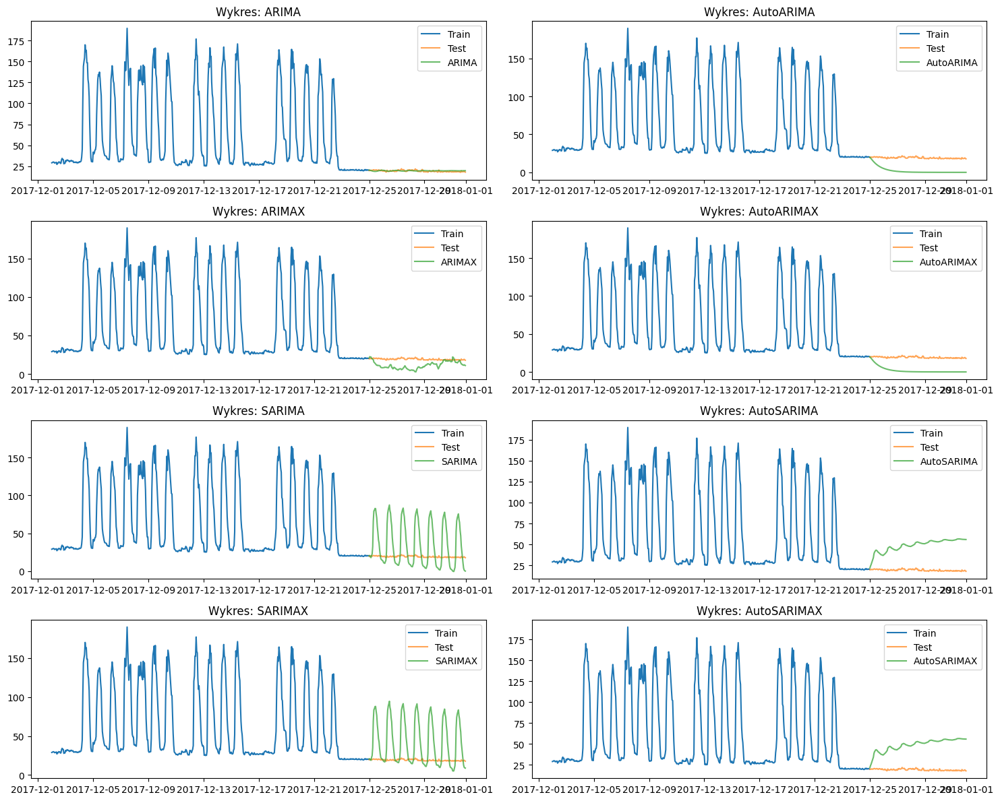


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         1.054229   0.924513  0.048548      10.345283        0.733480
ARIMAX        9.393868   8.108658  0.417102       0.000000        0.969911
AutoARIMA    17.479003  17.026736  0.892619       0.000000        4.404407
AutoARIMAX   17.479003  17.026736  0.892619       0.000000        4.291803
AutoSARIMA   30.651911  29.708969  1.565523       0.000000      261.730206
AutoSARIMAX  30.651911  29.708969  1.565523       0.000000      251.409052
SARIMA       32.575124  25.236204  1.313897      48.462449       40.274659
SARIMAX      36.736812  26.616354  1.384980       0.000000       45.861205


In [12]:
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 12))
axes = axes.flatten()  # Spłaszczenie do 1D listy osi

for i, col in enumerate(results.columns[:8]):
    ax = axes[i]
    ax.plot(train, label='Train')
    ax.plot(test, label='Test', alpha=0.7)
    ax.plot(results[col], label=col, alpha=0.7)
    ax.set_title(f'Wykres: {col}')
    ax.legend()

plt.tight_layout()
plt.show()

# 10. Podsumowanie metryk
metrics_df = pd.DataFrame(metrics).set_index('Model')
print("\nMetryki efektywności:")
print(metrics_df.sort_values('RMSE'))


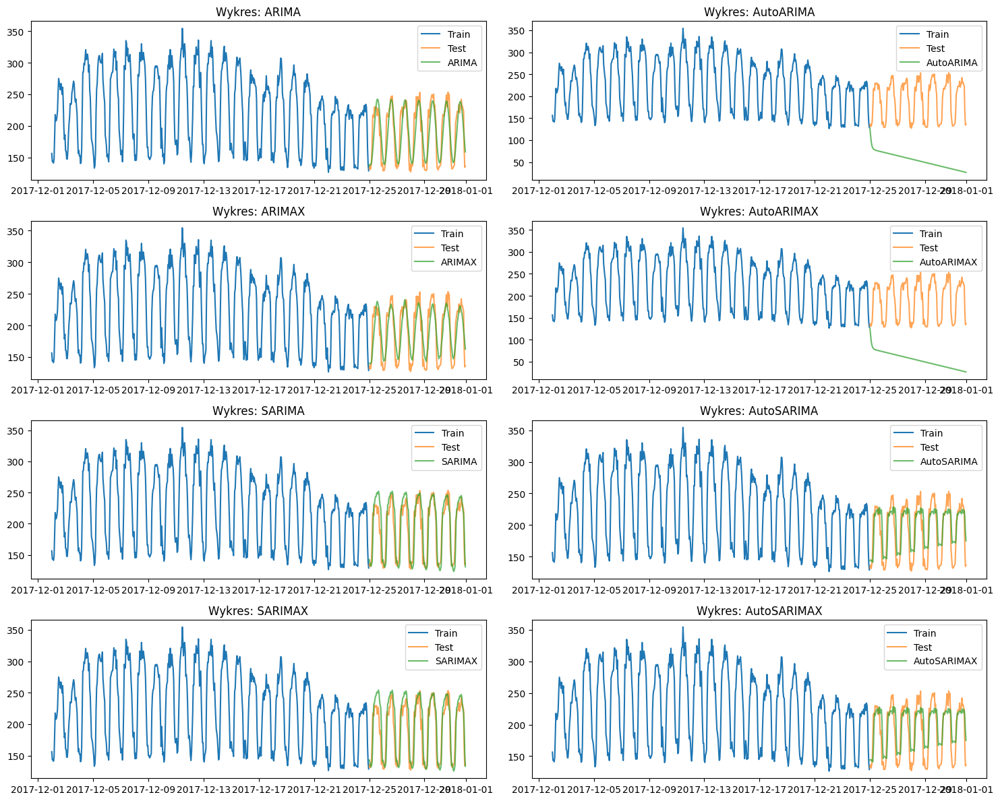


Metryki efektywności:
                   RMSE         MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
SARIMA        14.336179   11.249448  0.058616      68.528850       10.451430
SARIMAX       15.138991   11.771046  0.060870       0.000000       19.474789
ARIMA         17.544192   13.980997  0.075876      23.987007        0.847775
ARIMAX        18.325584   15.386645  0.086673       0.000000        1.036226
AutoSARIMA    21.260787   17.243511  0.104094       0.000000      327.383304
AutoSARIMAX   21.260787   17.243511  0.104094       0.000000      339.396430
AutoARIMA    145.827652  137.464303  0.698456       0.000000        6.256171
AutoARIMAX   145.827652  137.464303  0.698456       0.000000        9.965663


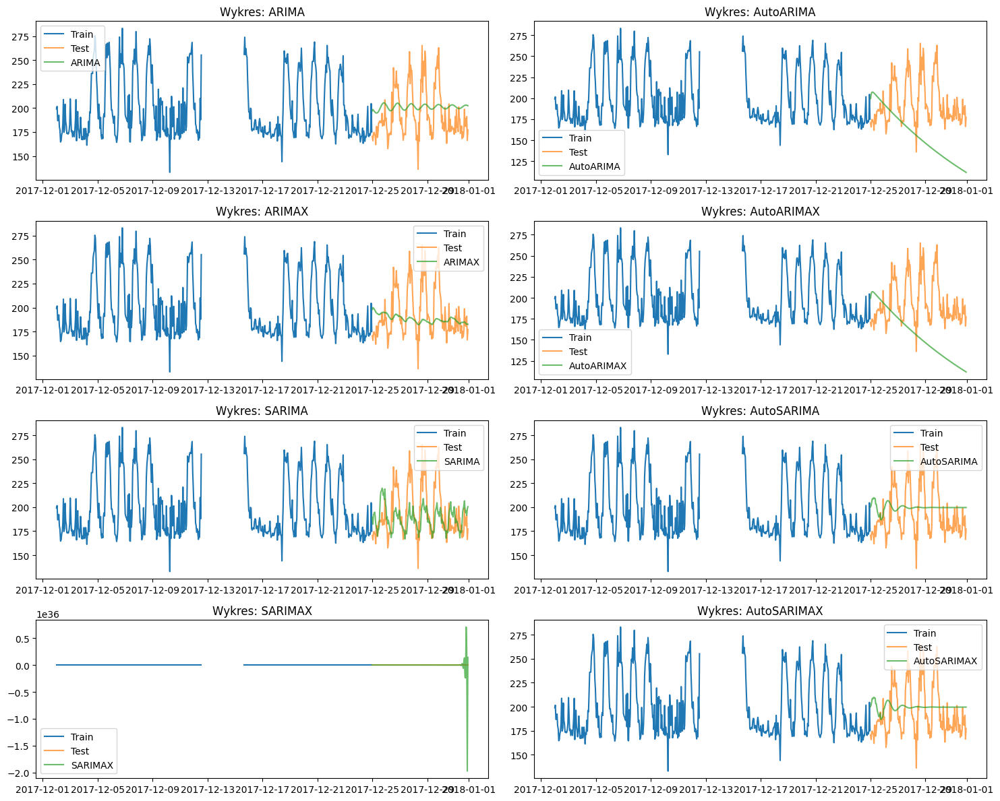


Metryki efektywności:
                     RMSE           MAE          MAPE  Czas treningu  \
Model                                                                  
SARIMA       2.446495e+01  1.837202e+01  8.918068e-02     128.603435   
ARIMA        2.537525e+01  2.245977e+01  1.165792e-01      47.459457   
ARIMAX       2.670880e+01  2.014440e+01  9.771283e-02       0.000000   
AutoSARIMA   2.742372e+01  2.367667e+01  1.223492e-01       0.000000   
AutoSARIMAX  2.742372e+01  2.367667e+01  1.223492e-01       0.000000   
AutoARIMA    5.477855e+01  4.663100e+01  2.316751e-01       0.000000   
AutoARIMAX   5.477855e+01  4.663100e+01  2.316751e-01       0.000000   
SARIMAX      1.661996e+35  2.326788e+34  1.336382e+32       0.000000   

             Czas predykcji  
Model                        
SARIMA            49.313749  
ARIMA              1.808581  
ARIMAX             2.032320  
AutoSARIMA       476.829027  
AutoSARIMAX      497.667650  
AutoARIMA          7.104224  
AutoARIMAX      

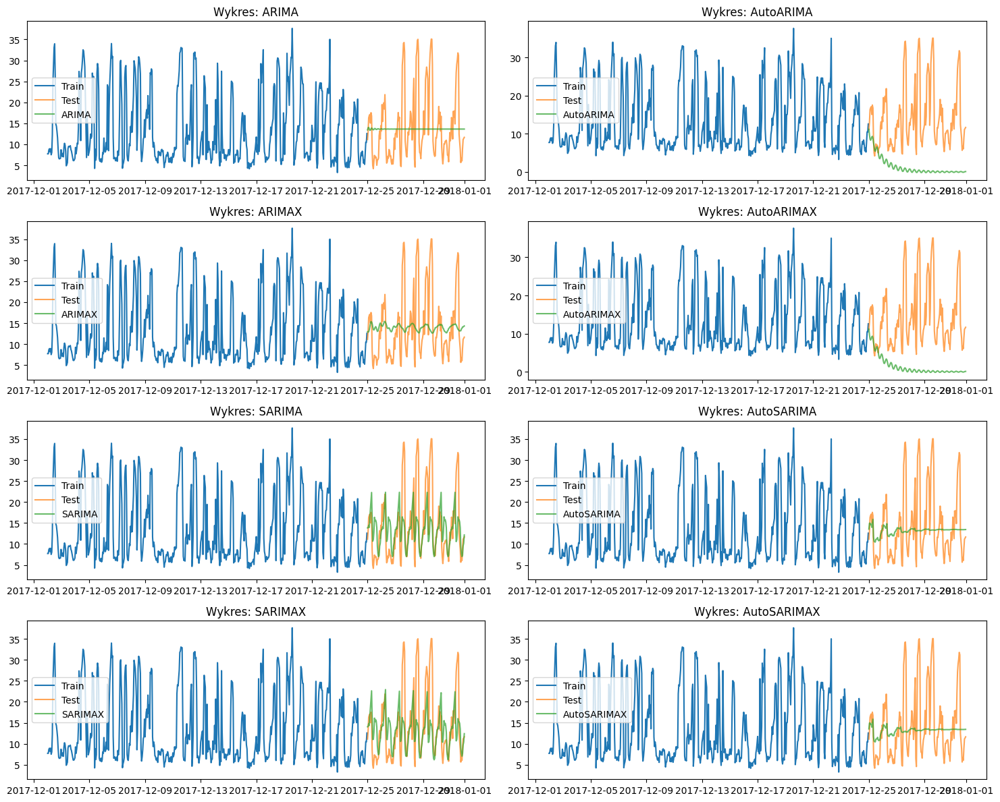


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
SARIMA        7.278682   5.062996  0.378483     130.726346       18.108995
SARIMAX       7.444853   5.123849  0.379484       0.000000       19.682074
AutoSARIMA    8.058699   5.832135  0.458614       0.000000      406.508449
AutoSARIMAX   8.058699   5.832135  0.458614       0.000000      372.957463
ARIMAX        8.246613   6.149000  0.522921       0.000000        1.492229
ARIMA         8.249188   6.259353  0.525131      15.126194        0.752686
AutoARIMA    15.804745  13.107004  0.868543       0.000000        9.339251
AutoARIMAX   15.804745  13.107004  0.868543       0.000000        8.816693


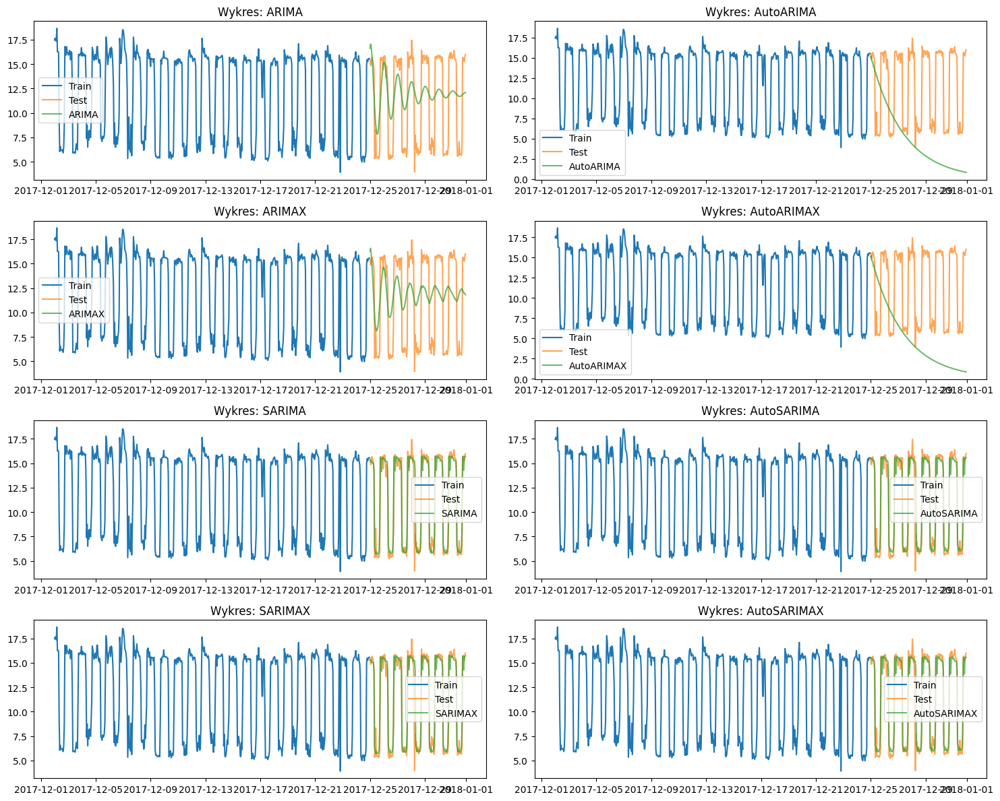


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMA       1.262487  0.630913  0.081648      66.491486        9.465825
SARIMAX      1.263425  0.630229  0.082214       0.000000       11.797942
AutoSARIMA   1.271446  0.676107  0.085962       0.000000      458.192786
AutoSARIMAX  1.271446  0.676107  0.085962       0.000000      470.417192
ARIMA        3.962976  3.655189  0.453093      42.015126        0.884631
ARIMAX       4.168478  3.873500  0.476623       0.000000        1.413664
AutoARIMA    8.908752  7.497813  0.645187       0.000000        6.248380
AutoARIMAX   8.908752  7.497813  0.645187       0.000000        5.833697


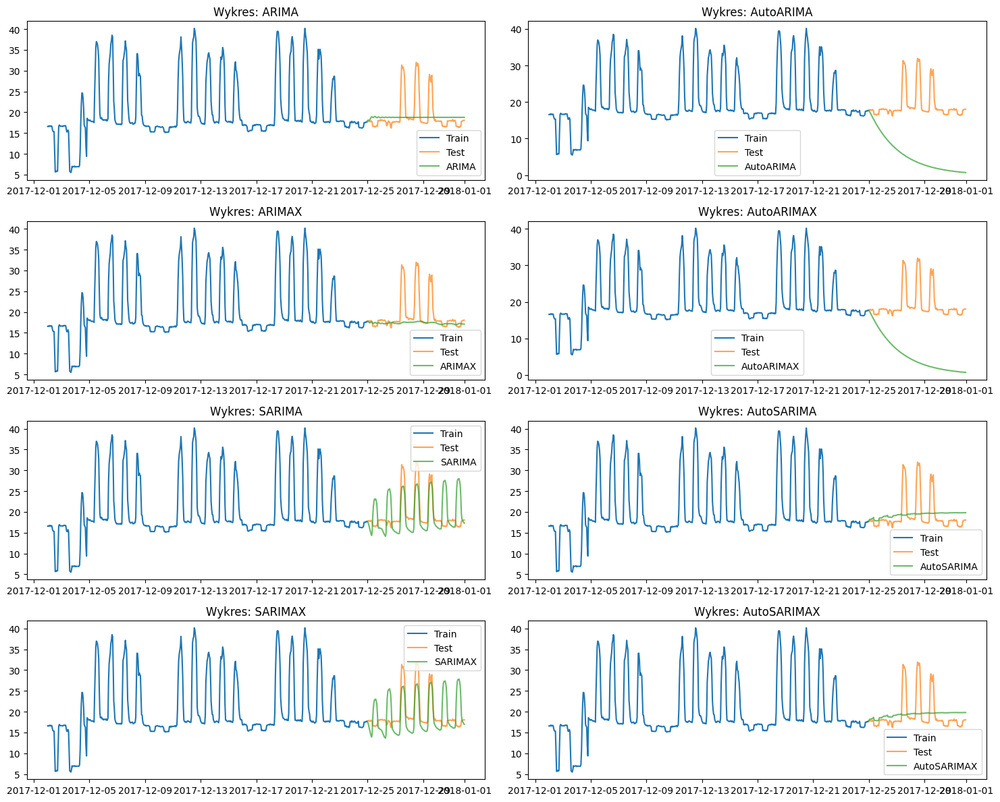


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    4.051497   2.775887  0.127888       0.000000      390.257776
AutoSARIMAX   4.051497   2.775887  0.127888       0.000000      405.674327
ARIMA         4.114041   2.453184  0.107400      32.924213        1.021291
SARIMA        4.364051   3.326179  0.181425      98.731715       64.872080
SARIMAX       4.404230   3.473864  0.189271       0.000000       66.119356
ARIMAX        4.436162   2.194487  0.087445       0.000000        1.500146
AutoARIMA    15.460041  13.977461  0.709862       0.000000        6.615539
AutoARIMAX   15.460041  13.977461  0.709862       0.000000        6.604969


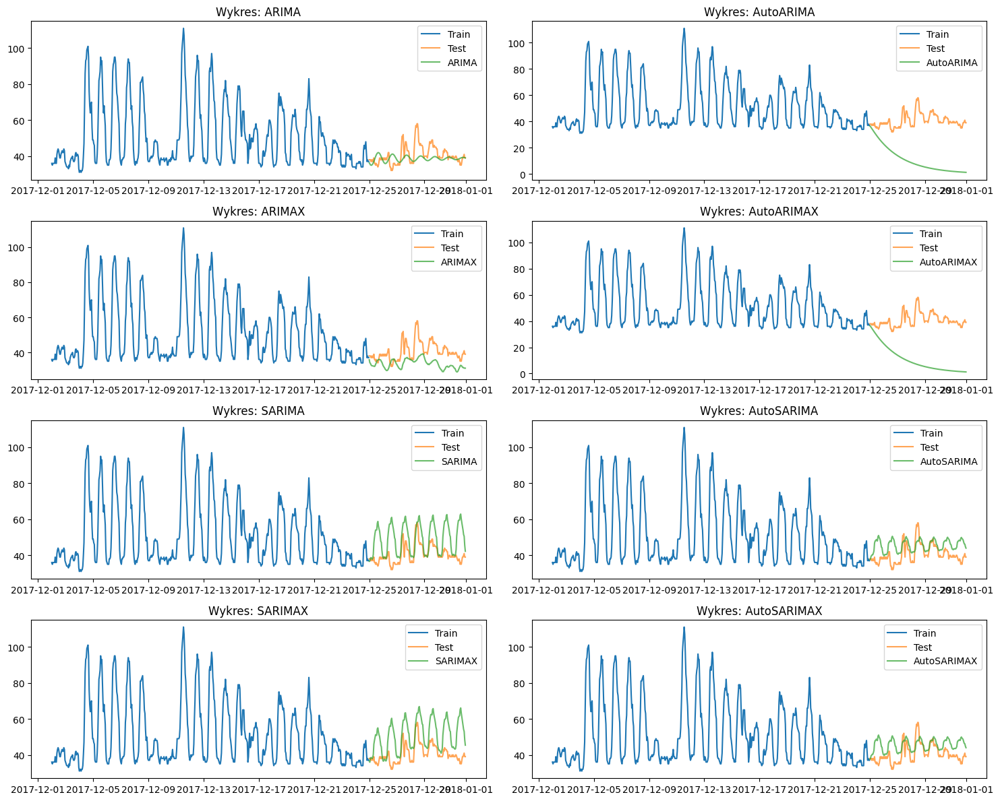


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         5.639042   4.023737  0.093612      31.067765        1.013054
AutoSARIMA    7.115168   5.776694  0.150600       0.000000      358.922050
AutoSARIMAX   7.115168   5.776694  0.150600       0.000000      346.272722
ARIMAX        8.676594   7.252616  0.169663       0.000000        1.625357
SARIMA       11.807942   8.911407  0.228875      59.005503       15.302302
SARIMAX      12.792844  10.461036  0.264793       0.000000       17.391965
AutoARIMA    32.442892  30.001131  0.725257       0.000000        6.416458
AutoARIMAX   32.442892  30.001131  0.725257       0.000000        7.289984


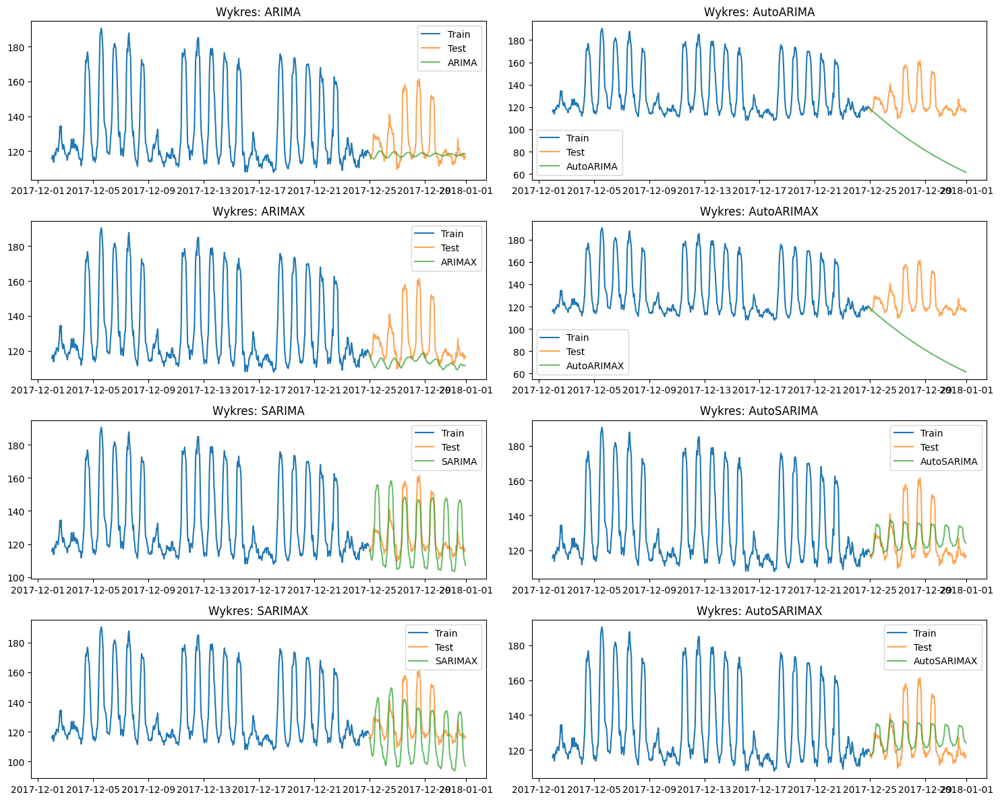


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    9.937988   7.973653  0.062002       0.000000      455.023923
AutoSARIMAX   9.937988   7.973653  0.062002       0.000000      433.507720
SARIMA       12.760085  10.340587  0.083185     105.812841       51.598313
ARIMA        14.849074   8.917259  0.063695      27.292116        1.061410
SARIMAX      15.087370  14.216514  0.114079       0.000000       54.712416
ARIMAX       17.374394  11.999363  0.087773       0.000000        1.695579
AutoARIMA    42.930496  38.269657  0.301315       0.000000        6.558298
AutoARIMAX   42.930496  38.269657  0.301315       0.000000        6.580379


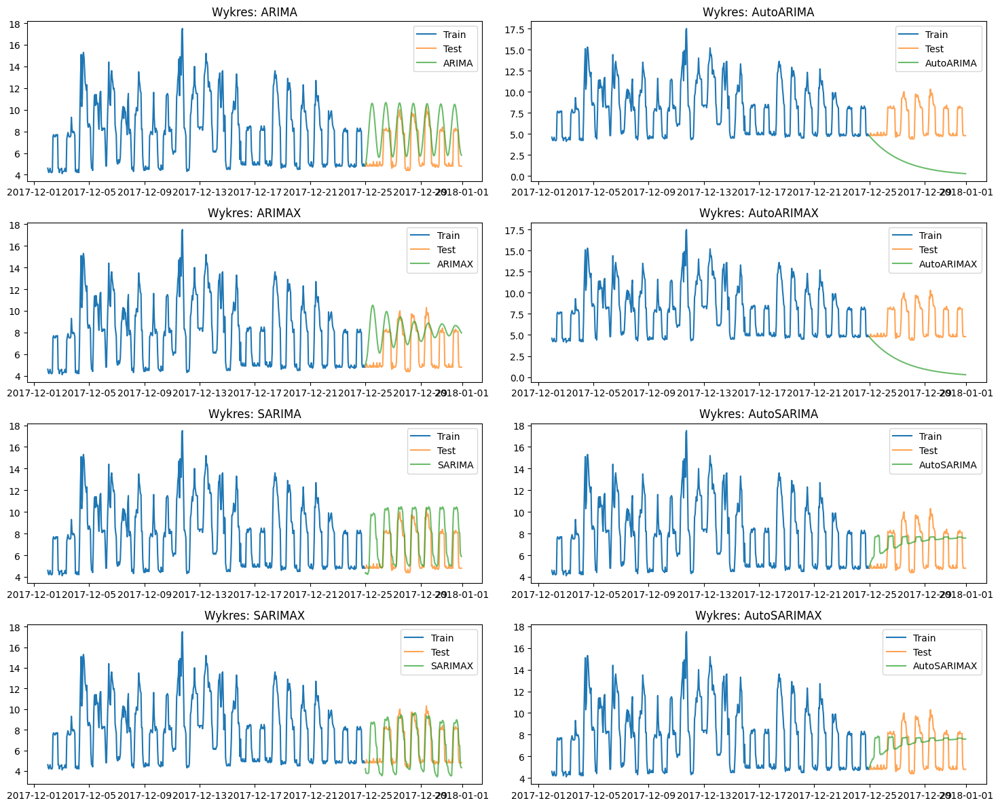


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      1.270623  0.965379  0.171701       0.000000       63.441868
SARIMA       1.830964  1.355556  0.230718     102.705956       72.197917
AutoSARIMA   1.921056  1.678790  0.309168       0.000000      315.645416
AutoSARIMAX  1.921056  1.678790  0.309168       0.000000      289.013744
ARIMA        2.226000  1.808456  0.330315      26.269497        1.299082
ARIMAX       2.329636  1.895224  0.366687       0.000000        1.890023
AutoARIMA    5.402989  4.813549  0.720022       0.000000        6.037402
AutoARIMAX   5.402989  4.813549  0.720022       0.000000        5.130003


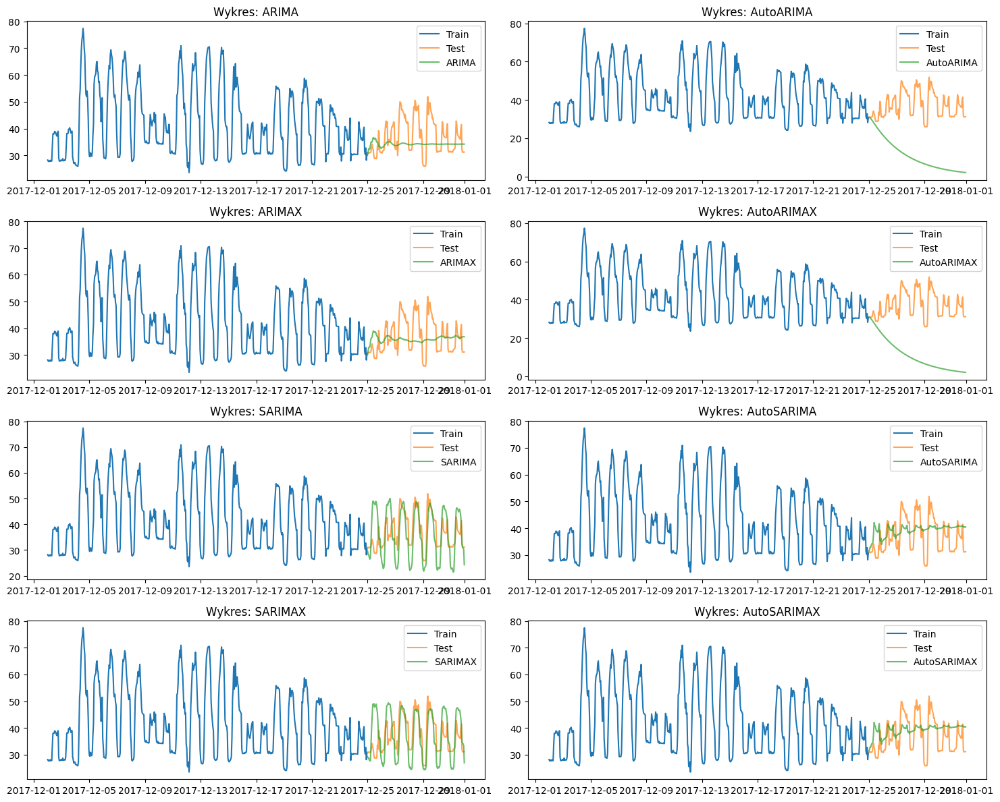


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    6.545835   5.660294  0.163358       0.000000      292.377062
AutoSARIMAX   6.545835   5.660294  0.163358       0.000000      293.831957
ARIMAX        6.793933   5.669291  0.150307       0.000000        0.970865
ARIMA         7.150299   5.659459  0.142850      20.259128        0.770273
SARIMAX       7.230042   5.761604  0.164510       0.000000       53.362844
SARIMA        7.721008   6.281395  0.180400      87.584793       56.714198
AutoARIMA    28.649939  26.191270  0.688237       0.000000        3.941846
AutoARIMAX   28.649939  26.191270  0.688237       0.000000        4.040924


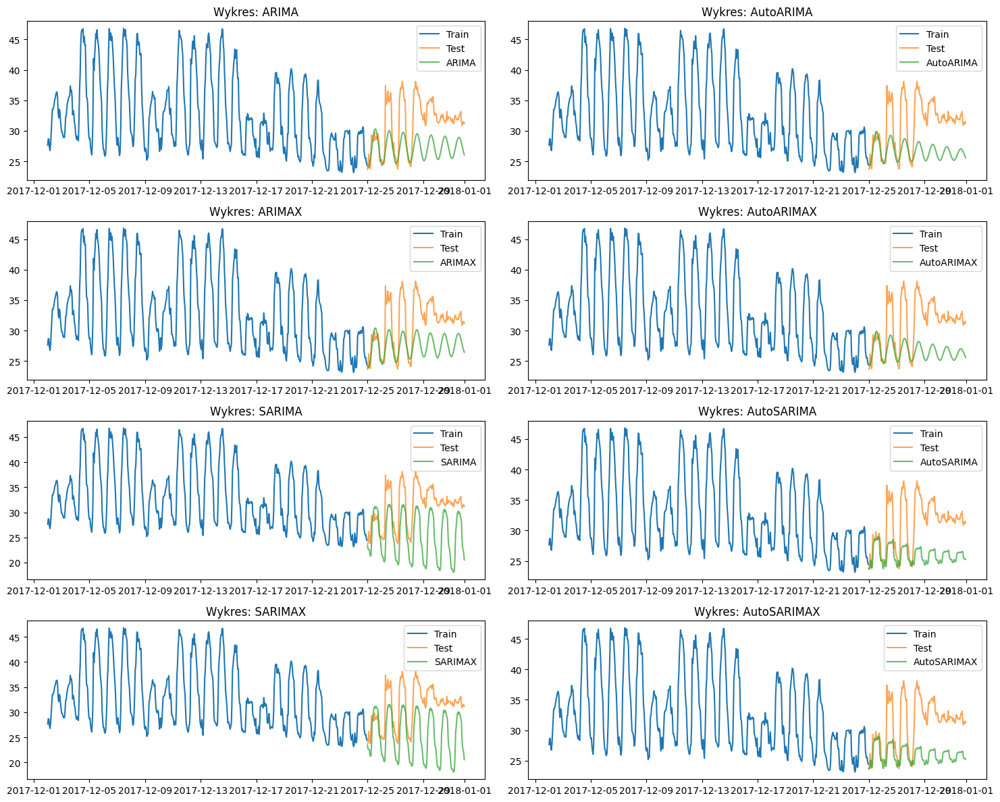


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
ARIMAX       4.695809  3.967503  0.119855       0.000000        1.075643
ARIMA        4.991213  4.218441  0.127225      18.163268        0.665890
AutoARIMA    5.656172  4.805467  0.144721       0.000000        4.765727
AutoARIMAX   5.656172  4.805467  0.144721       0.000000        4.753049
AutoSARIMA   6.173470  5.265600  0.158564       0.000000      207.755849
AutoSARIMAX  6.173470  5.265600  0.158564       0.000000      206.780650
SARIMA       6.970905  5.967198  0.188959      60.714880       43.279715
SARIMAX      6.992339  6.004714  0.190049       0.000000       41.148317


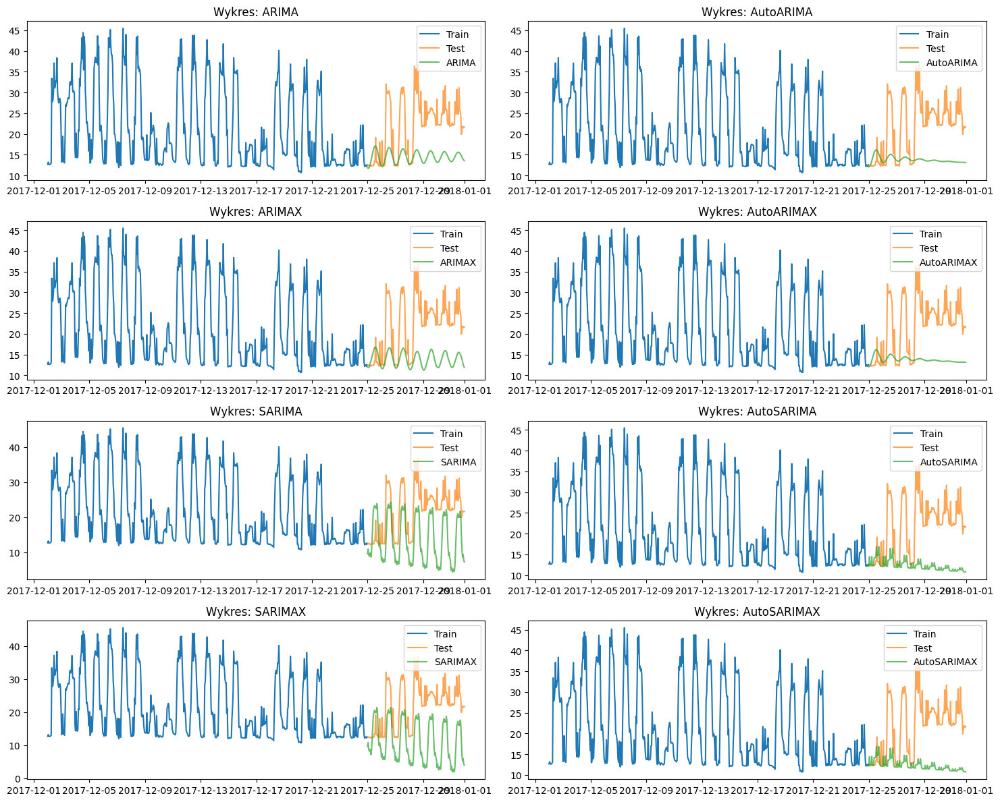


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         9.286660   7.727544  0.312791      19.816844        0.835927
ARIMAX        9.747698   8.174300  0.332329       0.000000        1.156631
SARIMA       10.245383   8.919040  0.419890      57.811505       36.725085
AutoARIMA    10.252752   8.503230  0.342828       0.000000        5.325977
AutoARIMAX   10.252752   8.503230  0.342828       0.000000        5.246518
AutoSARIMA   11.501954   9.602459  0.385982       0.000000      184.173452
AutoSARIMAX  11.501954   9.602459  0.385982       0.000000      176.481066
SARIMAX      12.463080  11.201030  0.519114       0.000000       39.463566


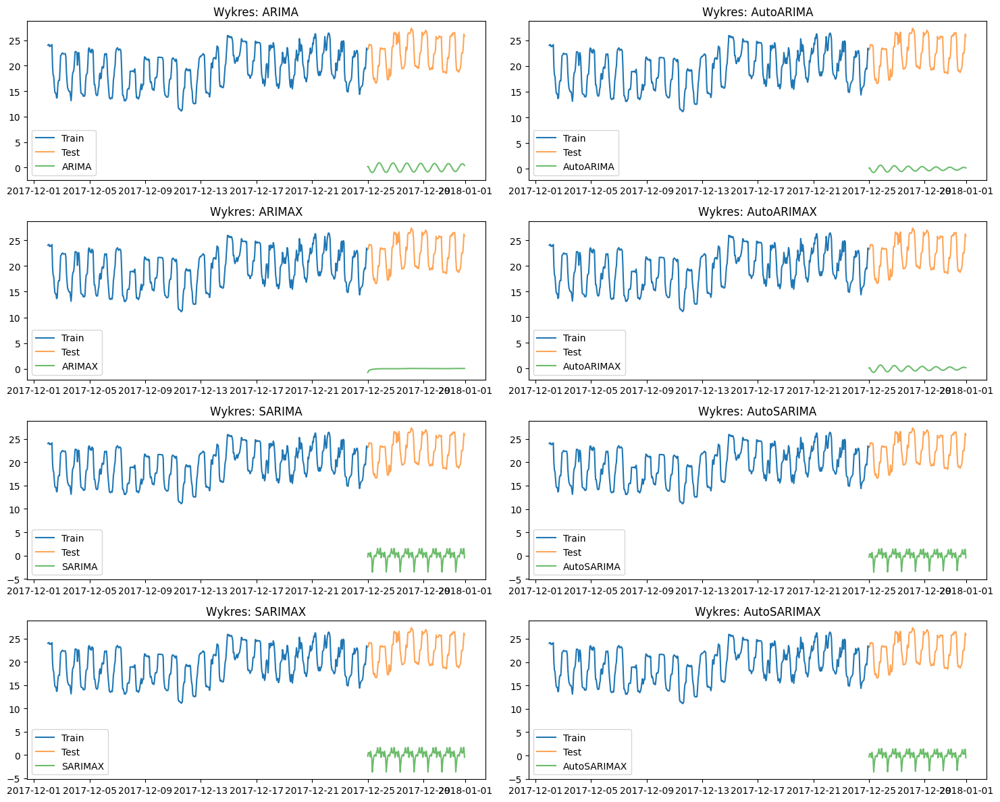


Metryki efektywności:
                 RMSE       MAE          MAPE  Czas treningu  Czas predykcji
Model                                                                       
SARIMA       0.702815  0.516648  2.623672e+13     113.268268        5.951242
AutoSARIMA   0.717516  0.523841  2.337259e+13       0.000000      195.011776
AutoSARIMAX  0.717516  0.523841  2.337259e+13       0.000000      200.942919
SARIMAX      0.728550  0.543415  2.930641e+13       0.000000       11.166138
ARIMA        0.935547  0.716616  3.250863e+13      28.874887        0.722470
AutoARIMA    1.010268  0.699906  1.202730e+13       0.000000        3.543562
AutoARIMAX   1.010268  0.699906  1.202730e+13       0.000000        3.344304
ARIMAX       1.175394  0.776378  3.008995e+12       0.000000        0.646486


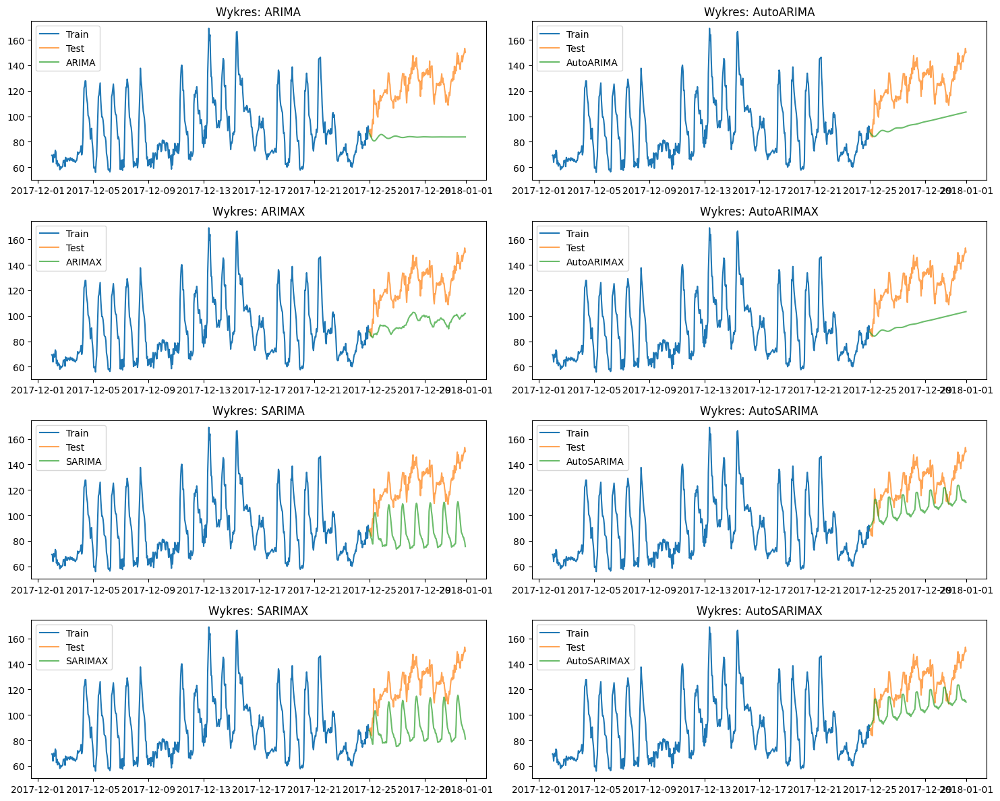


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA   20.806156  18.333391  0.142129       0.000000      237.444074
AutoSARIMAX  20.806156  18.333391  0.142129       0.000000      219.500564
ARIMAX       31.777704  30.138484  0.235934       0.000000        0.651177
AutoARIMA    32.247543  30.286296  0.236536       0.000000       11.344588
AutoARIMAX   32.247543  30.286296  0.236536       0.000000        9.465730
SARIMAX      37.386515  34.222348  0.268391       0.000000       34.712781
SARIMA       40.963500  37.674969  0.295283      86.647973       27.217558
ARIMA        43.080360  40.809957  0.318781       5.556054        0.569461


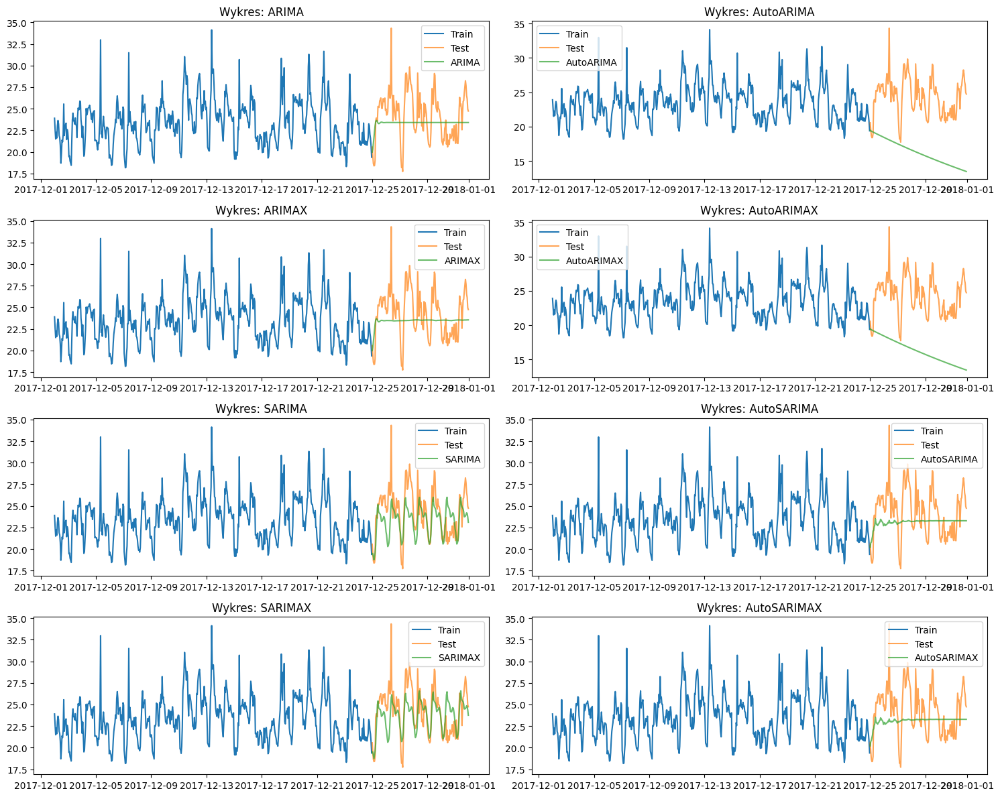


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      2.268818  1.714330  0.069397       0.000000        9.974828
SARIMA       2.418633  1.862881  0.074441      77.956194        9.571329
ARIMAX       2.757902  2.253630  0.091895       0.000000        2.290322
ARIMA        2.785161  2.271367  0.092327       9.583655        0.716044
AutoSARIMA   2.862277  2.364006  0.095341       0.000000      357.651690
AutoSARIMAX  2.862277  2.364006  0.095341       0.000000      350.138198
AutoARIMA    8.582543  8.039745  0.323524       0.000000        3.460284
AutoARIMAX   8.582543  8.039745  0.323524       0.000000        3.404687


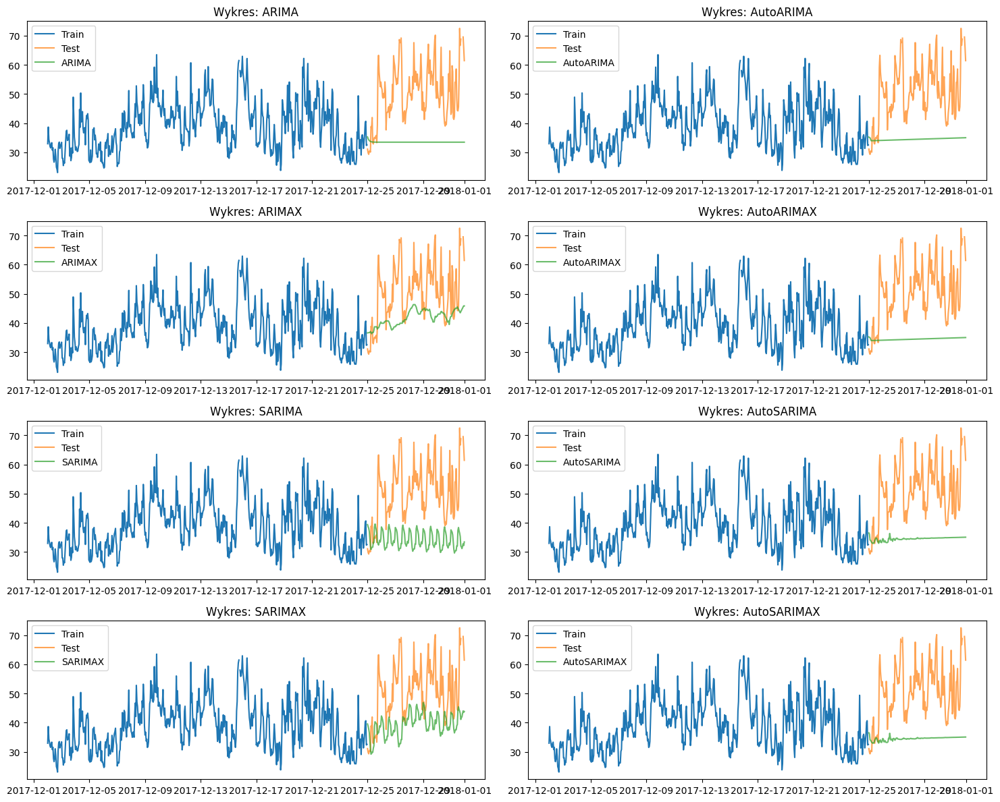


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMAX       12.092458   9.596529  0.175778       0.000000        0.144477
SARIMAX      13.967030  11.318530  0.206292       0.000000        2.901821
AutoSARIMA   18.246874  15.879944  0.293202       0.000000      181.754227
AutoSARIMAX  18.246874  15.879944  0.293202       0.000000      183.210512
AutoARIMA    18.305363  15.964355  0.295237       0.000000        5.436893
AutoARIMAX   18.305363  15.964355  0.295237       0.000000        5.342215
SARIMA       18.739868  16.345189  0.303562      41.065915        1.885921
ARIMA        19.228283  16.897714  0.313295       1.193314        0.079304


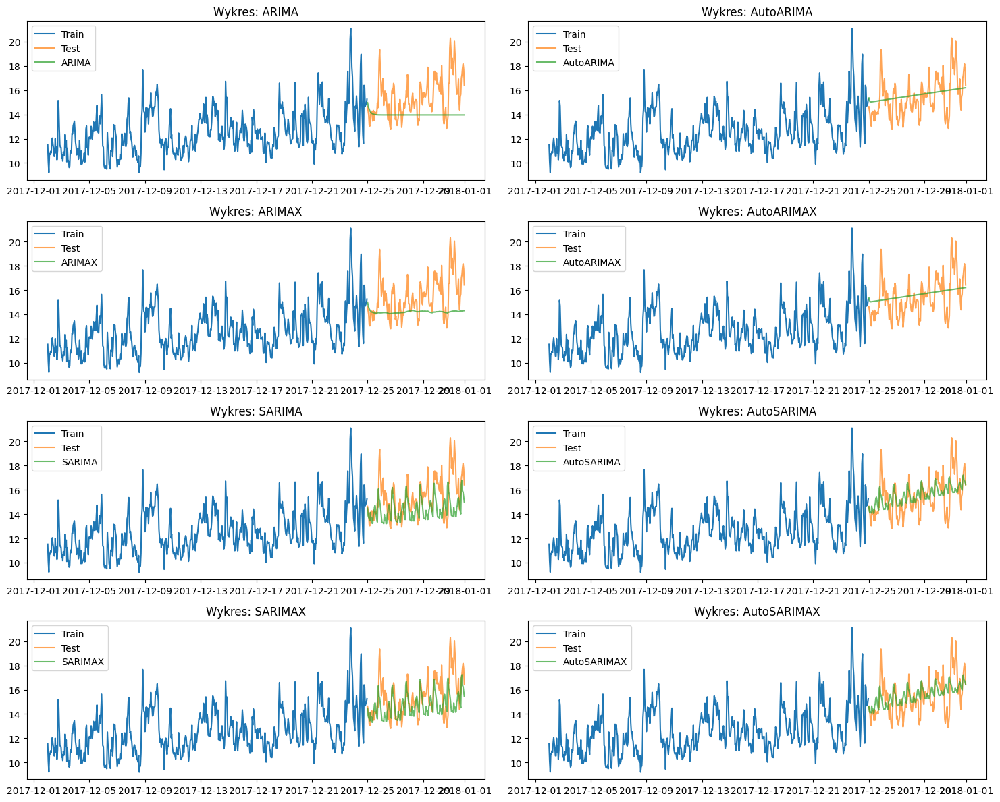


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
AutoSARIMA   1.461044  1.127385  0.073153       0.000000      215.038985
AutoSARIMAX  1.461044  1.127385  0.073153       0.000000      215.576229
AutoARIMA    1.489356  1.203613  0.078511       0.000000        9.053887
AutoARIMAX   1.489356  1.203613  0.078511       0.000000        7.883258
SARIMAX      1.765053  1.317280  0.081613       0.000000        5.854506
SARIMA       1.911339  1.431231  0.087954     105.390067        5.308840
ARIMAX       2.014519  1.531844  0.092814       0.000000        0.252542
ARIMA        2.184825  1.687538  0.102188       1.876695        0.129839


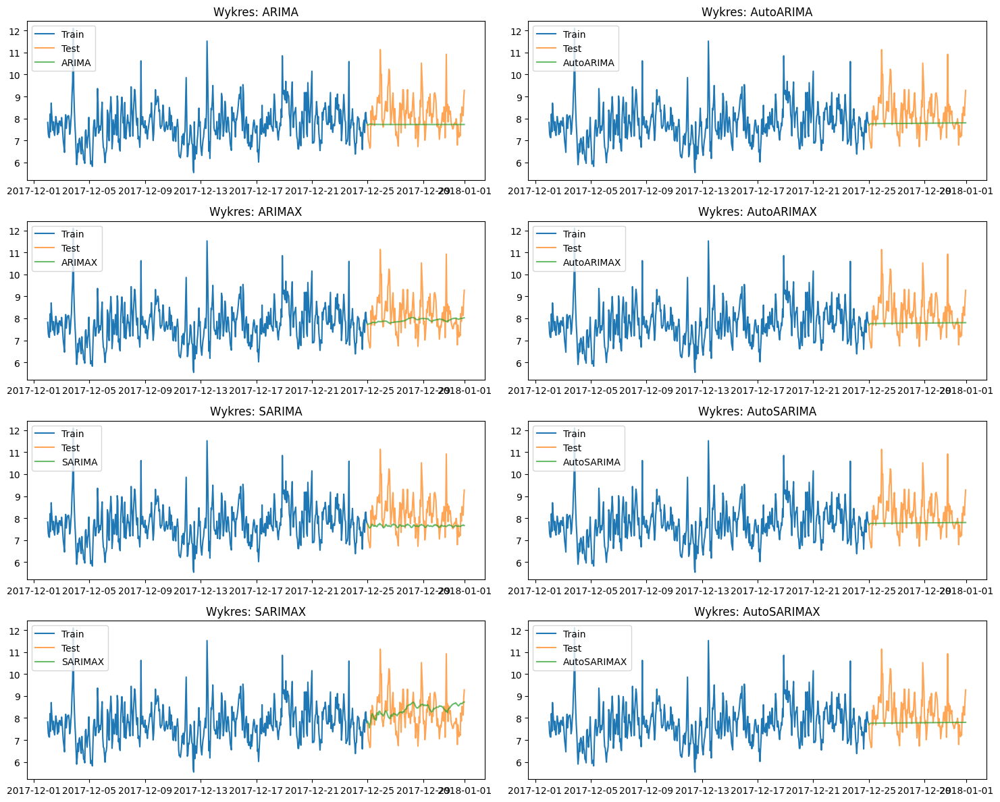


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      0.835397  0.650059  0.079976       0.000000        5.073901
ARIMAX       0.845343  0.620354  0.072734       0.000000        0.698975
AutoARIMA    0.891332  0.654083  0.075939       0.000000        9.581637
AutoSARIMA   0.891332  0.654083  0.075939       0.000000      273.674391
AutoARIMAX   0.891332  0.654083  0.075939       0.000000        9.613606
AutoSARIMAX  0.891332  0.654083  0.075939       0.000000      269.198033
ARIMA        0.916687  0.675779  0.078230       8.338908        0.460513
SARIMA       0.944027  0.705624  0.081378      24.565276        3.015887


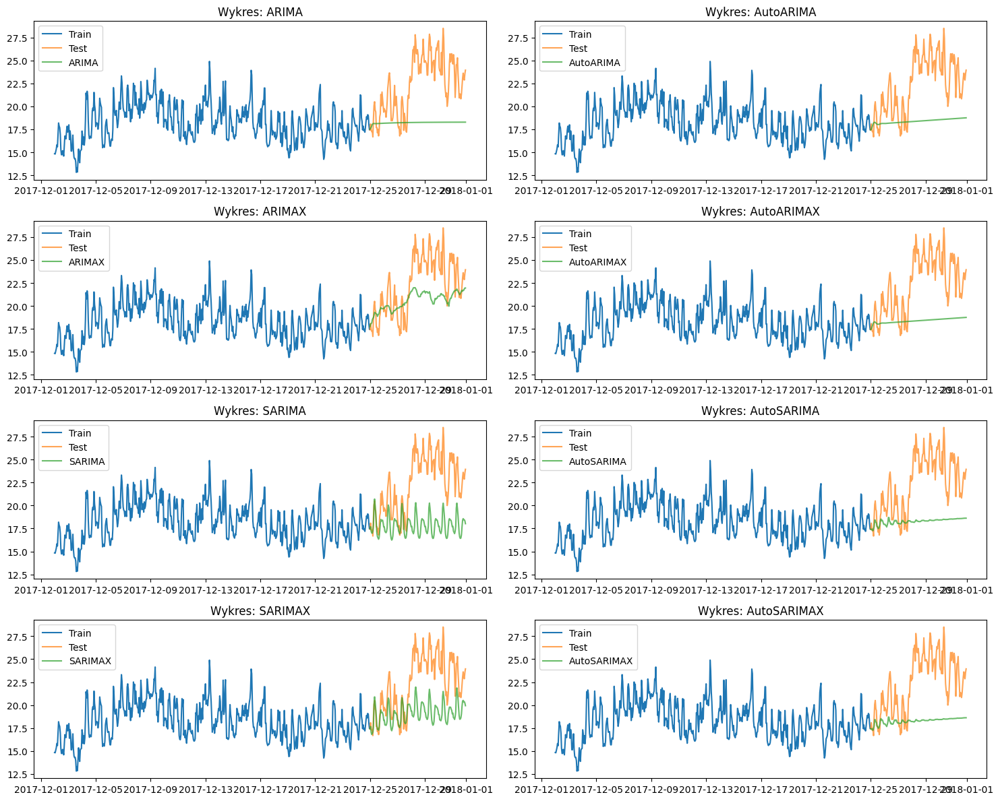


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
ARIMAX       2.993271  2.414384  0.102326       0.000000        0.922242
SARIMAX      4.070428  3.321827  0.138020       0.000000       17.632399
AutoARIMA    4.902014  4.104776  0.170900       0.000000        6.666216
AutoARIMAX   4.902014  4.104776  0.170900       0.000000        6.499847
AutoSARIMA   4.968835  4.141407  0.171997       0.000000      228.872763
AutoSARIMAX  4.968835  4.141407  0.171997       0.000000      218.951690
ARIMA        5.085183  4.270153  0.177854      13.685066        0.787134
SARIMA       5.270214  4.460500  0.186813      55.192058       38.907206


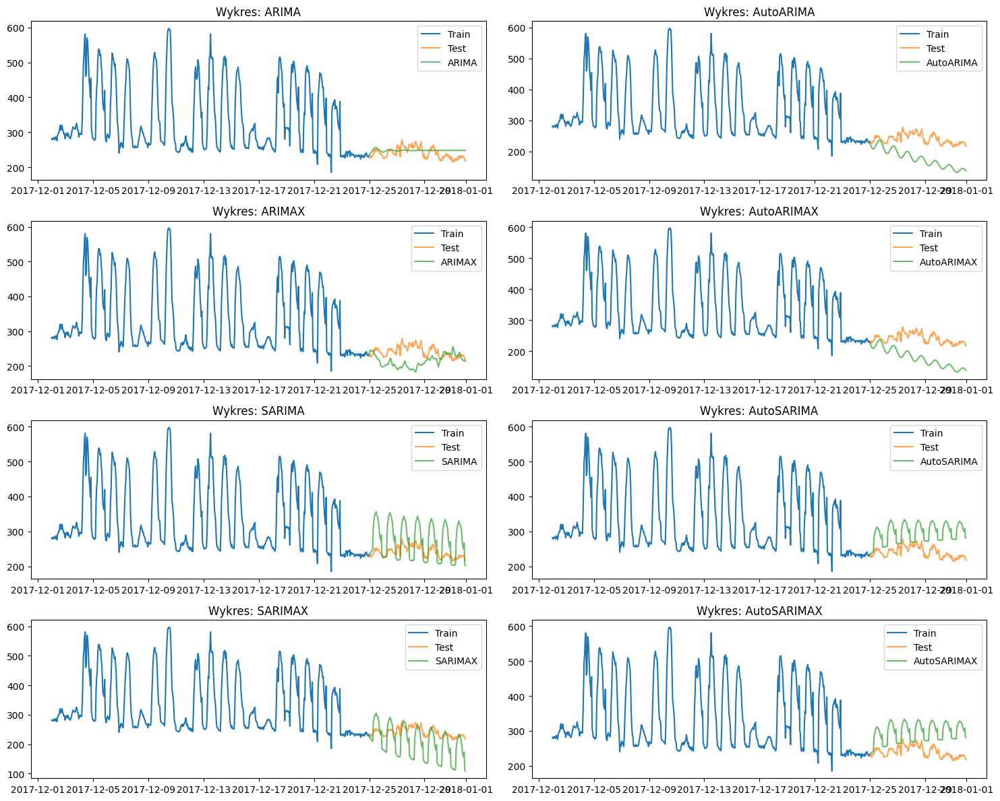


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA        16.285547  14.086065  0.059875      18.853446        0.755149
ARIMAX       38.587485  31.224016  0.125466       0.000000        1.047500
SARIMA       56.736484  47.023476  0.193429      58.039194       44.950148
SARIMAX      59.137807  46.729618  0.196650       0.000000       39.089729
AutoSARIMA   60.782960  55.238913  0.231828       0.000000      330.242081
AutoSARIMAX  60.782960  55.238913  0.231828       0.000000      326.406795
AutoARIMA    67.802375  62.322885  0.259003       0.000000        5.102804
AutoARIMAX   67.802375  62.322885  0.259003       0.000000        4.983204


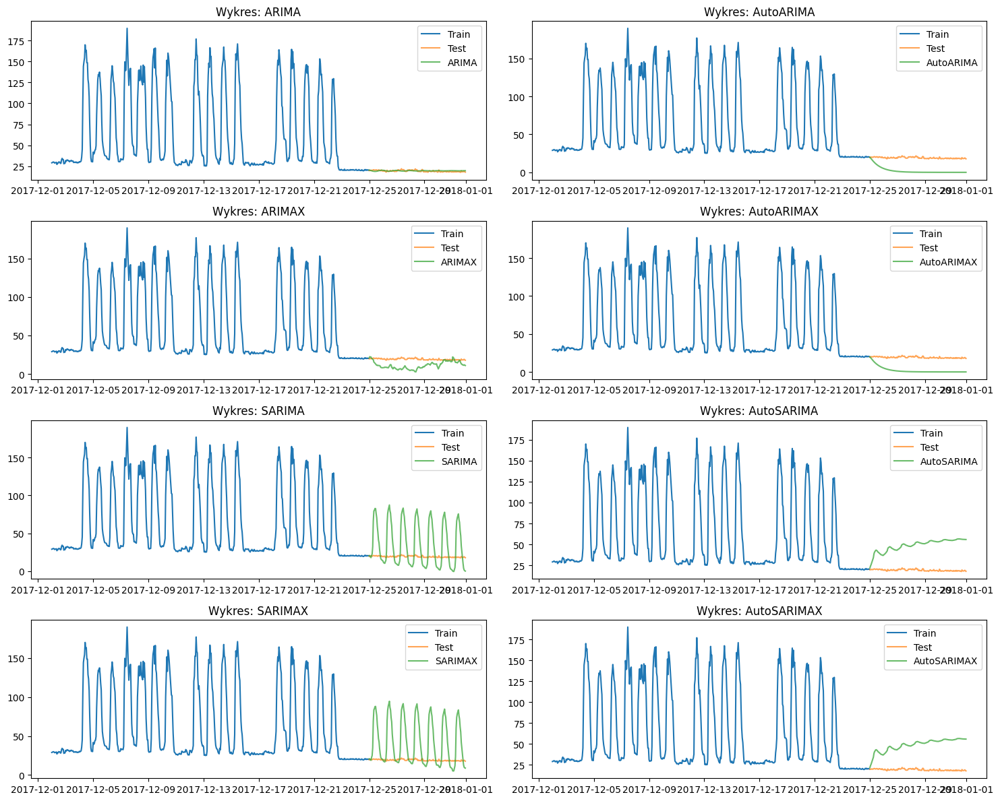


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         1.054229   0.924513  0.048548      10.345283        0.733480
ARIMAX        9.393868   8.108658  0.417102       0.000000        0.969911
AutoARIMA    17.479003  17.026736  0.892619       0.000000        4.404407
AutoARIMAX   17.479003  17.026736  0.892619       0.000000        4.291803
AutoSARIMA   30.651911  29.708969  1.565523       0.000000      261.730206
AutoSARIMAX  30.651911  29.708969  1.565523       0.000000      251.409052
SARIMA       32.575124  25.236204  1.313897      48.462449       40.274659
SARIMAX      36.736812  26.616354  1.384980       0.000000       45.861205


In [13]:

for j in range(len(all_results)):
    fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 12))
    axes = axes.flatten()  # Spłaszczenie do 1D listy osi

    for i, col in enumerate(all_results[j].columns[:8]):
        ax = axes[i]
        data = df_final[df_final['building_id'] == selected_buildings[j]].copy()
        data['timestamp'] = pd.to_datetime(data['timestamp'])
        data = data.set_index('timestamp').sort_index()
        data = data.asfreq('h')

        train = data['energy_consumption'][-720:-168]
        test = data['energy_consumption'][-168:]
        ax.plot(train.index, train, label='Train')
        ax.plot(test.index, test, label='Test', alpha=0.7)
        ax.plot(test.index, all_results[j][col], label=col, alpha=0.7)
        ax.set_title(f'Wykres: {col}')
        ax.legend()

    plt.tight_layout()
    plt.show()

    # 10. Podsumowanie metryk
    metrics_df = pd.DataFrame(all_metrics[j]).set_index('Model')
    print("\nMetryki efektywności:")
    print(metrics_df.sort_values('RMSE'))


In [64]:
def analizuj_wyniki_z_progowaniem(lista_list, progowanie=None):
    if progowanie is None:
        progowanie = {'RMSE': float('inf'), 
                     'MAE': float('inf'), 
                     'MAPE': float('inf'),
                     'Czas treningu': float('inf'),
                     'Czas predykcji': float('inf')}
    
    podsumowanie = {}
    liczba_analizowanych_list = 0

    for lista_modeli in lista_list:
        # Filtruj modele według progów
        przefiltrowane_modele = []
        for model in lista_modeli:
            include = True
            for metryka, prog in progowanie.items():
                if metryka in model and model[metryka] >= prog:
                    include = False
                    break
            if include:
                przefiltrowane_modele.append(model)
        
        if not przefiltrowane_modele:
            continue
            
        liczba_analizowanych_list += 1
        
        # Inicjalizacja modeli jeśli nie istnieją
        for model in przefiltrowane_modele:
            if model['Model'] not in podsumowanie:
                podsumowanie[model['Model']] = {
                    'RMSE': 0,
                    'MAE': 0,
                    'MAPE': 0,
                    'Czas treningu': 0,
                    'Czas predykcji': 0,
                    'Liczba wystąpień': 0
                }
            podsumowanie[model['Model']]['Liczba wystąpień'] += 1
        
        # Znajdź najlepsze w każdej kategorii
        najlepsze = {
            'RMSE': {'model': None, 'wartosc': float('inf')},
            'MAE': {'model': None, 'wartosc': float('inf')},
            'MAPE': {'model': None, 'wartosc': float('inf')},
            'Czas treningu': {'model': None, 'wartosc': float('inf')},
            'Czas predykcji': {'model': None, 'wartosc': float('inf')}
        }
        
        for model in przefiltrowane_modele:
            for metryka in najlepsze:
                if metryka in model:
                    if model[metryka] < najlepsze[metryka]['wartosc']:
                        najlepsze[metryka] = {'model': model['Model'], 'wartosc': model[metryka]}
        
        # Zaktualizuj podsumowanie
        for metryka, dane in najlepsze.items():
            if dane['model']:
                podsumowanie[dane['model']][metryka] += 1
    
    # Przygotuj wyniki do prezentacji
    wyniki = {
        'podsumowanie': podsumowanie,
        'liczba_analizowanych_list': liczba_analizowanych_list,
        'progowanie': progowanie
    }
    return wyniki

def pokaz_podsumowanie(wyniki):
    print(f"\nPodsumowanie najlepszych wyników (przeanalizowano {wyniki['liczba_analizowanych_list']} list z progami: {wyniki['progowanie']})")
    print("{:<15} {:<8} {:<8} {:<8} {:<15} {:<15} {:<10}".format(
        'Model', 'RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji', 'Wystąpienia'))
    
    for model, dane in wyniki['podsumowanie'].items():
        print("{:<15} {:<8} {:<8} {:<8} {:<15} {:<15} {:<10}".format(
            model,
            dane['RMSE'],
            dane['MAE'],
            dane['MAPE'],
            dane['Czas treningu'],
            dane['Czas predykcji'],
            dane['Liczba wystąpień']))

# Ustawienie progów
progi = {'RMSE': 20000, 'MAE': 20000, 'MAPE': 2200}

wyniki = analizuj_wyniki_z_progowaniem(all_metrics, progowanie=progi)
df_arima = pd.DataFrame(wyniki['podsumowanie']).T
df_arima[['RMSE', 'MAE', 'MAPE']].sort_values(by='RMSE', ascending=False)


,RMSE,MAE,MAPE
AutoSARIMA,5,3,3
ARIMA,4,5,5
SARIMA,4,3,4
ARIMAX,3,5,5
SARIMAX,3,3,2
AutoARIMA,0,0,0
AutoARIMAX,0,0,0
AutoSARIMAX,0,0,0


In [34]:
# Inicjalizacja struktur danych
metrics = ['RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji']
auto_models = []
standard_models = []

# Podział na modele Auto i standardowe
for results in all_metrics:
    for model in results:
        if model['Model'].startswith('Auto'):
            auto_models.append(model)
        else:
            standard_models.append(model)

# Konwersja do DataFrame
auto_df = pd.DataFrame(auto_models)
standard_df = pd.DataFrame(standard_models)

# Filtrowanie skrajnych wartości
thresholds = {'RMSE': 20000, 'MAE': 20000, 'MAPE': 2200}

for metric, threshold in thresholds.items():
    auto_df = auto_df[auto_df[metric] < threshold]
    standard_df = standard_df[standard_df[metric] < threshold]

# Obliczenie średnich
auto_stats = auto_df.mean(numeric_only=True)
standard_stats = standard_df.mean(numeric_only=True)

# Przygotowanie wyników
comparison = pd.DataFrame({
    'Metryka': metrics,
    'Średnia (Auto)': [auto_stats.get(metric, float('nan')) for metric in metrics],
    'Średnia (Standard)': [standard_stats.get(metric, float('nan')) for metric in metrics],
    'Różnica': [auto_stats.get(metric, float('nan')) - standard_stats.get(metric, float('nan')) for metric in metrics],
    'Zmiana %': [
        ((auto_stats.get(metric, float('nan')) - standard_stats.get(metric, float('nan'))) / standard_stats.get(metric, float('nan')) * 100)
        if standard_stats.get(metric, float('nan')) != 0 else float('nan') for metric in metrics
    ]
})

# Formatowanie
float_cols = ['Średnia (Auto)', 'Średnia (Standard)', 'Różnica', 'Zmiana %']
comparison[float_cols] = comparison[float_cols].round(4)

# Wyniki
print("=== PODSUMOWANIE ===")
print(f"Liczba wyników Auto (po filtrze): {len(auto_df)}")
print(f"Liczba wyników Standard (po filtrze): {len(standard_df)}\n")

print("=== ŚREDNIE WARTOŚCI METRYK ===")
print(comparison.to_string(index=False))

print("\n=== WNIOSKI ===")
print("1. Jakość predykcji:")
better_rmse = "lepsze" if comparison.loc[0, 'Różnica'] < 0 else "gorsze"
print(f"   • Modele Auto są {better_rmse} o {abs(comparison.loc[0, 'Zmiana %']):.2f}% w RMSE")

print("\n2. Wydajność czasowa:")
train_time_diff = comparison.loc[3, 'Różnica']
print(f"   • Czas treningu: {'korzyść Auto' if train_time_diff < 0 else 'korzyść Standard'} ({abs(train_time_diff):.2f}s)")


=== PODSUMOWANIE ===
Liczba wyników Auto (po filtrze): 76
Liczba wyników Standard (po filtrze): 75

=== ŚREDNIE WARTOŚCI METRYK ===
       Metryka  Średnia (Auto)  Średnia (Standard)  Różnica  Zmiana %
          RMSE         20.0986             12.1178   7.9809   65.8609
           MAE         18.0125              9.9472   8.0653   81.0816
          MAPE          0.3470              0.2209   0.1261   57.0500
 Czas treningu          0.0000             21.2445 -21.2445 -100.0000
Czas predykcji        138.8256             14.0063 124.8193  891.1649

=== WNIOSKI ===
1. Jakość predykcji:
   • Modele Auto są gorsze o 65.86% w RMSE

2. Wydajność czasowa:
   • Czas treningu: korzyść Auto (21.24s)


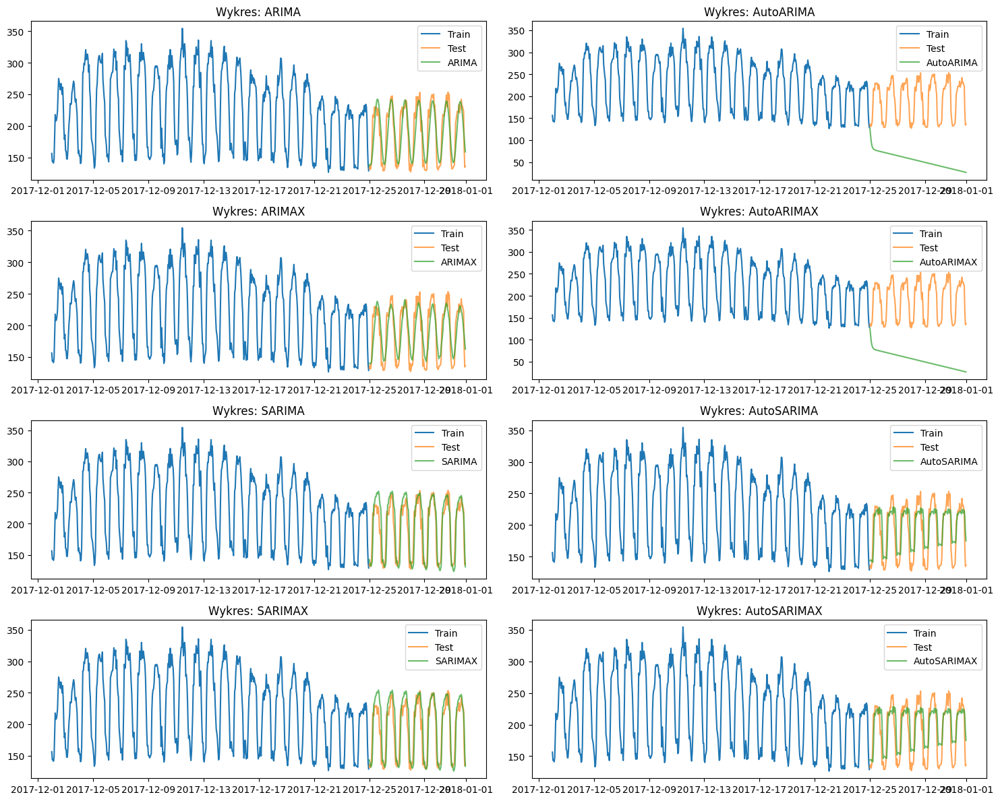


Metryki efektywności:
                   RMSE         MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                       
SARIMA        14.336179   11.249448  0.058616      71.075334       11.035426
SARIMAX       15.138991   11.771046  0.060870       0.000000       19.370362
ARIMA         17.544192   13.980997  0.075876      21.087747        0.959949
ARIMAX        18.325584   15.386645  0.086673       0.000000        1.119300
AutoSARIMA    21.260787   17.243511  0.104094       0.000000      252.570820
AutoSARIMAX   21.260787   17.243511  0.104094       0.000000      253.797779
AutoARIMA    145.827652  137.464303  0.698456       0.000000        6.531333
AutoARIMAX   145.827652  137.464303  0.698456       0.000000        6.944888


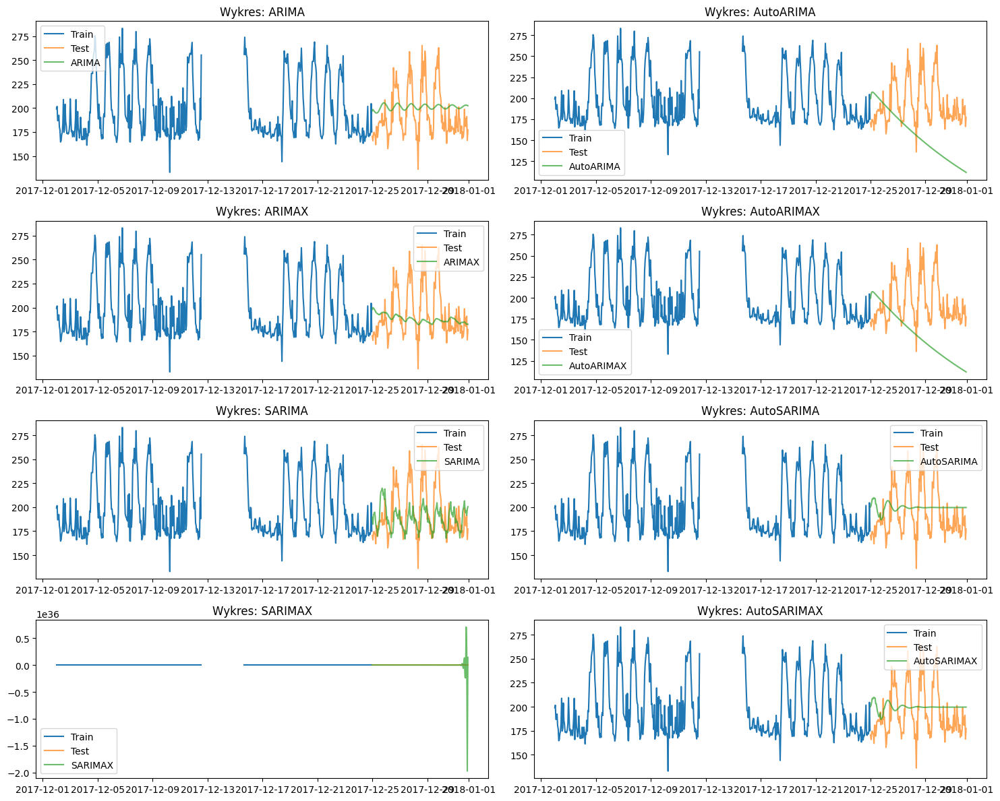


Metryki efektywności:
                     RMSE           MAE          MAPE  Czas treningu  \
Model                                                                  
SARIMA       2.446495e+01  1.837202e+01  8.918068e-02      74.276353   
ARIMA        2.537525e+01  2.245977e+01  1.165792e-01      26.160638   
ARIMAX       2.670880e+01  2.014440e+01  9.771283e-02       0.000000   
AutoSARIMA   2.742372e+01  2.367667e+01  1.223492e-01       0.000000   
AutoSARIMAX  2.742372e+01  2.367667e+01  1.223492e-01       0.000000   
AutoARIMA    5.477855e+01  4.663100e+01  2.316751e-01       0.000000   
AutoARIMAX   5.477855e+01  4.663100e+01  2.316751e-01       0.000000   
SARIMAX      1.661996e+35  2.326788e+34  1.336382e+32       0.000000   

             Czas predykcji  
Model                        
SARIMA            27.934449  
ARIMA              0.784464  
ARIMAX             0.844008  
AutoSARIMA       347.769748  
AutoSARIMAX      349.245656  
AutoARIMA          4.466275  
AutoARIMAX      

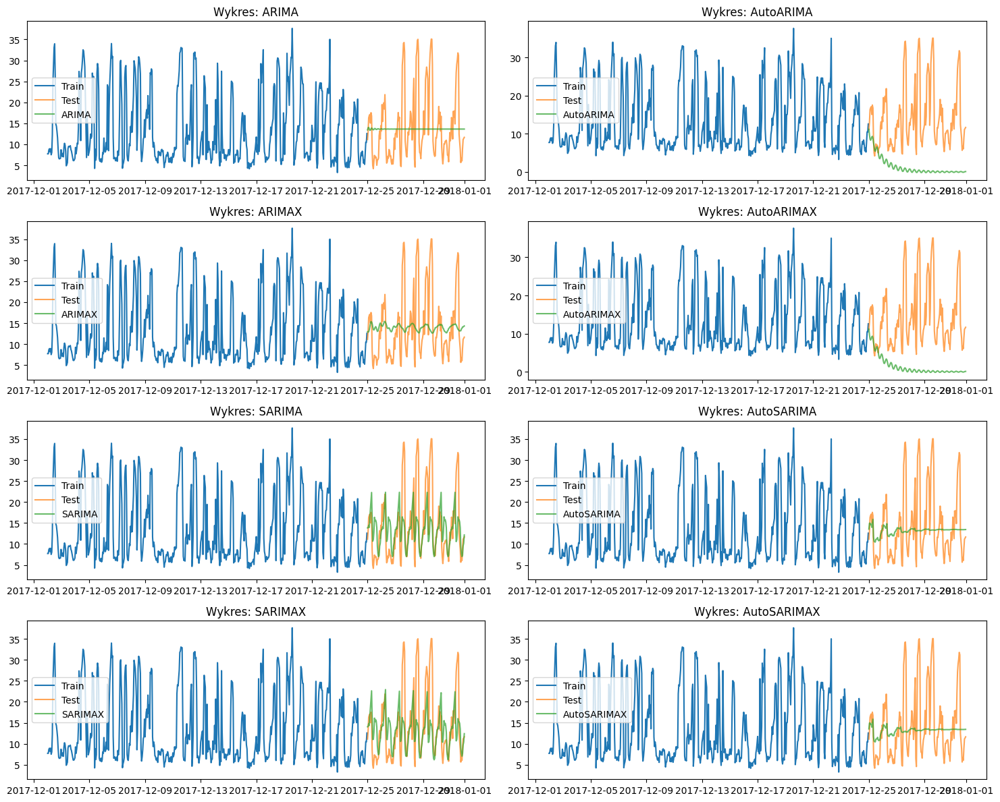


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
SARIMA        7.278682   5.062996  0.378483      95.930699       11.974635
SARIMAX       7.444853   5.123849  0.379484       0.000000       12.717469
AutoSARIMA    8.058699   5.832135  0.458614       0.000000      260.568940
AutoSARIMAX   8.058699   5.832135  0.458614       0.000000      256.379349
ARIMAX        8.246613   6.149000  0.522921       0.000000        0.899620
ARIMA         8.249188   6.259353  0.525131      12.006300        0.465440
AutoARIMA    15.804745  13.107004  0.868543       0.000000        5.240350
AutoARIMAX   15.804745  13.107004  0.868543       0.000000        5.027802


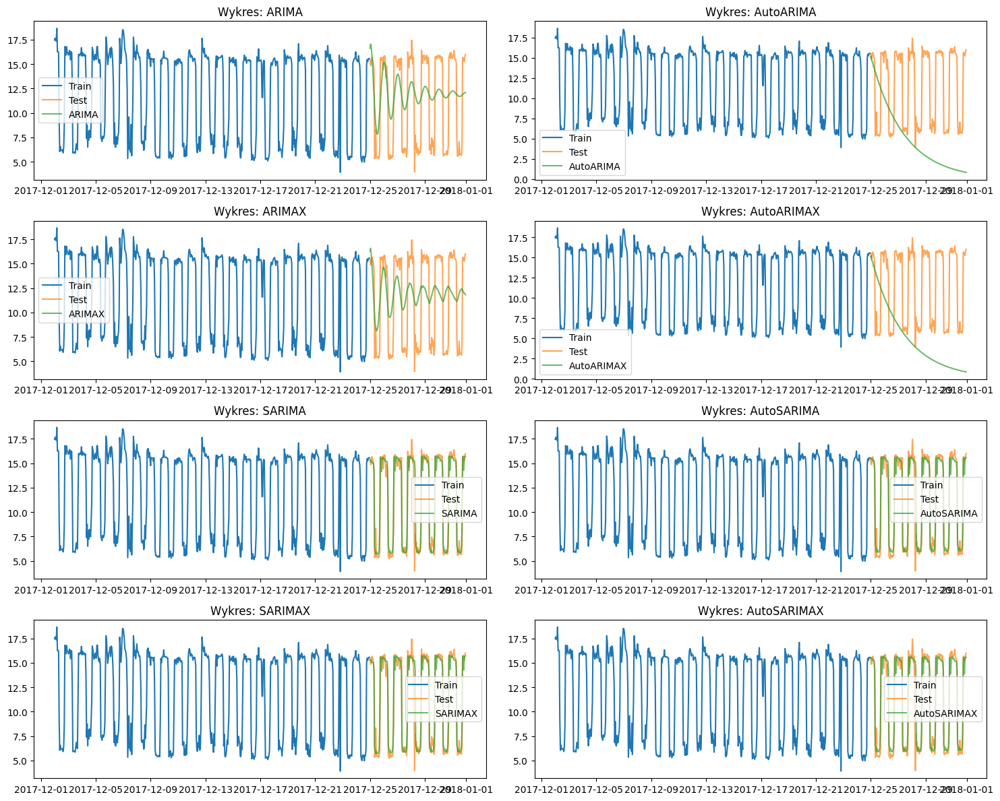


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMA       1.262487  0.630913  0.081648      51.777992        6.830730
SARIMAX      1.263425  0.630229  0.082214       0.000000        7.894265
AutoSARIMA   1.271446  0.676107  0.085962       0.000000      317.744894
AutoSARIMAX  1.271446  0.676107  0.085962       0.000000      318.533657
ARIMA        3.962976  3.655189  0.453093      27.331481        0.639598
ARIMAX       4.168478  3.873500  0.476623       0.000000        0.856291
AutoARIMA    8.908752  7.497813  0.645187       0.000000        3.714324
AutoARIMAX   8.908752  7.497813  0.645187       0.000000        3.940448


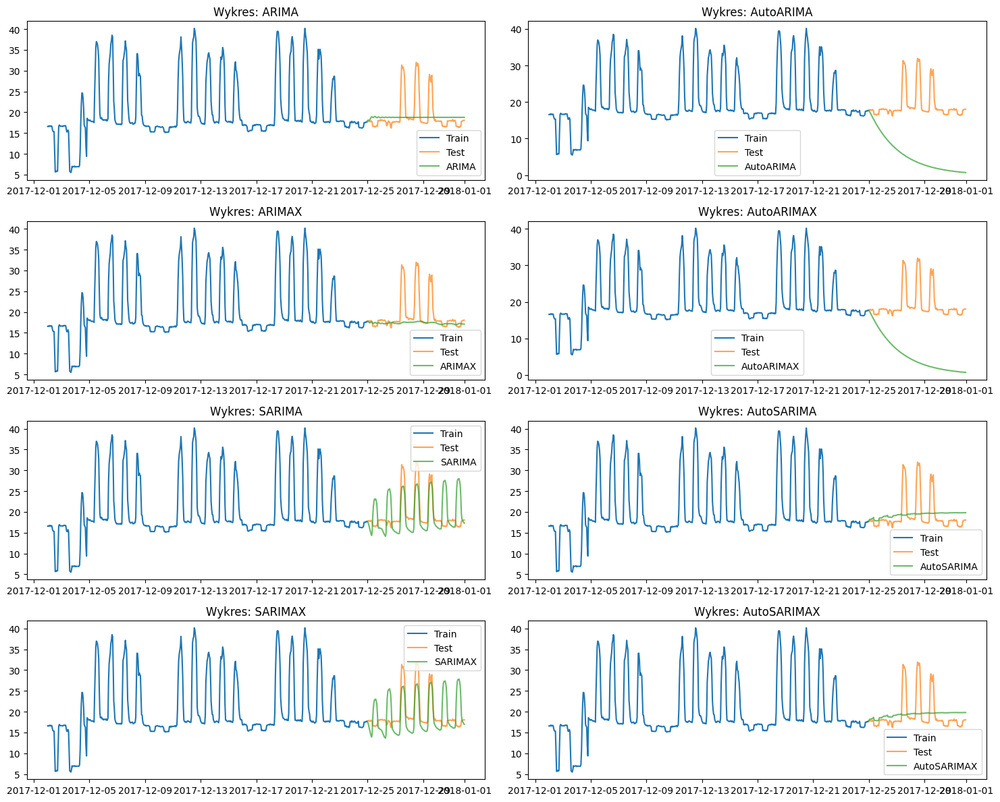


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    4.051497   2.775887  0.127888       0.000000      280.871633
AutoSARIMAX   4.051497   2.775887  0.127888       0.000000      283.311057
ARIMA         4.114041   2.453184  0.107400      21.645466        0.851146
SARIMA        4.364051   3.326179  0.181425      76.039806       47.358385
SARIMAX       4.404230   3.473864  0.189271       0.000000       47.823071
ARIMAX        4.436162   2.194487  0.087445       0.000000        0.998052
AutoARIMA    15.460041  13.977461  0.709862       0.000000        4.152882
AutoARIMAX   15.460041  13.977461  0.709862       0.000000        4.443385


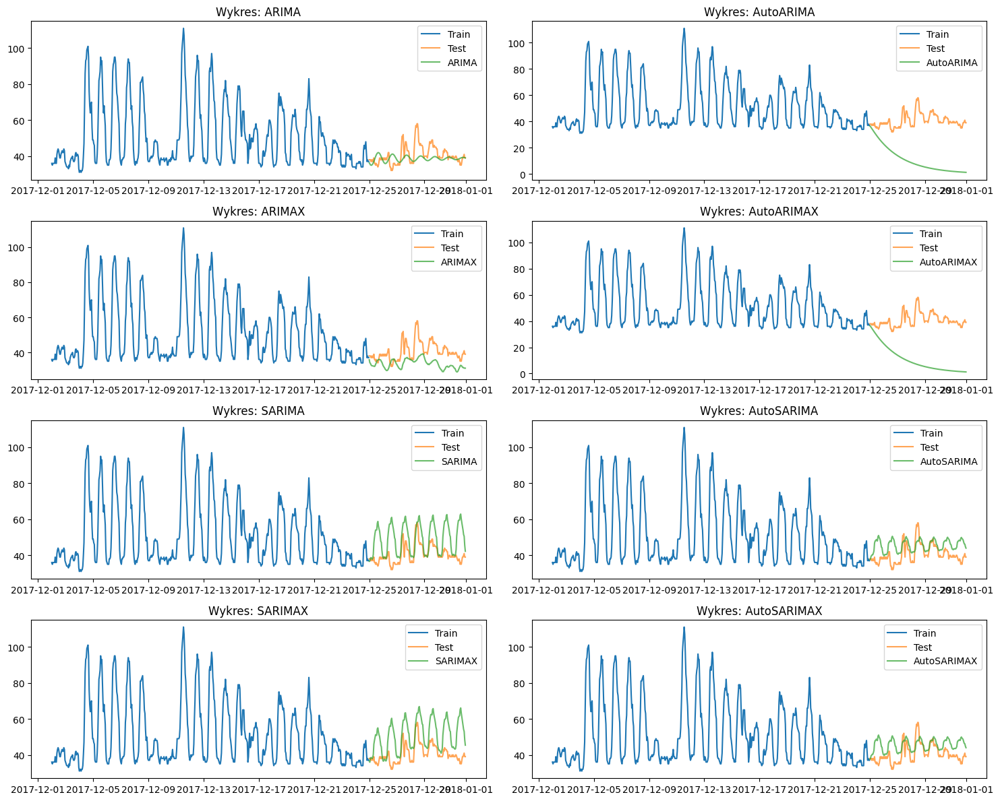


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         5.639042   4.023737  0.093612      21.055792        0.735179
AutoSARIMA    7.115168   5.776694  0.150600       0.000000      266.583937
AutoSARIMAX   7.115168   5.776694  0.150600       0.000000      265.262577
ARIMAX        8.676594   7.252616  0.169663       0.000000        0.963137
SARIMA       11.807942   8.911407  0.228875      40.975403       10.606886
SARIMAX      12.792844  10.461036  0.264793       0.000000       13.372932
AutoARIMA    32.442892  30.001131  0.725257       0.000000        4.978398
AutoARIMAX   32.442892  30.001131  0.725257       0.000000        5.004543


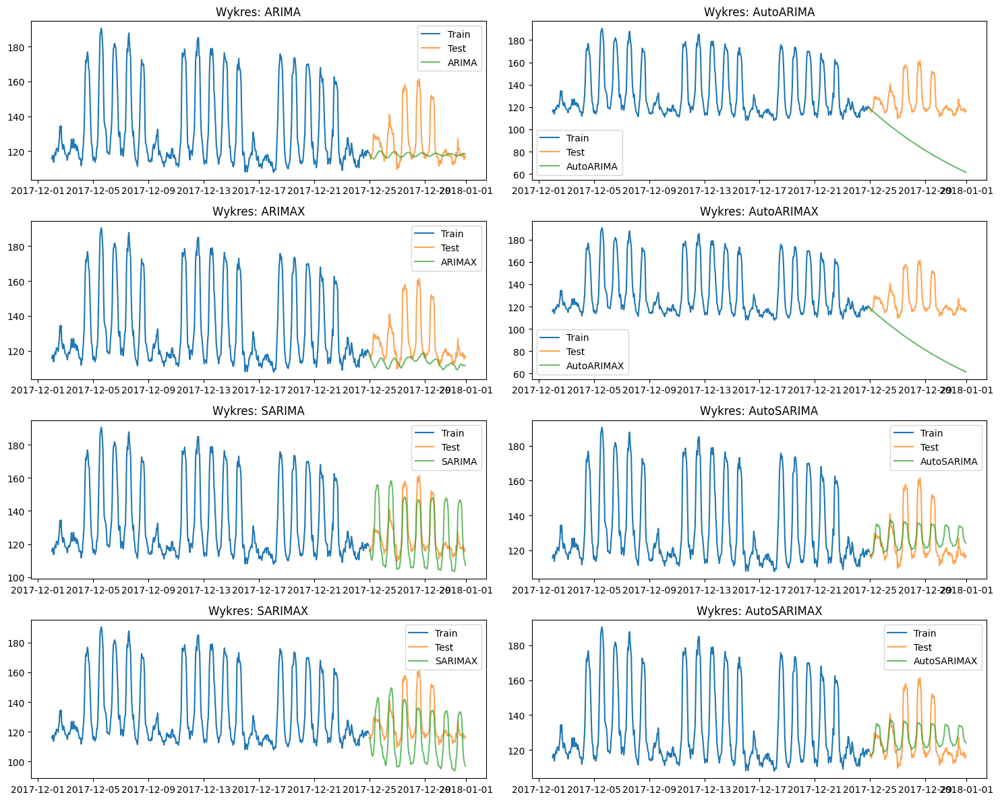


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    9.937988   7.973653  0.062002       0.000000      341.095812
AutoSARIMAX   9.937988   7.973653  0.062002       0.000000      340.897061
SARIMA       12.760085  10.340587  0.083185      79.361666       37.730054
ARIMA        14.849074   8.917259  0.063695      18.898435        0.767742
SARIMAX      15.087370  14.216514  0.114079       0.000000       40.559098
ARIMAX       17.374394  11.999363  0.087773       0.000000        1.083846
AutoARIMA    42.930496  38.269657  0.301315       0.000000        4.703812
AutoARIMAX   42.930496  38.269657  0.301315       0.000000        4.458987


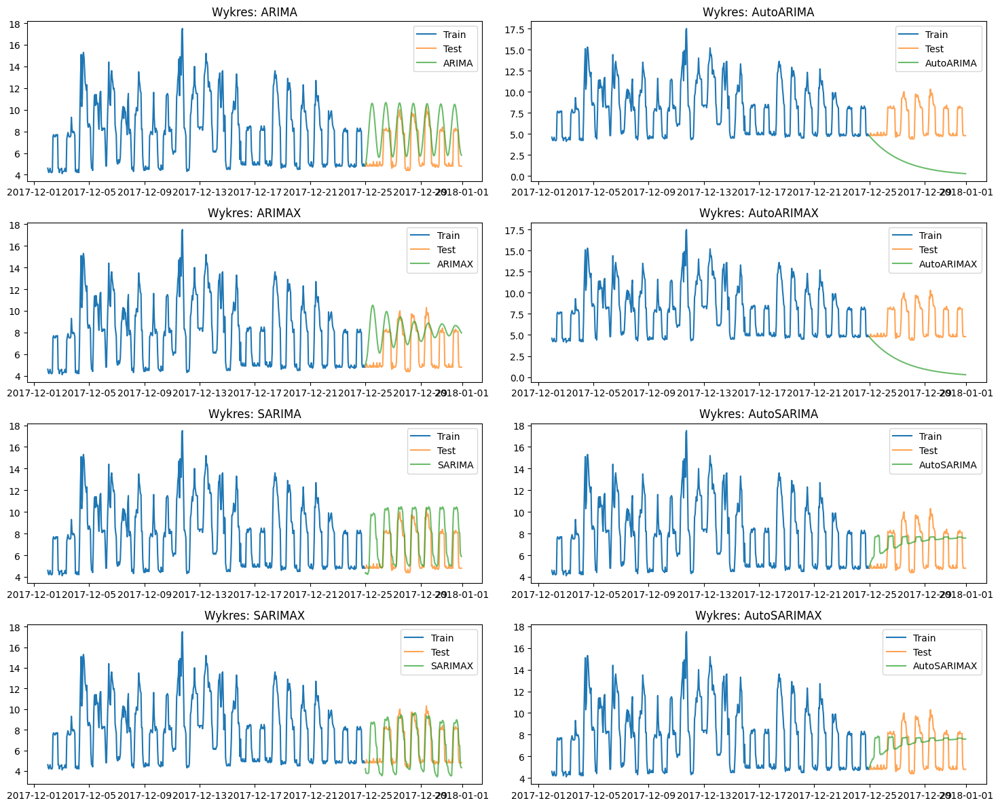


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      1.270623  0.965379  0.171701       0.000000       45.960789
SARIMA       1.830964  1.355556  0.230718      88.617490       55.516245
AutoSARIMA   1.921056  1.678790  0.309168       0.000000      280.194170
AutoSARIMAX  1.921056  1.678790  0.309168       0.000000      278.253202
ARIMA        2.226000  1.808456  0.330315      17.811375        1.103292
ARIMAX       2.329636  1.895224  0.366687       0.000000        1.013083
AutoARIMA    5.402989  4.813549  0.720022       0.000000        3.720119
AutoARIMAX   5.402989  4.813549  0.720022       0.000000        3.780861


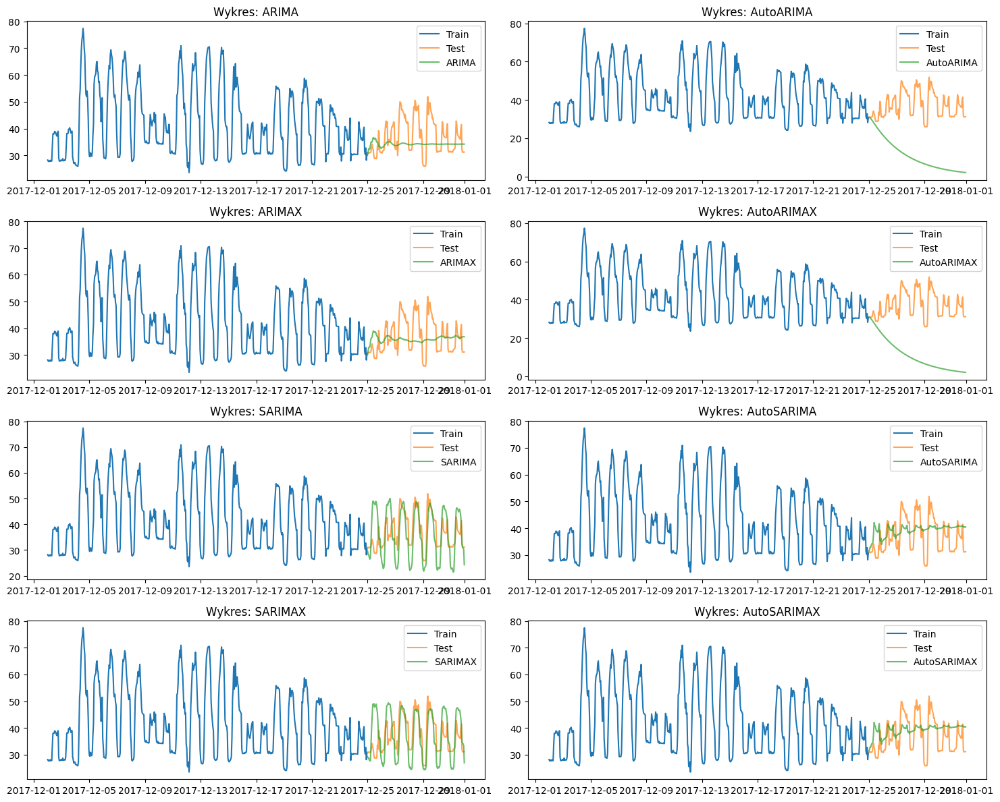


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA    6.545835   5.660294  0.163358       0.000000      300.539059
AutoSARIMAX   6.545835   5.660294  0.163358       0.000000      301.827916
ARIMAX        6.793933   5.669291  0.150307       0.000000        1.074919
ARIMA         7.150299   5.659459  0.142850      20.804940        0.779655
SARIMAX       7.230042   5.761604  0.164510       0.000000       55.050659
SARIMA        7.721008   6.281395  0.180400      89.749542       59.778899
AutoARIMA    28.649939  26.191270  0.688237       0.000000        4.308728
AutoARIMAX   28.649939  26.191270  0.688237       0.000000        4.441381


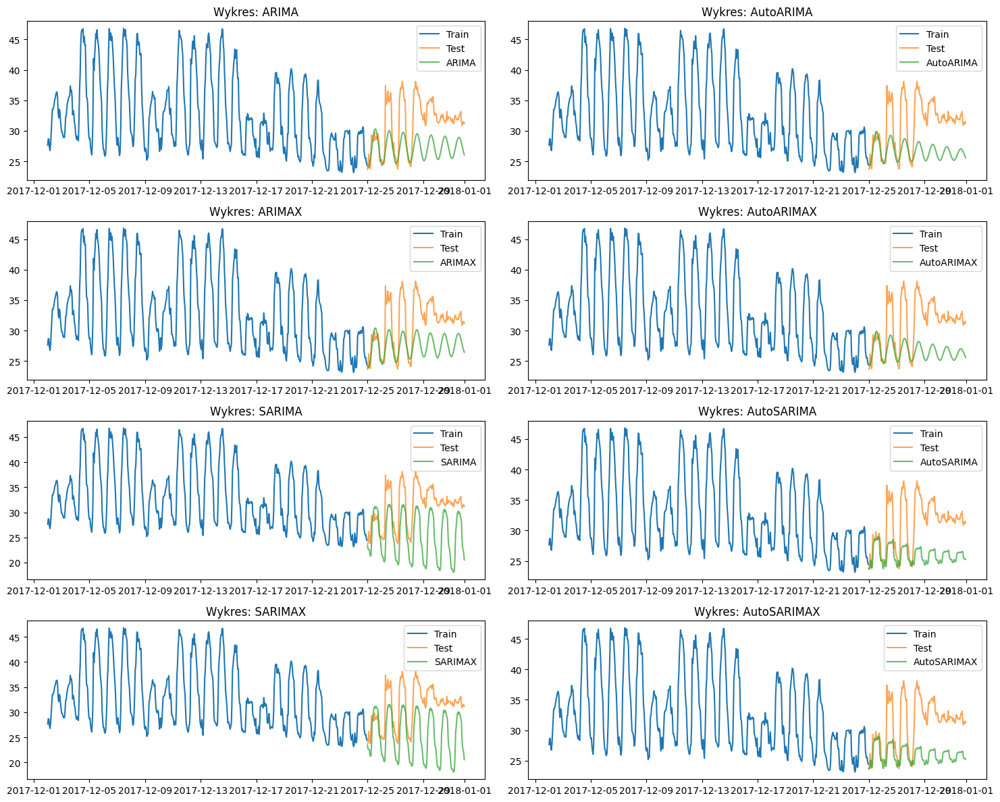


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
ARIMAX       4.695809  3.967503  0.119855       0.000000        1.095443
ARIMA        4.991213  4.218441  0.127225      19.702110        0.713593
AutoARIMA    5.656172  4.805467  0.144721       0.000000        5.074423
AutoARIMAX   5.656172  4.805467  0.144721       0.000000        5.078489
AutoSARIMA   6.173470  5.265600  0.158564       0.000000      213.990787
AutoSARIMAX  6.173470  5.265600  0.158564       0.000000      213.789626
SARIMA       6.970905  5.967198  0.188959      62.832253       44.366177
SARIMAX      6.992339  6.004714  0.190049       0.000000       41.951750


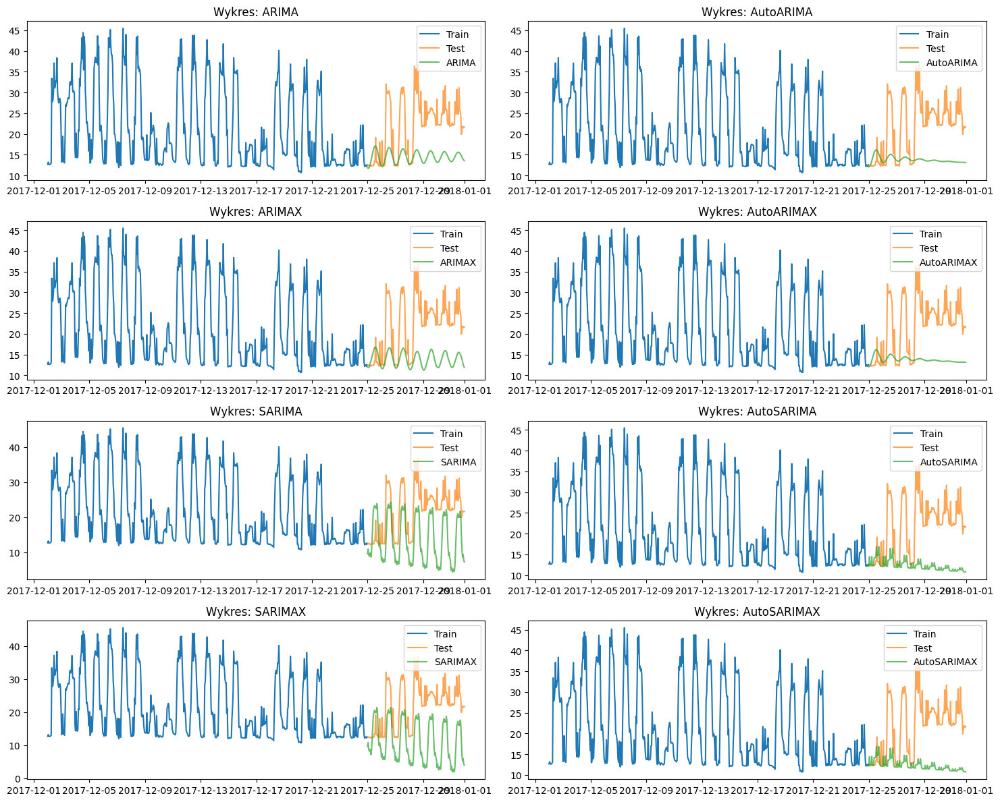


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         9.286660   7.727544  0.312791      19.982877        0.874201
ARIMAX        9.747698   8.174300  0.332329       0.000000        1.069472
SARIMA       10.245383   8.919040  0.419890      59.416946       38.792914
AutoARIMA    10.252752   8.503230  0.342828       0.000000        5.506376
AutoARIMAX   10.252752   8.503230  0.342828       0.000000        5.701801
AutoSARIMA   11.501954   9.602459  0.385982       0.000000      179.136066
AutoSARIMAX  11.501954   9.602459  0.385982       0.000000      172.664238
SARIMAX      12.463080  11.201030  0.519114       0.000000       40.872540


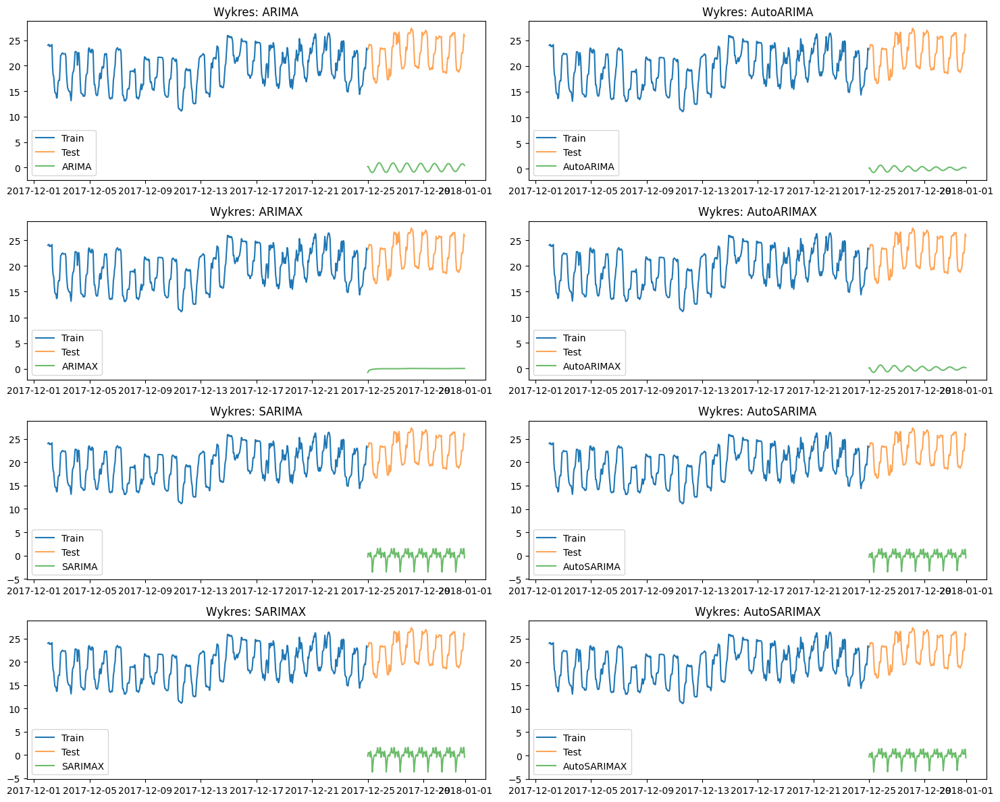


Metryki efektywności:
                 RMSE       MAE          MAPE  Czas treningu  Czas predykcji
Model                                                                       
SARIMA       0.702815  0.516648  2.623672e+13      113.78207        5.932638
AutoSARIMA   0.717516  0.523841  2.337259e+13        0.00000      188.302177
AutoSARIMAX  0.717516  0.523841  2.337259e+13        0.00000      187.477345
SARIMAX      0.728550  0.543415  2.930641e+13        0.00000       11.435457
ARIMA        0.935547  0.716616  3.250863e+13       23.25134        0.784335
AutoARIMA    1.010268  0.699906  1.202730e+13        0.00000        3.114438
AutoARIMAX   1.010268  0.699906  1.202730e+13        0.00000        3.178736
ARIMAX       1.175394  0.776378  3.008995e+12        0.00000        0.700913


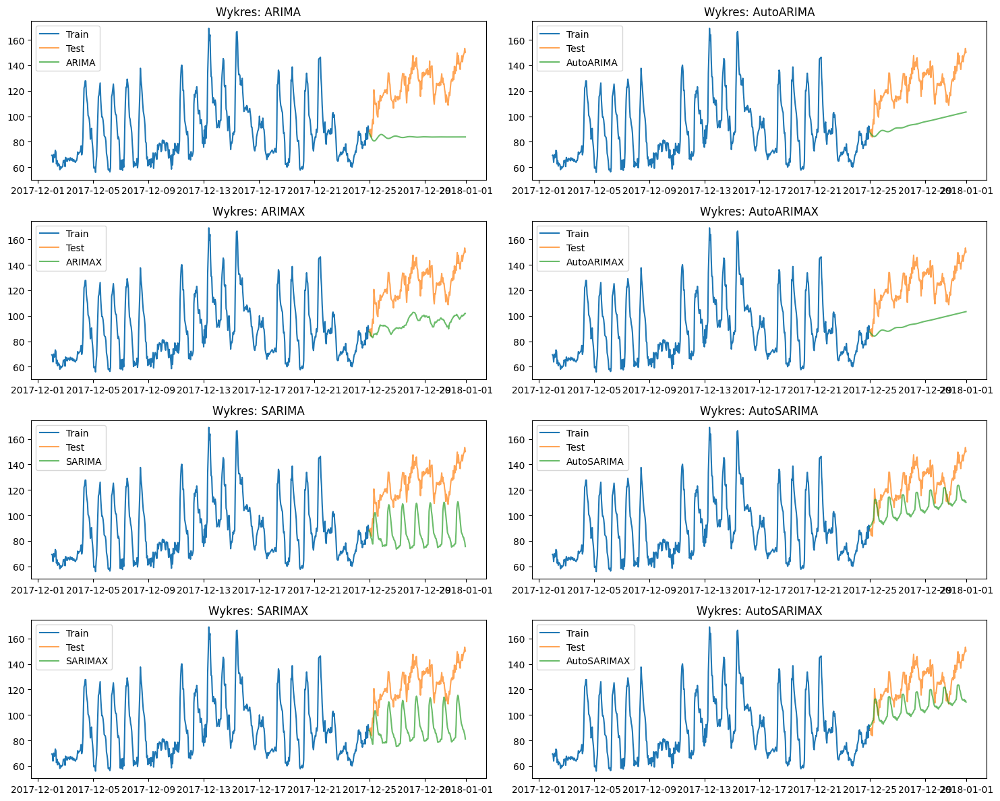


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
AutoSARIMA   20.806156  18.333391  0.142129       0.000000      176.840926
AutoSARIMAX  20.806156  18.333391  0.142129       0.000000      175.704849
ARIMAX       31.777704  30.138484  0.235934       0.000000        0.639632
AutoARIMA    32.247543  30.286296  0.236536       0.000000        5.952859
AutoARIMAX   32.247543  30.286296  0.236536       0.000000        5.997437
SARIMAX      37.386515  34.222348  0.268391       0.000000       26.262470
SARIMA       40.963500  37.674969  0.295283      70.711198       25.873773
ARIMA        43.080360  40.809957  0.318781       5.402409        0.476307


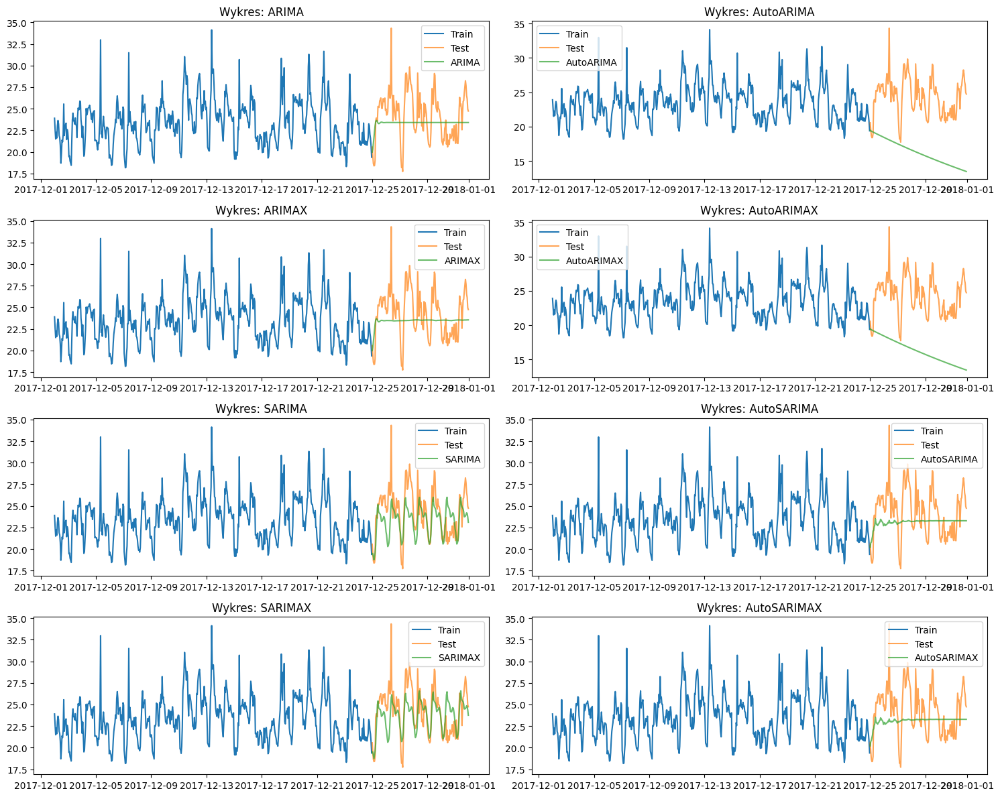


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      2.268818  1.714330  0.069397       0.000000       10.615489
SARIMA       2.418633  1.862881  0.074441      79.530034        9.795233
ARIMAX       2.757902  2.253630  0.091895       0.000000        0.752459
ARIMA        2.785161  2.271367  0.092327       9.717254        0.758606
AutoSARIMA   2.862277  2.364006  0.095341       0.000000      355.010742
AutoSARIMAX  2.862277  2.364006  0.095341       0.000000      358.489846
AutoARIMA    8.582543  8.039745  0.323524       0.000000        3.633680
AutoARIMAX   8.582543  8.039745  0.323524       0.000000        3.687593


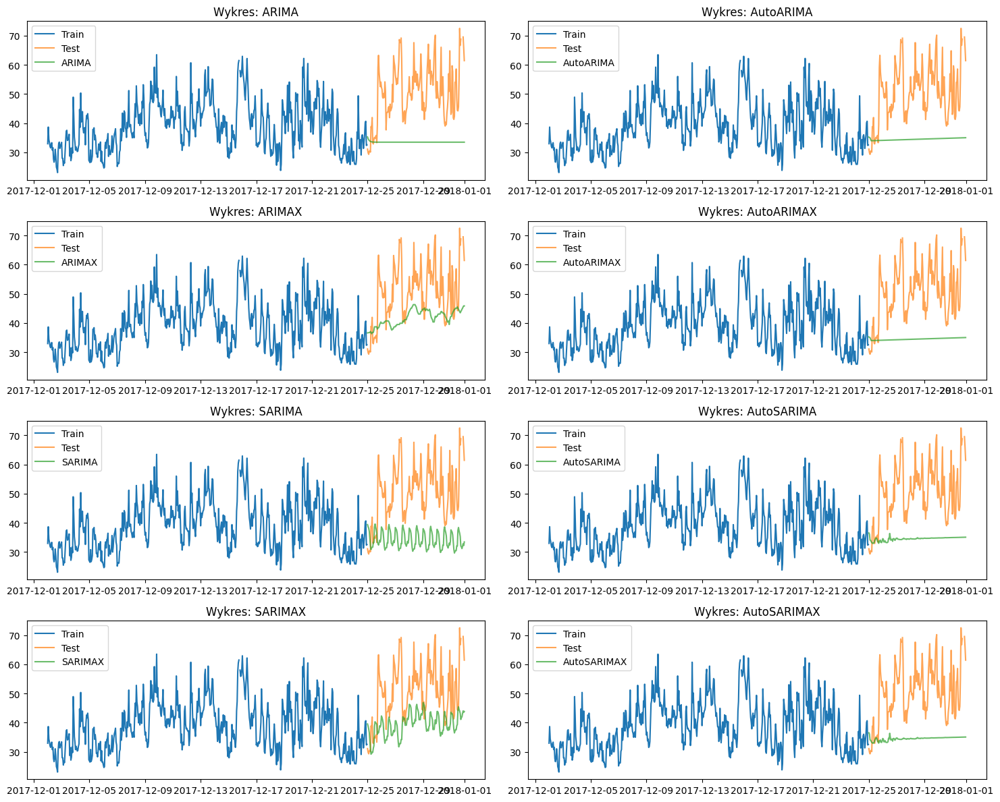


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMAX       12.092458   9.596529  0.175778       0.000000        0.149332
SARIMAX      13.967030  11.318530  0.206292       0.000000        3.058191
AutoSARIMA   18.246874  15.879944  0.293202       0.000000      192.410865
AutoSARIMAX  18.246874  15.879944  0.293202       0.000000      188.592292
AutoARIMA    18.305363  15.964355  0.295237       0.000000        5.873924
AutoARIMAX   18.305363  15.964355  0.295237       0.000000        5.985203
SARIMA       18.739868  16.345189  0.303562      42.882507        2.018174
ARIMA        19.228283  16.897714  0.313295       1.121368        0.090453


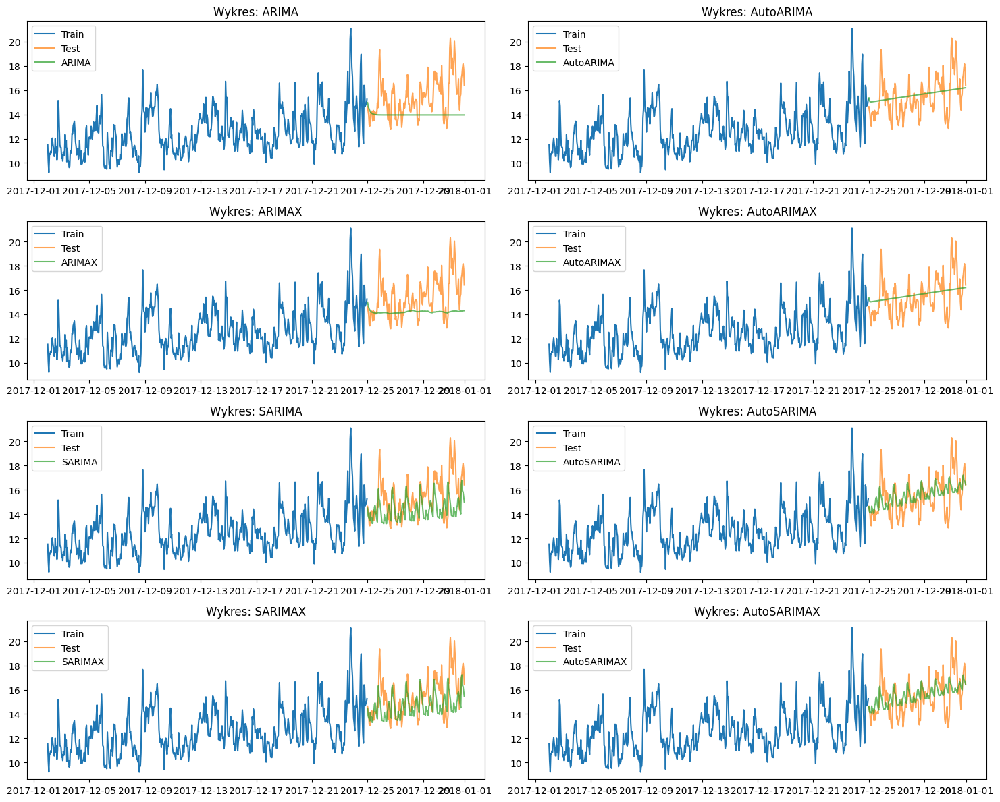


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
AutoSARIMA   1.461044  1.127385  0.073153       0.000000      217.946880
AutoSARIMAX  1.461044  1.127385  0.073153       0.000000      229.638579
AutoARIMA    1.489356  1.203613  0.078511       0.000000        8.129684
AutoARIMAX   1.489356  1.203613  0.078511       0.000000        9.100831
SARIMAX      1.765053  1.317280  0.081613       0.000000        5.455041
SARIMA       1.911339  1.431231  0.087954     107.041376        4.639508
ARIMAX       2.014519  1.531844  0.092814       0.000000        0.189676
ARIMA        2.184825  1.687538  0.102188       1.482074        0.118727


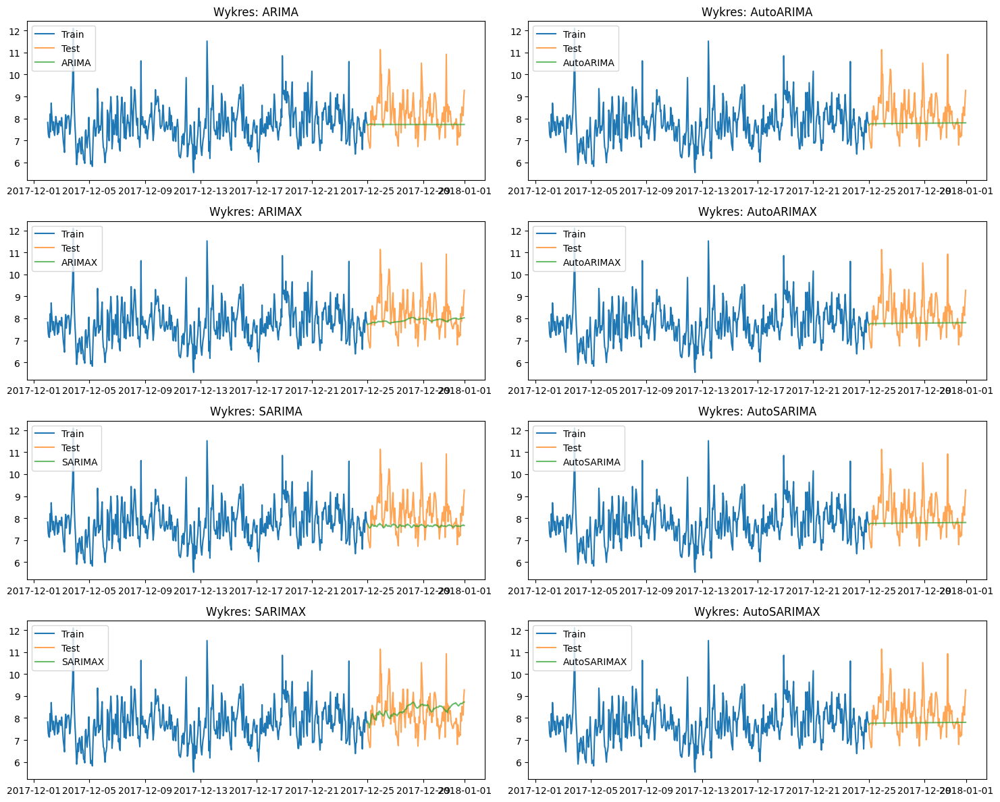


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
SARIMAX      0.835397  0.650059  0.079976       0.000000        5.827264
ARIMAX       0.845343  0.620354  0.072734       0.000000        0.946007
AutoARIMA    0.891332  0.654083  0.075939       0.000000       14.019839
AutoSARIMA   0.891332  0.654083  0.075939       0.000000      333.382243
AutoARIMAX   0.891332  0.654083  0.075939       0.000000       11.689969
AutoSARIMAX  0.891332  0.654083  0.075939       0.000000      297.684186
ARIMA        0.916687  0.675779  0.078230       9.567586        0.564920
SARIMA       0.944027  0.705624  0.081378      26.268799        3.405782


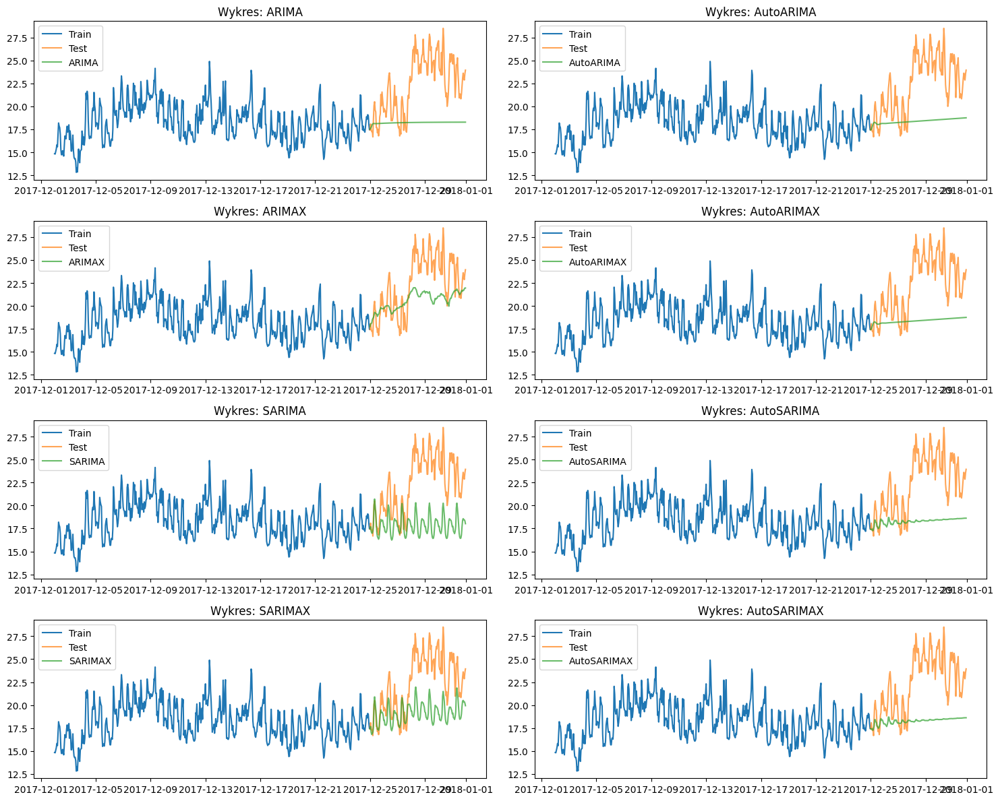


Metryki efektywności:
                 RMSE       MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                   
ARIMAX       2.993271  2.414384  0.102326       0.000000        1.103240
SARIMAX      4.070428  3.321827  0.138020       0.000000       20.042783
AutoARIMA    4.902014  4.104776  0.170900       0.000000        7.482171
AutoARIMAX   4.902014  4.104776  0.170900       0.000000        7.672107
AutoSARIMA   4.968835  4.141407  0.171997       0.000000      248.122547
AutoSARIMAX  4.968835  4.141407  0.171997       0.000000      243.170950
ARIMA        5.085183  4.270153  0.177854      14.915448        0.902275
SARIMA       5.270214  4.460500  0.186813      58.706059       43.350567


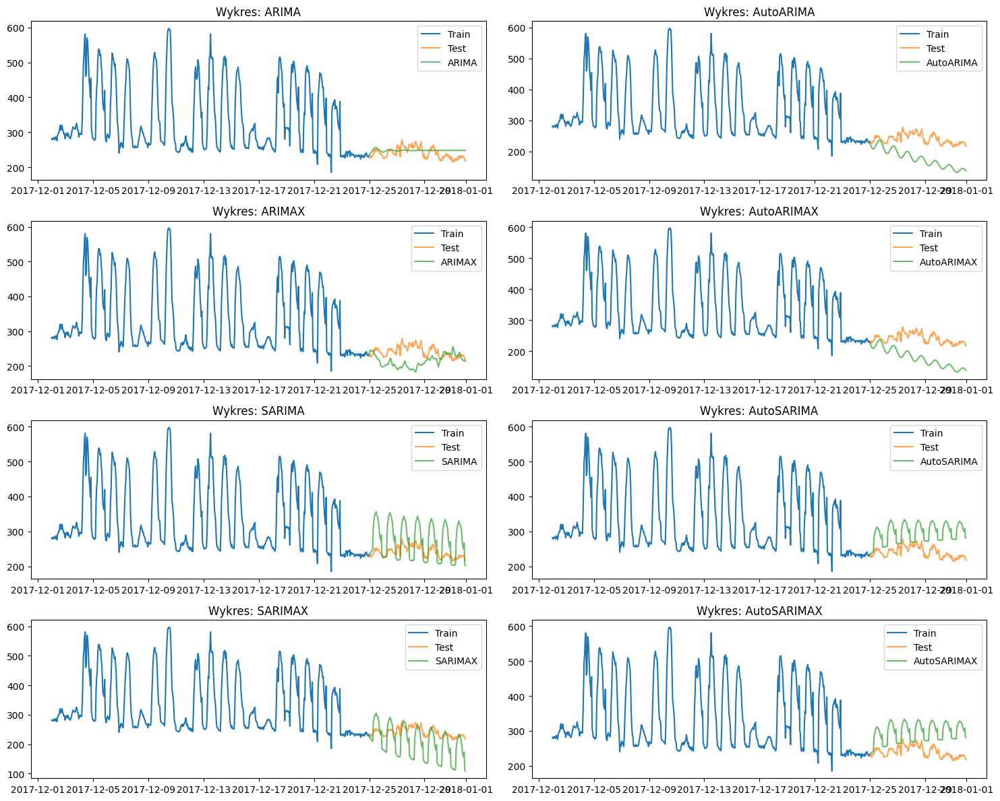


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA        16.285547  14.086065  0.059875      21.609411        0.837061
ARIMAX       38.587485  31.224016  0.125466       0.000000        1.099600
SARIMA       56.736484  47.023476  0.193429      64.244532       48.455712
SARIMAX      59.137807  46.729618  0.196650       0.000000       42.402139
AutoSARIMA   60.782960  55.238913  0.231828       0.000000      345.616049
AutoSARIMAX  60.782960  55.238913  0.231828       0.000000      344.169639
AutoARIMA    67.802375  62.322885  0.259003       0.000000        6.665273
AutoARIMAX   67.802375  62.322885  0.259003       0.000000        5.683524


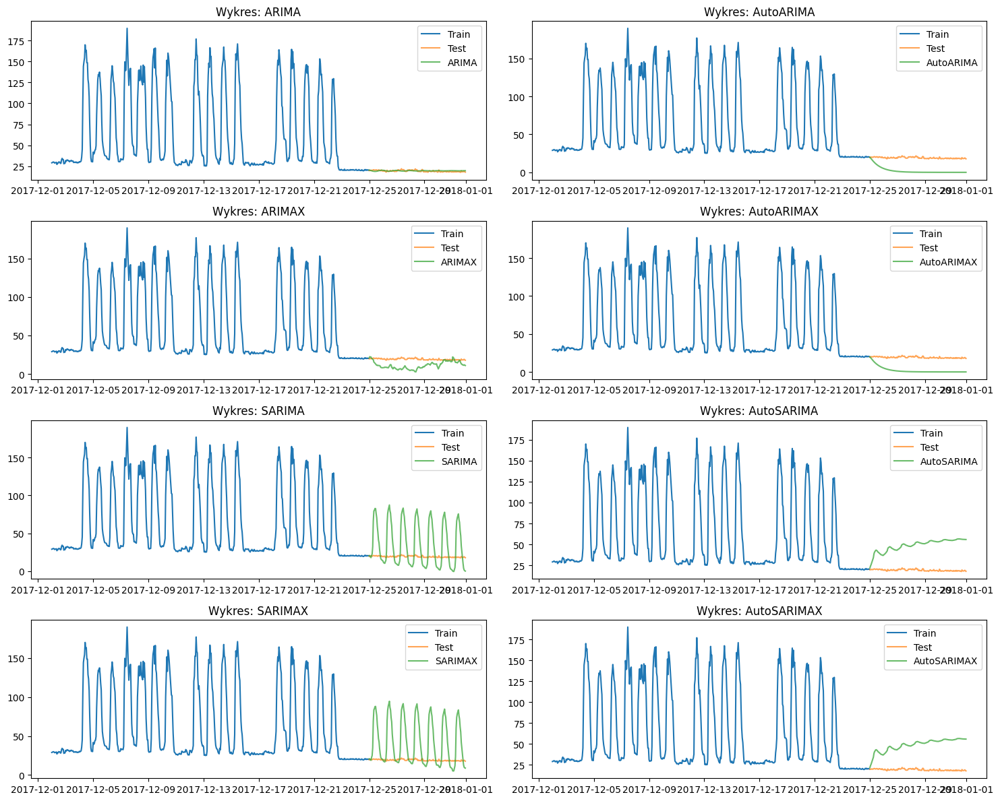


Metryki efektywności:
                  RMSE        MAE      MAPE  Czas treningu  Czas predykcji
Model                                                                     
ARIMA         1.054229   0.924513  0.048548      10.970470        0.817868
ARIMAX        9.393868   8.108658  0.417102       0.000000        1.059060
AutoARIMA    17.479003  17.026736  0.892619       0.000000        4.673721
AutoARIMAX   17.479003  17.026736  0.892619       0.000000        4.645818
AutoSARIMA   30.651911  29.708969  1.565523       0.000000      274.978006
AutoSARIMAX  30.651911  29.708969  1.565523       0.000000      277.477481
SARIMA       32.575124  25.236204  1.313897      52.622644       43.909803
SARIMAX      36.736812  26.616354  1.384980       0.000000       47.667064


In [25]:

for j in range(len(all_results)):
    fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(15, 12))
    axes = axes.flatten()  # Spłaszczenie do 1D listy osi

    for i, col in enumerate(all_results[j].columns[:8]):
        ax = axes[i]
        data = df_final[df_final['building_id'] == selected_buildings[j]].copy()
        data['timestamp'] = pd.to_datetime(data['timestamp'])
        data = data.set_index('timestamp').sort_index()
        data = data.asfreq('h')

        train = data['energy_consumption'][-720:-168]
        test = data['energy_consumption'][-168:]
        ax.plot(train.index, train, label='Train')
        ax.plot(test.index, test, label='Test', alpha=0.7)
        ax.plot(test.index, all_results[j][col], label=col, alpha=0.7)
        ax.set_title(f'Wykres: {col}')
        ax.legend()

    plt.tight_layout()
    plt.show()

    # 10. Podsumowanie metryk
    metrics_df = pd.DataFrame(all_metrics[j]).set_index('Model')
    print("\nMetryki efektywności:")
    print(metrics_df.sort_values('RMSE'))


In [15]:
df_list = []
for iteration in all_metrics:
    df_iter = pd.DataFrame(iteration)
    df_list.append(df_iter)

full_df = pd.concat(df_list, ignore_index=True)

results = full_df[full_df['RMSE'] <2000].groupby('Model').agg({
    'RMSE': 'mean',
    'MAE': 'mean',
    'MAPE': 'mean',
    'Czas treningu': 'mean',
    'Czas predykcji': 'mean'
}).reset_index()

results = results.sort_values('RMSE').reset_index(drop=True)

results['Ranking'] = results.index + 1

results['RMSE'] = results['RMSE'].round(4)
results['MAE'] = results['MAE'].round(4)
results['MAPE'] = results['MAPE'].round(6)
results['Czas treningu'] = results['Czas treningu'].apply(lambda x: f"{x:.3f} s" if pd.notnull(x) else "Brak")
results['Czas predykcji'] = results['Czas predykcji'].round(3).astype(str) + " s"

final_results = results[['Ranking', 'Model', 'RMSE', 'MAE', 'MAPE', 'Czas treningu', 'Czas predykcji']]

print("ŚREDNIE WYNIKI DLA WSZYSTKICH MODELI:")
print(final_results.to_string(index=False))

best_model = results.iloc[0]
worst_model = results.iloc[-1]

print("\nPODSUMOWANIE:")
print(f"Najlepszy model: {best_model['Model']}")
print(f"- Średnie RMSE: {best_model['RMSE']}")
print(f"- Średnie MAE: {best_model['MAE']}")
print(f"- Średnie MAPE: {best_model['MAPE']}")
print(f"\nNajgorszy model: {worst_model['Model']}")
print(f"- Średnie RMSE: {worst_model['RMSE']}")
print(f"- Średnie MAE: {worst_model['MAE']}")
print(f"- Średnie MAPE: {worst_model['MAPE']}")

ŚREDNIE WYNIKI DLA WSZYSTKICH MODELI:
 Ranking       Model    RMSE     MAE         MAPE Czas treningu Czas predykcji
       1       ARIMA  9.7472  8.1752 1.625431e+12      20.134 s        0.796 s
       2      ARIMAX 10.6571  8.6685 1.504497e+11       0.000 s        1.176 s
       3  AutoSARIMA 12.3325 10.7067 1.168630e+12       0.000 s      307.724 s
       4 AutoSARIMAX 12.3325 10.7067 1.168630e+12       0.000 s      303.367 s
       5     SARIMAX 12.6834 10.3181 1.542443e+12       0.000 s       29.414 s
       6      SARIMA 13.1652 10.7837 1.311836e+12      78.865 s       30.256 s
       7   AutoARIMA 25.9412 23.5782 6.013648e+11       0.000 s         6.36 s
       8  AutoARIMAX 25.9412 23.5782 6.013648e+11       0.000 s        6.331 s

PODSUMOWANIE:
Najlepszy model: ARIMA
- Średnie RMSE: 9.7472
- Średnie MAE: 8.1752
- Średnie MAPE: 1625431284025.3467

Najgorszy model: AutoARIMAX
- Średnie RMSE: 25.9412
- Średnie MAE: 23.5782
- Średnie MAPE: 601364792461.5415
